# Metabolic Syndrome Prediction | 1. Dataset Exploration

-> Load the dataset

-> Explore and confirm features and label(s) of this dataset

-> Explore size/shape of dataset

-> Investigate data type of features and labels and chose any better option for a 
particular column for data type if possible

-> Calculate the memory usage differences

-> Explore the statistical facts like mean, median, x percentiles of the columns

## 1. Load the dataset

In [1]:
import pandas as pd
import numpy as np
import warnings

warnings.filterwarnings("ignore")

df = pd.read_csv("Metabolic Syndrome.csv") # reading in the csv file using pandas, similar implementation cn be done for polars (lazy reading)

---

## 2. Explore and confirm features and label(s) of this dataset

In [2]:
df # displaying the dataset

,seqn,Age,Sex,Marital,Income,Race,WaistCirc,BMI,Albuminuria,UrAlbCr,UricAcid,BloodGlucose,HDL,Triglycerides,MetabolicSyndrome
0,62161,22,Male,Single,8200.0,White,81.0,23.3,0,3.88,4.9,92,41,84,0
1,62164,44,Female,Married,4500.0,White,80.1,23.2,0,8.55,4.5,82,28,56,0
2,62169,21,Male,Single,800.0,Asian,69.6,20.1,0,5.07,5.4,107,43,78,0
3,62172,43,Female,Single,2000.0,Black,120.4,33.3,0,5.22,5.0,104,73,141,0
4,62177,51,Male,Married,NaN,Asian,81.1,20.1,0,8.13,5.0,95,43,126,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2396,71901,48,Female,Married,1000.0,Other,NaN,59.7,0,22.11,5.8,152,57,107,0
2397,71904,30,Female,Single,2000.0,Asian,NaN,18.0,0,2.90,7.9,91,90,91,0
2398,71909,28,Male,Single,800.0,MexAmerican,100.8,29.4,0,2.78,6.2,99,47,84,0
2399,71911,27,Male,Married,8200.0,MexAmerican,106.6,31.3,0,4.15,6.2,100,41,124,1


In [3]:
df.columns # displaying column names/features

Index(['seqn', 'Age', 'Sex', 'Marital', 'Income', 'Race', 'WaistCirc', 'BMI',
       'Albuminuria', 'UrAlbCr', 'UricAcid', 'BloodGlucose', 'HDL',
       'Triglycerides', 'MetabolicSyndrome'],
      dtype='object')

In [4]:
df.head() # displaying first 5 rows

,seqn,Age,Sex,Marital,Income,Race,WaistCirc,BMI,Albuminuria,UrAlbCr,UricAcid,BloodGlucose,HDL,Triglycerides,MetabolicSyndrome
0,62161,22,Male,Single,8200.0,White,81.0,23.3,0,3.88,4.9,92,41,84,0
1,62164,44,Female,Married,4500.0,White,80.1,23.2,0,8.55,4.5,82,28,56,0
2,62169,21,Male,Single,800.0,Asian,69.6,20.1,0,5.07,5.4,107,43,78,0
3,62172,43,Female,Single,2000.0,Black,120.4,33.3,0,5.22,5.0,104,73,141,0
4,62177,51,Male,Married,NaN,Asian,81.1,20.1,0,8.13,5.0,95,43,126,0


In [5]:
df.tail() # displaying last 5 rows

,seqn,Age,Sex,Marital,Income,Race,WaistCirc,BMI,Albuminuria,UrAlbCr,UricAcid,BloodGlucose,HDL,Triglycerides,MetabolicSyndrome
2396,71901,48,Female,Married,1000.0,Other,NaN,59.7,0,22.11,5.8,152,57,107,0
2397,71904,30,Female,Single,2000.0,Asian,NaN,18.0,0,2.90,7.9,91,90,91,0
2398,71909,28,Male,Single,800.0,MexAmerican,100.8,29.4,0,2.78,6.2,99,47,84,0
2399,71911,27,Male,Married,8200.0,MexAmerican,106.6,31.3,0,4.15,6.2,100,41,124,1
2400,71915,60,Male,Single,6200.0,White,106.6,27.5,0,12.82,5.2,91,36,226,1


---

## 3. Explore size/shape of dataset

In [6]:
df.shape # displaying shape of the dataset

(2401, 15)

---

## 4. Investigate data type of features and labels and chose any better option for a particular column for data type if possible

In [7]:
df.info() # displays information about the dataset, with respective datatypes for each column

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2401 entries, 0 to 2400
Data columns (total 15 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   seqn               2401 non-null   int64  
 1   Age                2401 non-null   int64  
 2   Sex                2401 non-null   object 
 3   Marital            2193 non-null   object 
 4   Income             2284 non-null   float64
 5   Race               2401 non-null   object 
 6   WaistCirc          2316 non-null   float64
 7   BMI                2375 non-null   float64
 8   Albuminuria        2401 non-null   int64  
 9   UrAlbCr            2401 non-null   float64
 10  UricAcid           2401 non-null   float64
 11  BloodGlucose       2401 non-null   int64  
 12  HDL                2401 non-null   int64  
 13  Triglycerides      2401 non-null   int64  
 14  MetabolicSyndrome  2401 non-null   int64  
dtypes: float64(5), int64(7), object(3)
memory usage: 281.5+ KB


From above list we see datatypes include float, int and object. ML models require data to be numerical, so we would have to convert datatype object into float/int to proceed further in the ML pipeline.

Identified columns that need above change: with corresponding encoding techniques

-> Sex : binary encoding : one-hot or label encoder

-> Marital : multi-value encoding : label or ordinal encoder

-> Race : multi-value encoding : label encoder

In [8]:
set(df['Sex']) # unique values to be encoded in Sex

{'Female', 'Male'}

In [9]:
set(df['Marital']) # unique values to be encoded in Marital status

{'Divorced', 'Married', 'Separated', 'Single', 'Widowed', nan}

In [10]:
set(df['Race']) # unique values to be encoded in Race

{'Asian', 'Black', 'Hispanic', 'MexAmerican', 'Other', 'White'}

---

# 5. Calculate the memory usage differences

### pandas

In [11]:
print("Pandas Memory Usage:", df.memory_usage().sum(), 'Bytes')

Pandas Memory Usage: 288248 Bytes


In [12]:
print("Pandas Deep Memory Usage:", df.memory_usage(deep=True).sum(), 'Bytes')

Pandas Deep Memory Usage: 677600 Bytes


### polars

In [13]:
import polars as pl

df1 = pl.read_csv('Metabolic Syndrome.csv')

print("Polars Memory Usage:", df1.estimated_size('kb') , 'KB')

del df1 # deleting polars implementation since pandas implementation is not memory-intensive

Polars Memory Usage: 266.537109375 KB


## memory usage for dataset

### pandas

memory usage: 661.7 KB

lazy read memory usage: 282 KB

### polars

lazy read memory usage: 267 KB

---

## 6. Explore the statistical facts like mean, median, x percentiles of the columns

In [14]:
df.describe(percentiles=[0.1,0.25,0.5,0.75,0.99]) # describes numerical interpretations of the dataset in terms of mean, max, min, quartiles, etc.

# percentiles considered: 10, 25, 50, 75, 99

,seqn,Age,Income,WaistCirc,BMI,Albuminuria,UrAlbCr,UricAcid,BloodGlucose,HDL,Triglycerides,MetabolicSyndrome
count,2401.000000,2401.000000,2284.000000,2316.000000,2375.000000,2401.000000,2401.000000,2401.000000,2401.000000,2401.000000,2401.000000,2401.000000
mean,67030.674302,48.691795,4005.253940,98.307254,28.702189,0.154102,43.626131,5.489046,108.247813,53.369429,128.125364,0.342357
std,2823.565114,17.632852,2954.032186,16.252634,6.662242,0.422780,258.272829,1.439358,34.820657,15.185537,95.322477,0.474597
min,62161.000000,20.000000,300.000000,56.200000,13.400000,0.000000,1.400000,1.800000,39.000000,14.000000,26.000000,0.000000
10%,63133.000000,25.000000,1000.000000,78.600000,21.400000,0.000000,3.220000,3.700000,86.000000,36.000000,56.000000,0.000000
25%,64591.000000,34.000000,1600.000000,86.675000,24.000000,0.000000,4.450000,4.500000,92.000000,43.000000,75.000000,0.000000
50%,67059.000000,48.000000,2500.000000,97.000000,27.700000,0.000000,7.070000,5.400000,99.000000,51.000000,103.000000,0.000000
75%,69495.000000,63.000000,6200.000000,107.625000,32.100000,0.000000,13.690000,6.400000,110.000000,62.000000,150.000000,1.000000
99%,71830.000000,80.000000,9000.000000,145.165000,49.200000,2.000000,806.580000,9.400000,278.000000,97.000000,511.000000,1.000000
max,71915.000000,80.000000,9000.000000,176.000000,68.700000,2.000000,5928.000000,11.300000,382.000000,156.000000,1562.000000,1.000000


only for numerical data*

---

## 7. Finding NULL/NaN count for imputation

In [15]:
df.isnull().sum() # counting null values and summing them for each column

seqn                   0
Age                    0
Sex                    0
Marital              208
Income               117
Race                   0
WaistCirc             85
BMI                   26
Albuminuria            0
UrAlbCr                0
UricAcid               0
BloodGlucose           0
HDL                    0
Triglycerides          0
MetabolicSyndrome      0
dtype: int64

in addition to encoding we would also need imputation on the following columns since these hold null/NaN values which cannot be sent into a ML model:

-> Marital

-> Income

-> WaistCirc

-> BMI

of the above null values we would have to check if the columns are disjoint from others or dependent on another column(s) :

for example, income could be evaluated to depend on Sex and Marital status, or BMI being dependent on Sex, and hence keeping in mind these dependencies we would have to encode values.

---

# Metabolic Syndrome Prediction | 2. EDA

-> Perform Univariate and Multivariate analysis and draw conclusions from there.

-> Explore Correlation Matrix(can try different methods and search if they give the same conclusion and why)

-> Check the distribution(skewness) of the columns

-> Detect Outliers(don't remove)

-> Detect Class Label Imbalance

## 1. Perform Univariate and Multivariate analysis and draw conclusions from there.

In [16]:
import seaborn as sns

<Axes: xlabel='Age', ylabel='Count'>

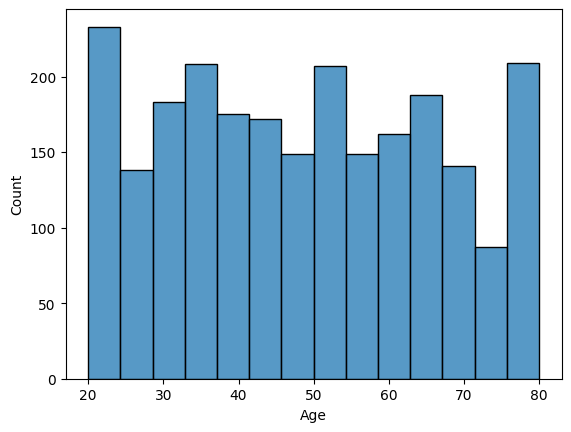

In [17]:
sns.histplot(df['Age']) # histogram plot for Age-count

<Axes: >

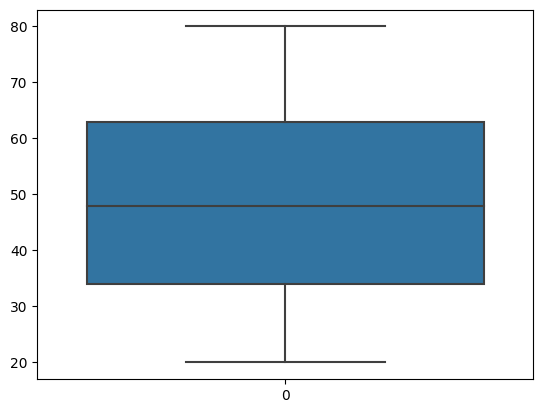

In [18]:
sns.boxplot(df['Age']) # boxplot for Age

we can see from above graph, how Age is well distributed towards both extremes, showing how the dataset has incorporated people as young as in their early twenties to as old as in theirs late eighties, leading to high inclusivity.

---

<Axes: xlabel='Sex', ylabel='Count'>

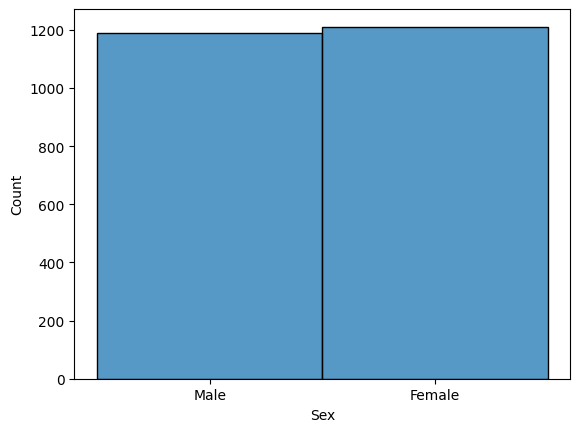

In [19]:
sns.histplot(df['Sex']) # histogram plot for Sex-count

from above histogram, we can see the class imbalance for Sex is near minimal, both being around 1200 cases.

this suggests equal participation of both Sexes in the survey.

---

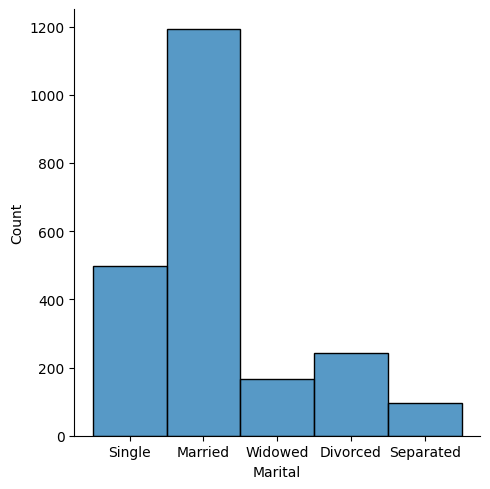

In [20]:
sns.displot(df['Marital']) # distribution plot for Marital-count

from above histogram we can see that the majority participators were married, with Single being the second highest. 

imbalance towards married and single, specifically married.

---

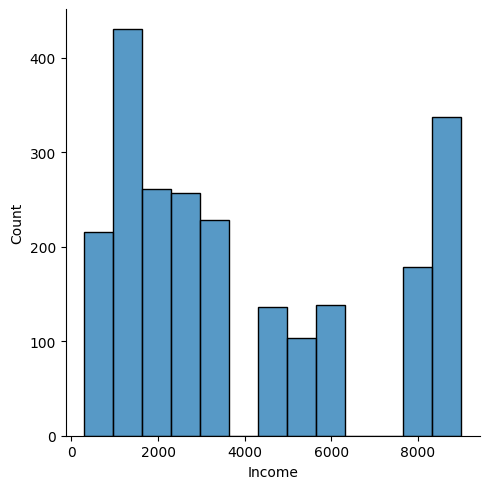

In [21]:
sns.displot(df['Income']) # distribution plot for Income-count

<Axes: >

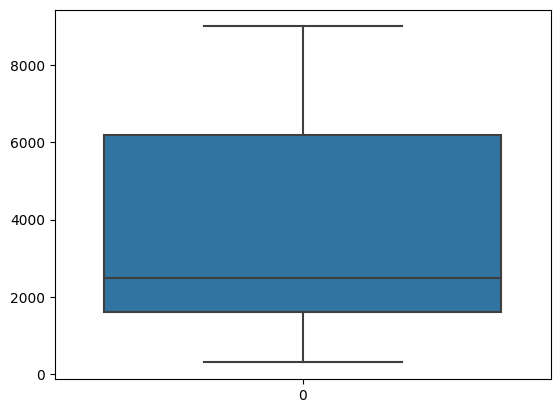

In [22]:
sns.boxplot(df['Income']) # boxplot for Income


The graph for income shows that people are divided into low, middle, and high earners. The average income is around 4000, but some individuals earn as much as 9000. Looking at the density, we notice that there are more people with lower incomes.

When we examine the population distribution based on wealth, it appears that there's an inverse relationship between wealth and population. This means that fewer people have more wealth, while the middle-income group is even smaller. This suggests that extreme wealth or poverty are more prevalent compared to moderate wealth.

imbalanced towards lower-wage end. 

---

<Axes: xlabel='Race', ylabel='Count'>

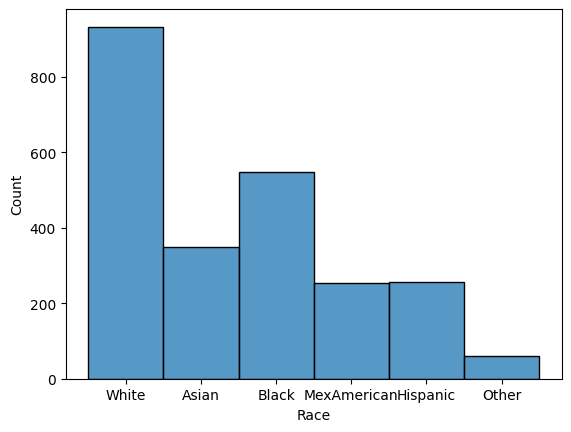

In [23]:
sns.histplot(df['Race']) # histogram plot for Race-count

the above graph suggests that majority participants were White, with Black being second. this is in line with american population distribution, but can affect standards of lower-population segments like asians, hispanics and mexico-american.

imbalanced towards whites and blacks.

---

<Axes: xlabel='BMI', ylabel='Count'>

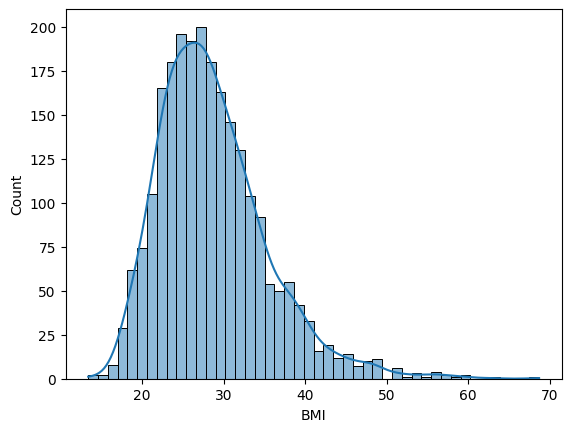

In [24]:
sns.histplot(df['BMI'], kde=True) # histogram plot for BMI-count

<Axes: >

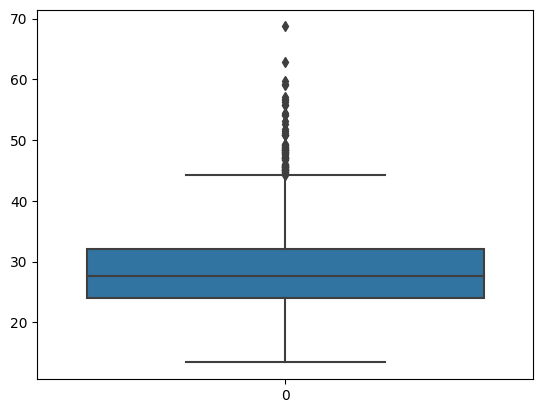

In [25]:
sns.boxplot(df['BMI']) # boxplot for BMI

the BMI distribution suggests, that the average participant is boderline overweight, due to the mean value of around 28 and no. of cases at 50th percentile having a BMI of 27 suggesting pariticipants are either overweight or near obese for some cases.

based on boxplot: has outliers

---

<Axes: xlabel='BloodGlucose', ylabel='Count'>

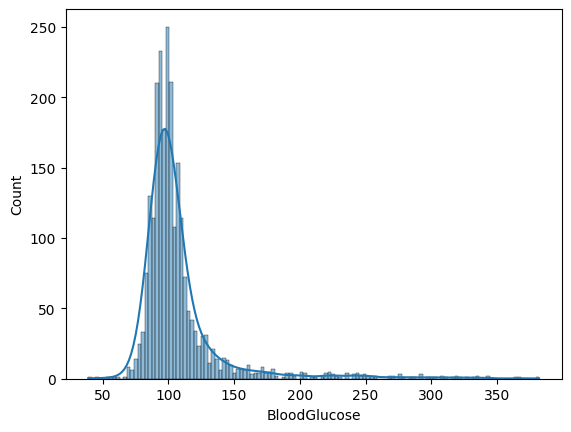

In [26]:
sns.histplot(df['BloodGlucose'], kde=True) # histogram plot for Blood Glucose levels

<Axes: >

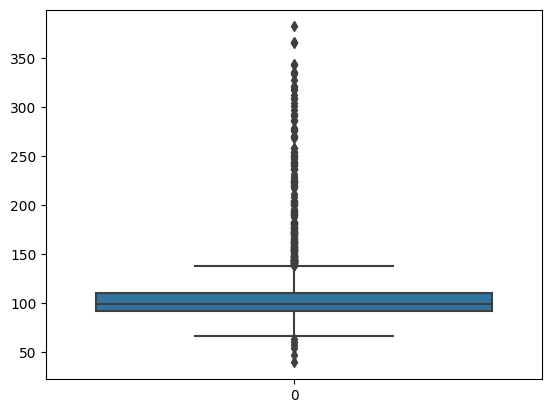

In [27]:
sns.boxplot(df['BloodGlucose']) # boxplot for BloodGlucose

the blood glucose level graph suggests participants being in the prediabetic stages, with the minority being diabetic.

based on boxplot: contains outliers

---

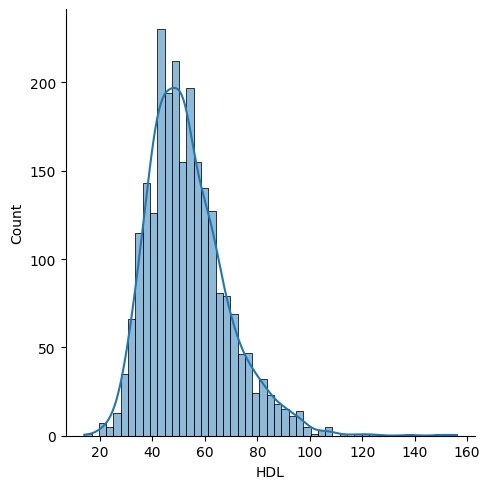

In [28]:
sns.displot(df['HDL'], kde=True) # distribution plot for HDL levels

<Axes: >

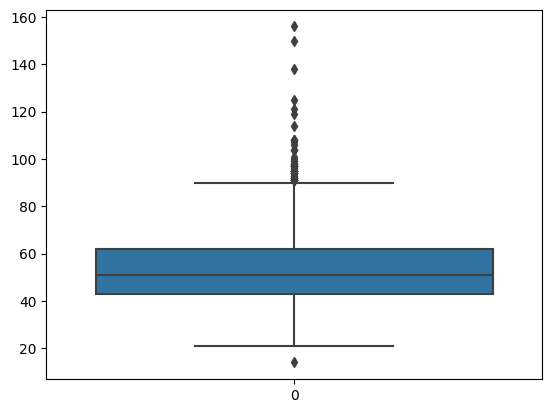

In [29]:
sns.boxplot(df['HDL']) # boxplot for HDL

the HDL graph suggests most individuals are under normal-to-high consumptive range of HDl which benefits the heart. very few have higher amounts of HDl above 60 while the majority is at the middle-lower end suggesting a lesser rate of HDL presence.

based on boxplot: contains outliers

---

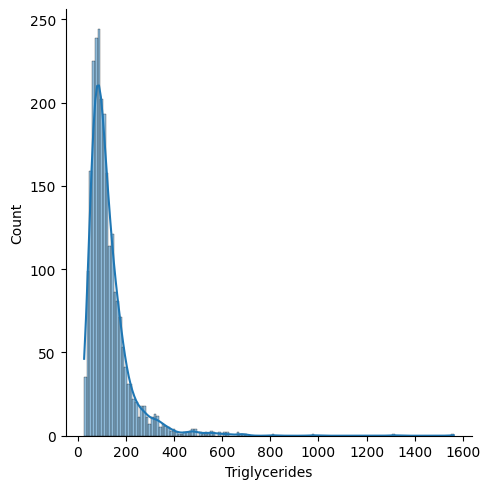

In [30]:
sns.displot(df['Triglycerides'], kde=True) # distribution plot for Triglycerides levels

<Axes: >

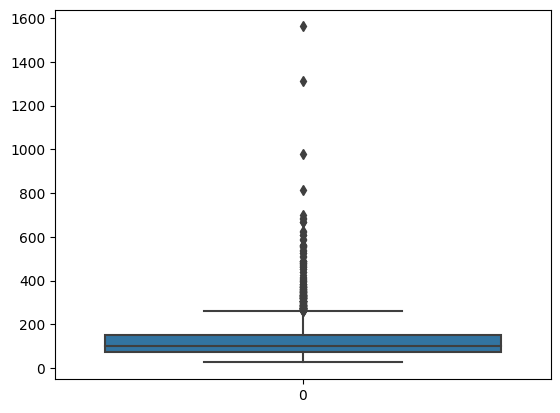

In [31]:
sns.boxplot(df['Triglycerides']) # boxplot for Triglycerides

triglycerides presence in participants show a tendency of being on borderline high and may well be high based on graph and safe limits.

based on boxplot: contains outliers

---

<Axes: xlabel='Albuminuria', ylabel='Count'>

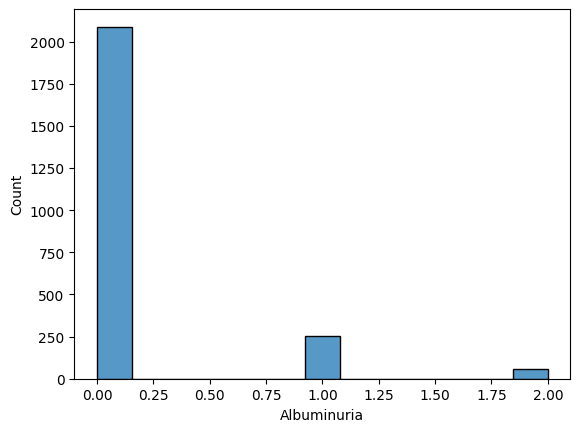

In [32]:
sns.histplot(df['Albuminuria'])# histogram plot for Albuminuria pateints distribution

major distribution of Albuminuria graph on the lower end suggests very few individuals suffered froma failed kidney.

---

<Axes: xlabel='MetabolicSyndrome', ylabel='Count'>

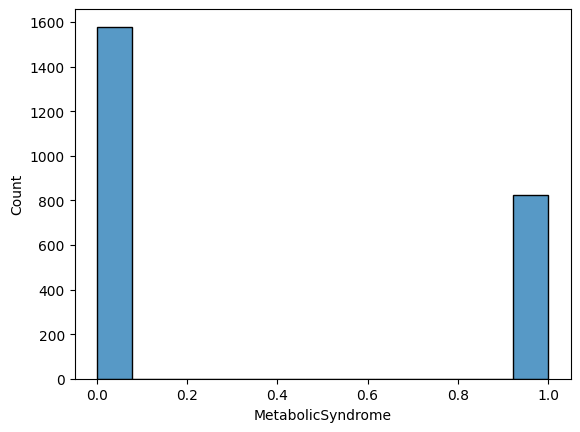

In [33]:
sns.histplot(df['MetabolicSyndrome'])# histogram plot for MetabolicSyndrome patients distribution

Metabolic Syndrome graph suggests that approximstely 75% patients are not suffering from any diseases or issues regarding metabolism as of now.

imbalanced towards safe participants.

---

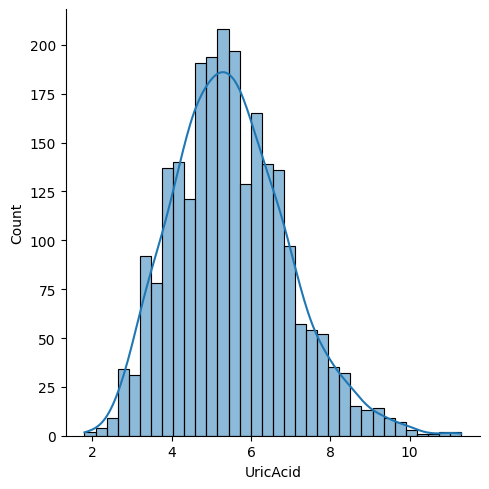

In [34]:
sns.displot(df['UricAcid'], kde=True) # distribution plot for Uric Acid

<Axes: >

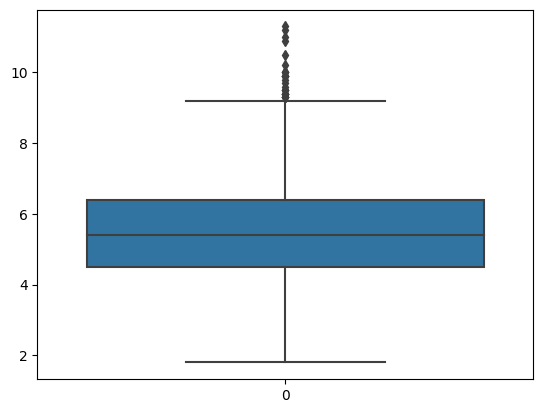

In [35]:
sns.boxplot(df['UricAcid']) # boxplot for UricAcid

Uric Acid curve suggests majority of the participants in survey had a normal level of uric acid presence, bordering the safe range at upper extremes.

based on boxplot: contains outliers

---

<Axes: xlabel='BMI', ylabel='WaistCirc'>

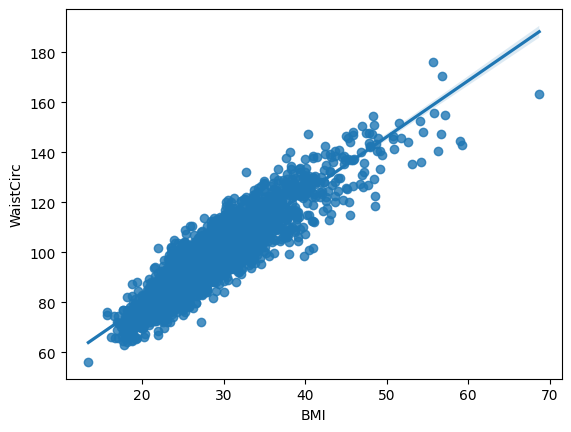

In [36]:
sns.regplot(x = df['BMI'], y = df['WaistCirc'])

above regression plot with best fit line shows BMI is positively linked with Waist Circumference, showing how a rising BMI (obesity) leads to higher waist circumference since fat stores easily in waist.

---

<Axes: xlabel='BloodGlucose', ylabel='Triglycerides'>

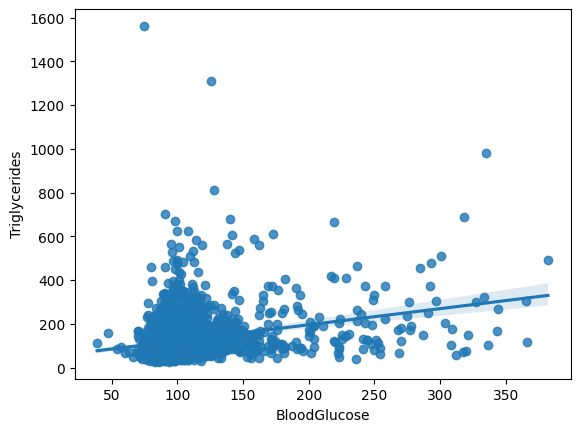

In [37]:
sns.regplot(x = df['BloodGlucose'], y = df['Triglycerides'])

above regression plot with best fit line shows Blood Glucose is positively linked with Triglycerides, showing how rising Triglycerides in blood stream contribute to Blood Glucose levels.

---

<Axes: xlabel='BloodGlucose', ylabel='BMI'>

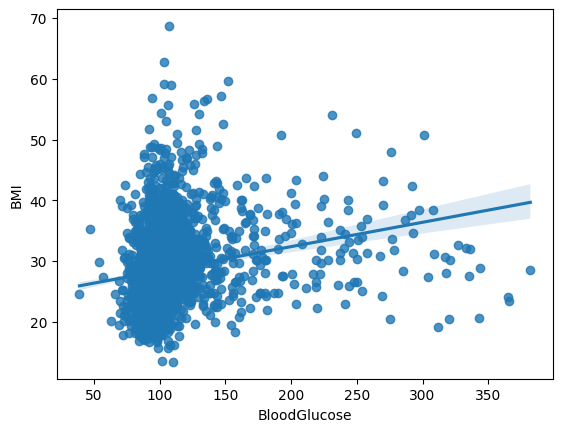

In [38]:
sns.regplot(x = df['BloodGlucose'], y = df['BMI'])

above regression plot with best fit line shows Blood Glucose is positively linked with BMI, showing how rising blood glucose levels indicate obesity through BMI since metabolic activity slowing results in rising Blood Glucose levels.

---

<Axes: xlabel='Triglycerides', ylabel='WaistCirc'>

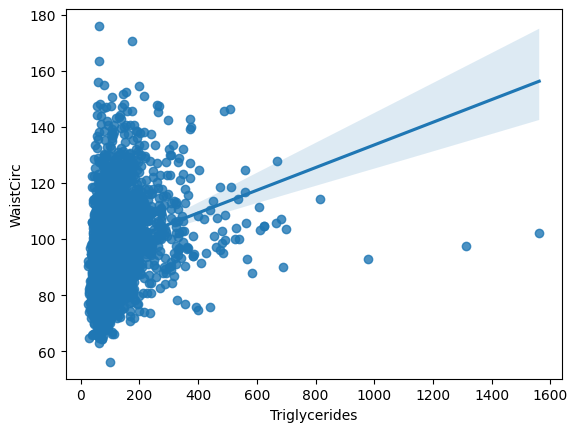

In [39]:
sns.regplot(x = df['Triglycerides'], y = df['WaistCirc'])

above regression plot with best fit line shows Triglycerides is positively linked with Waist Circumference, showing how a rising Triglycerides count in blood leads to higher waist circumference since fat stores easily in waist as Triglycerides are not getting digested and instead are accumulating in blood stream as well as in body, stored in waist.

---

## 6 & 7. Data Imputation and Data Encoding

In [2]:
df.isnull().sum()

seqn                   0
Age                    0
Sex                    0
Marital              208
Income               117
Race                   0
WaistCirc             85
BMI                   26
Albuminuria            0
UrAlbCr                0
UricAcid               0
BloodGlucose           0
HDL                    0
Triglycerides          0
MetabolicSyndrome      0
dtype: int64

In [3]:
from sklearn.preprocessing import LabelEncoder

encode1 = LabelEncoder()

df['Sex'] = encode1.fit_transform(df['Sex']) # Encoding Sex into 0 and 1

encode2 = LabelEncoder()

non_nan_mask = df['Marital'].notna()
df.loc[non_nan_mask, 'Marital'] = encode2.fit_transform(df.loc[non_nan_mask, 'Marital']).astype('int64') # Marital is the only feature which can be Ordinally-encoded between the three

encode3 = LabelEncoder()

df['Race'] = encode3.fit_transform(df['Race']) # Encoding Race into 0-5

In [4]:
df.isnull().sum()

seqn                   0
Age                    0
Sex                    0
Marital              208
Income               117
Race                   0
WaistCirc             85
BMI                   26
Albuminuria            0
UrAlbCr                0
UricAcid               0
BloodGlucose           0
HDL                    0
Triglycerides          0
MetabolicSyndrome      0
dtype: int64

In [5]:
# based on sex, we impute Marital status as median based approach (categorical feature originally)

male_median_marital = df[df['Sex'] == 1]['Marital'].median()
female_median_marital = df[df['Sex'] == 0]['Marital'].median()

df.loc[df['Sex'] == 1, 'Marital'] = df.loc[df['Sex'] == 1, 'Marital'].fillna(male_median_marital)
df.loc[df['Sex'] == 0, 'Marital'] = df.loc[df['Sex'] == 0, 'Marital'].fillna(female_median_marital)

# based on sex, we impute Income as mean based approach (numerical feature)

male_median_income = df[df['Sex'] == 1]['Income'].mean()
female_median_income = df[df['Sex'] == 0]['Income'].mean()

df.loc[df['Sex'] == 1, 'Income'] = df.loc[df['Sex'] == 1, 'Income'].fillna(male_median_income)
df.loc[df['Sex'] == 0, 'Income'] = df.loc[df['Sex'] == 0, 'Income'].fillna(female_median_income)

# based on sex, we impute Waist Circumference as mean based approach (numerical feature)

male_median_waist = df[df['Sex'] == 1]['WaistCirc'].mean()
female_median_waist = df[df['Sex'] == 0]['WaistCirc'].mean()

df.loc[df['Sex'] == 1, 'WaistCirc'] = df.loc[df['Sex'] == 1, 'WaistCirc'].fillna(male_median_waist)
df.loc[df['Sex'] == 0, 'WaistCirc'] = df.loc[df['Sex'] == 0, 'WaistCirc'].fillna(female_median_waist)

# based on sex, we impute BMI as mean based approach (numerical feature)

male_median_bmi = df[df['Sex'] == 1]['BMI'].mean()
female_median_bmi = df[df['Sex'] == 0]['BMI'].mean()

df.loc[df['Sex'] == 1, 'BMI'] = df.loc[df['Sex'] == 1, 'BMI'].fillna(male_median_bmi)
df.loc[df['Sex'] == 0, 'BMI'] = df.loc[df['Sex'] == 0, 'BMI'].fillna(female_median_bmi)

In [6]:
df = df.astype('float64')

In [7]:
df.isnull().sum()

seqn                 0
Age                  0
Sex                  0
Marital              0
Income               0
Race                 0
WaistCirc            0
BMI                  0
Albuminuria          0
UrAlbCr              0
UricAcid             0
BloodGlucose         0
HDL                  0
Triglycerides        0
MetabolicSyndrome    0
dtype: int64

## 2. Explore Correlation Matrix (can try different methods and search if they give the same conclusion and why)

**Pearson correlational technique**: Measures the linear relationship between two continuous variables. 1:1 relation, if one increases the other increases, and vice-versa. Linear

**Spearman correlational technique**: Measures the monotonic relationship between two variables, capturing all trends seen. as coeff increases, the correlation increases more. Non-linear

**Kendall correlational technique**: Measures the ordinal relationship between two variables, which means it captures the direction and significance of the ranking order. co-dependence is shown in a more concise way as importance of one influences the other more. Non-linear

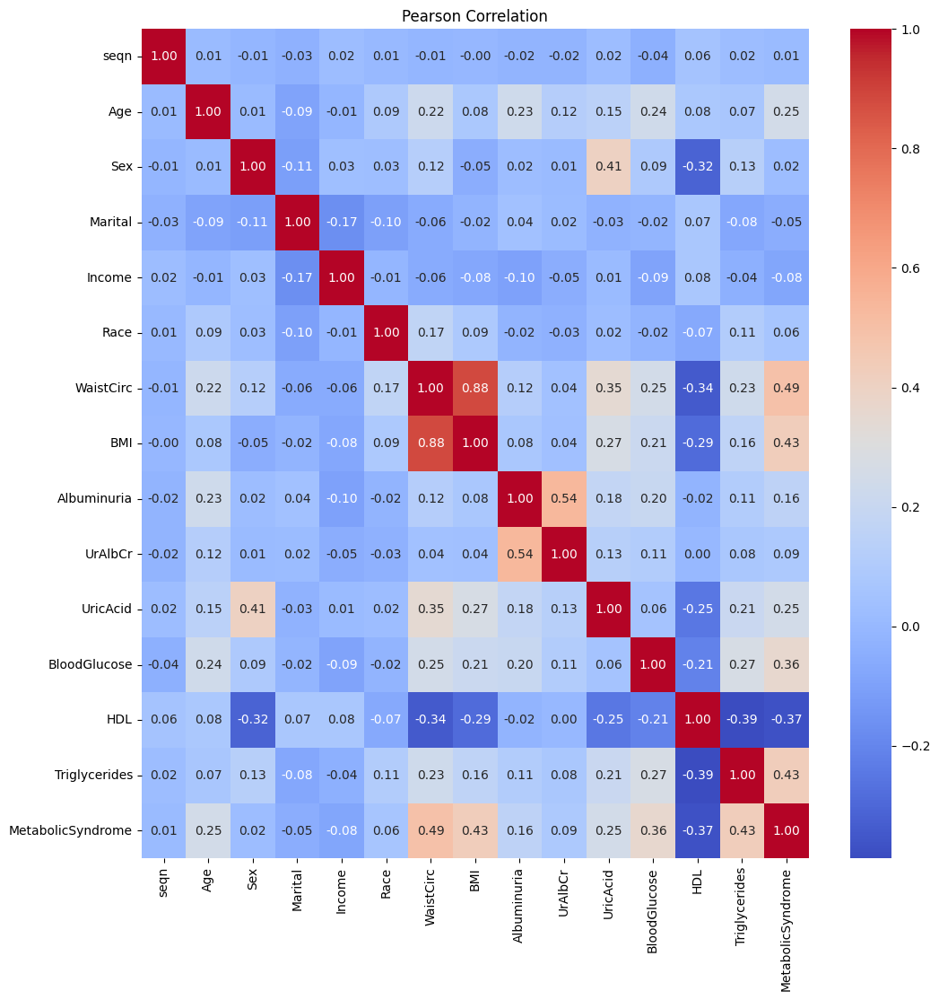

In [8]:
import matplotlib.pyplot as plt
import seaborn as sns

pearson_corr = df.corr(method='pearson')
plt.figure(figsize=(12,12))
sns.heatmap(pearson_corr, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Pearson Correlation')
plt.show()

### Insights from Pearson Correlational Heatmap:

features that MetabolicSyndrome depends on the most: (descending order)

* **WaistCirc**

* **Triglycerides**

* **BMI**

* **BloodGlucose**

* **Age**

* UricAcid

* Albuminuria

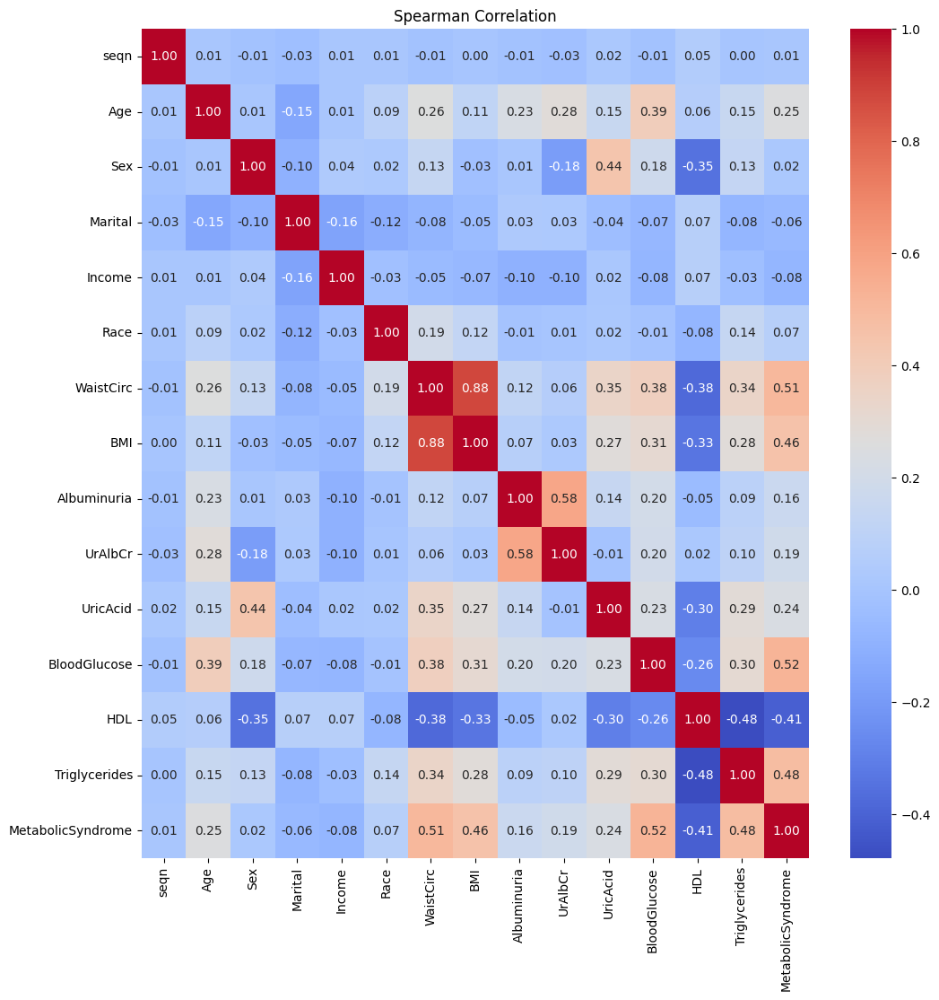

In [9]:
spearman_corr = df.corr(method='spearman')
plt.figure(figsize=(12,12))
sns.heatmap(spearman_corr, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Spearman Correlation')
plt.show()

### Insights from Spearman Correlational Heatmap:

features that MetabolicSyndrome depends on the most: (descending order)

* **BloodGlucose**

* **WaistCirc**

* **Triglycerides**

* **BMI**

* **Age**

* UricAcid

* UrAlbCr

* Albuminuria

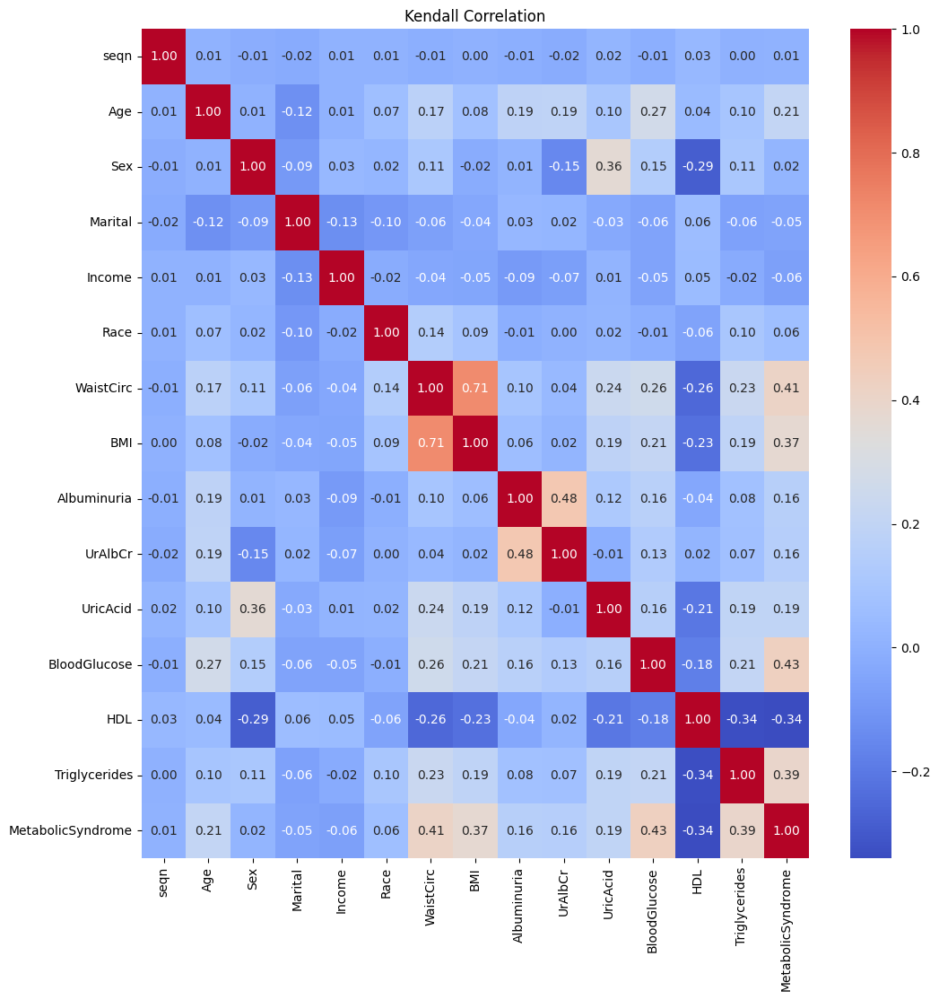

In [10]:
kendall_corr = df.corr(method='kendall')
plt.figure(figsize=(12,12))
sns.heatmap(kendall_corr, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Kendall Correlation')
plt.show()

### Insights from Kendall Correlational Heatmap:

features that MetabolicSyndrome depends on the most: (descending order)

* **BloodGlucose**

* **WaistCirc**

* **Triglycerides**

* **BMI**

* **Age**

* UricAcid

* Albuminuria

* UrAlbCr

## Overall Insights from Correlational Matrices:

features that MetabolicSyndrome depends on the most: (descending order)

* **BloodGlucose**

* **WaistCirc**

* **Triglycerides**

* **BMI**

* **Age**

* **UricAcid**

* **Albuminuria**

specifically, we see that the top 5 listed are the most crucial features of the dataset.

we can see this from the fact that metabolism is coreliant on all of these factors:

* Age since aging slows down metabolism.

* BMI since a higher BMi makes it difficult for metabolic activities.

* Blood Glucose levels since a lower Metabolism rate digests sugar slower resulting in more glucose concentration in blood which shows up as Blood Glucose.

* Waist Circumference, since metabolic activites slowing down results in body storing fat in the body which prominently shows up in the waist of the body.

* Triglycerides since these are the most common fats making up the average human diet which are to be digested, and a slow metabolic rate would lead to these fats storing in the body.

* Albuminuria, a diease linked with liver damage, shows up as presence of Albumin a blood protien being found in urea. this would suggest the load on kidneys due to improper metabolic activities. Since the data suggests about 25% participants have the issue, the correlational index is lower.

* Uric Acid is present in urea, whose increase suggests that metabolic activity to filter out has decreased.

the above study thus brings important features from original 

**14 predictors - 1 target**
 
to 

**7 predictors - 1 target**

## 3. Check the distribution(skewness) of the columns

In [13]:
list(df.skew(axis=0)) # finding skewness of columns based on rows, and converting to list for easy access

[-0.009307607934324563,
 0.13401831052682034,
 0.017504318034388257,
 0.7886944574993665,
 0.6280126479271905,
 -0.05641975421154886,
 0.647590949772895,
 1.1282989247818138,
 2.8192769280946406,
 13.29116289069048,
 0.4710241772770952,
 3.7664125700395132,
 1.0828275775971885,
 4.462779053792044,
 0.6648755439611503]

Based on skew results column-wise, we see that the majority of columns are Moderately skewed (9) while the remaining are highly skewed (6), none being neutrally skewed. 

**all columns except 2** are **rightly-skewed**, meaning **mean of the column > median of the column** : 

this would be interpreted as columns having majority values below median but some outliers existing which pull the mean beyond median.

the remaining 2 are **leftly-skewed**, meaning **mean of the column < median of the column** :

this would be interpreted as columns having majority values above median but some outliers existing which pull the mean beyond median.

### reducing skewness:

for **moderately-skewed**: transforming under **square-rooted/cubed transform** : x^^(1/2) or x^^(1/3)

for **highly-skewed**: transforming under **logarithmic transform** : **log(x)** *base b*

## 4. Detect Outliers(don't remove)

In [46]:
from scipy.stats import zscore

z_score = {} # holds entire framework of z-score tested outliers

for i in df.columns: # iterating over columns
    z_scores = zscore(df[i]) # z score of current column
    outliers = z_scores[abs(z_scores) > 2.5] # judging threshold of z-score is 2.5

    z_score[i] = outliers # storing outliers based on columns

In [47]:
IQR_score = {} # holds entire framework of IQR tested outliers

for column in df.columns:
    Q1 = df[column].quantile(0.25) # 1st Quartile
    Q3 = df[column].quantile(0.75) # 3rd Quartile
    
    IQR = Q3 - Q1 # difference of quartiles : equivalent to boxplot's central distribution mass

    outliers = df[(df[column] < Q1-1.5*IQR) | (df[column] > Q3+1.5*IQR)][column] # judging values greater than 3rduartile and below 1st quartile as outliers 

    if not outliers.empty:
        IQR_score[column] = outliers # storing outliers

## 5. Detect Class Label Imbalance

we have previously identified class imbalance using histograms for following features with high imbalance: 

* Race
* Marital
* MetabolicSyndrome
* Albuminuria

we also know from graphs that Sex is slightly imbalanced

### Based on count:

In [48]:
for i in ['Sex','Marital','Race','MetabolicSyndrome','Albuminuria']:   
    count = df[i].value_counts() # finds count for each class
    print(count)
    print()

# descending order

Sex
0    1211
1    1190
Name: count, dtype: int64

Marital
1    1192
3     498
0     242
5     208
4     166
2      95
Name: count, dtype: int64

Race
5    933
1    548
0    349
2    257
3    253
4     61
Name: count, dtype: int64

MetabolicSyndrome
0    1579
1     822
Name: count, dtype: int64

Albuminuria
0    2089
1     254
2      58
Name: count, dtype: int64



---

# Metabolic Syndrome Prediction | 3. Statistical Tests for Feature Importance

-> Principle Component Analysis (PCA)

-> Chi-squared test

-> ANOVA test

-> Independent Component Analysis (ICA)

-> Permutation-related tests

-> Information Gain

Before we proceed in this section, we can remove some inconsequential features: seqn due to its inability to help generalize the problem.

In [7]:
df = df.drop(columns = ['seqn'],axis = 1)

pca_df = df.copy().drop(columns = ['MetabolicSyndrome'],axis = 1)
# pca_df only for PCA

---

## 1. Principle Component Analysis (PCA)

PCA can be used to identify the most important features by examining the contribution of each original feature to the top principal components. The principal components are ordered by the amount of variance they explain in the data. Features with high loadings on the top principal components are considered more important.

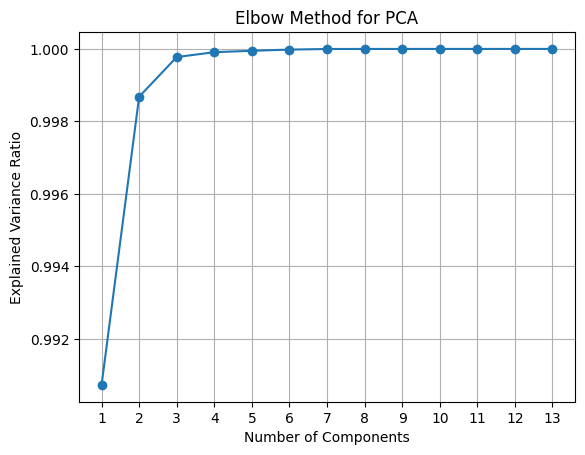

In [50]:
from sklearn.decomposition import PCA

max_comp_var, components = 0, 0
explained_variances = []

for n in range(1, pca_df.shape[1] + 1): # for all components
    pca = PCA(n_components=n) 
    pca.fit(pca_df) # fitting PCA on all components 1 to 13
    explained_variances.append(pca.explained_variance_ratio_.sum())

    if max_comp_var < pca.explained_variance_ratio_.sum():
        max_comp_var = pca.explained_variance_ratio_.sum()
        components = n

# Elbow method
plt.plot(np.arange(1, pca_df.shape[1] + 1), explained_variances, marker='o')
plt.xlabel('Number of Components')
plt.ylabel('Explained Variance Ratio')
plt.title('Elbow Method for PCA')
plt.xticks(np.arange(1, pca_df.shape[1] + 1))
plt.grid(True)
plt.show()

**Elbow Method**: we choose the most optimal solution as the one where plateau just begins to form

We identify ***most optimal components*** at **6** based on the *Elbow method*.

In [51]:
pca = PCA(n_components=13) # all components
pca.fit(pca_df) # fitting pCA

components = pca.components_

feature_importance_df = pd.DataFrame(components, columns=pca_df.columns)

for i, component in enumerate(components):
    print(f"Component {i+1}:")
    sorted_indices = np.argsort(np.abs(component))[::-1]
    for idx in sorted_indices:
        print(f"{pca_df.columns[idx]}: {component[idx]}")
    print("\n")

Component 1:
Income: 0.9999889275612845
UrAlbCr: -0.004350241333939409
Triglycerides: -0.0012915974010456743
BloodGlucose: -0.001109362182806134
HDL: 0.0003973070044470117
WaistCirc: -0.00033465381918323933
BMI: -0.00018131842674529337
Marital: -0.00011511157932311833
Age: -7.031287447264291e-05
Albuminuria: -1.418410602114107e-05
Race: -9.057147523441628e-06
Sex: 5.406296896159901e-06
UricAcid: 4.175893686595138e-06


Component 2:
UrAlbCr: 0.9993116338929828
Triglycerides: 0.03273428776350941
BloodGlucose: 0.01447746030215348
Age: 0.008177338688185086
Income: 0.004407223815507455
WaistCirc: 0.002557243892702933
BMI: 0.0009475948654672894
Albuminuria: 0.000873404701990959
UricAcid: 0.0007477215626692599
Race: -0.0002366012945254855
Marital: -0.00013817709077364876
Sex: 2.8136128239042435e-05
HDL: 1.4275318185097419e-05


Component 3:
Triglycerides: 0.9905370760823168
BloodGlucose: 0.1078384808076511
HDL: -0.06370668630090635
WaistCirc: 0.040624931290122956
UrAlbCr: -0.03423686935123234

for 13 components PCA: feature importance

**Component 1 : Income : Most Positive feature in Component**

**Component 2 : UrAlbCr : Most Positive feature in Component**

**Component 3 : Triglycerides : Most Positive feature in Component**

**Component 4 : BloodGlucose : Most Positive feature in Component**

**Component 5 : Age : Most Negative feature in Component**

**Component 6 : HDL : Most Positive feature in Component**

**Component 7 : HDL : Most Positive feature in Component**

**Component 8 : BMI : Most Positive feature in Component**

**Component 9 : Race : Most Positive feature in Component**

**Component 10 : Marital : Most Positive feature in Component**

**Component 11 : UricAcid : Most Positive feature in Component**

**Component 12 : Sex : Most Negative feature in Component**

**Component 13 : Albuminuria : Most Negative feature in Component**

---

In [52]:
pca = PCA(n_components=6) # optimal no. of components
pca.fit(pca_df) # fitting PCA

components = pca.components_

feature_importance_df = pd.DataFrame(components, columns=pca_df.columns)

for i, component in enumerate(components):
    print(f"Component {i+1}:")
    sorted_indices = np.argsort(np.abs(component))[::-1]
    for idx in sorted_indices:
        print(f"{pca_df.columns[idx]}: {component[idx]}")
    print("\n")

Component 1:
Income: 0.9999889275612848
UrAlbCr: -0.004350241333939464
Triglycerides: -0.0012915974010457298
BloodGlucose: -0.001109362182806134
HDL: 0.00039730700444700826
WaistCirc: -0.00033465381918326015
BMI: -0.00018131842674529164
Marital: -0.00011511157932311313
Age: -7.031287447267143e-05
Albuminuria: -1.4184106021142154e-05
Race: -9.057147523443363e-06
Sex: 5.406296895826834e-06
UricAcid: 4.175893686593404e-06


Component 2:
UrAlbCr: 0.9993116338929829
Triglycerides: 0.03273428776350959
BloodGlucose: 0.01447746030215366
Age: 0.008177338688184922
Income: 0.004407223815507122
WaistCirc: 0.0025572438927029054
BMI: 0.0009475948654672928
Albuminuria: 0.0008734047019909579
UricAcid: 0.0007477215626692634
Race: -0.00023660129452549201
Marital: -0.00013817709077399744
Sex: 2.81361282373771e-05
HDL: 1.4275318185069663e-05


Component 3:
Triglycerides: 0.9905370760823164
BloodGlucose: 0.10783848080765136
HDL: -0.06370668630090626
WaistCirc: 0.040624931290122984
UrAlbCr: -0.0342368693512

for 6 components PCA: feature importance

**Component 1 : Income : Most Positive feature in Component**

**Component 2 : UrAlbCr : Most Positive feature in Component**

**Component 3 : Triglycerides : Most Positive feature in Component**

**Component 4 : BloodGlucose : Most Positive feature in Component**

**Component 5 : Age : Most Negative feature in Component**

**Component 6 : HDL : Most Positive feature in Component**

<Figure size 1200x1000 with 0 Axes>

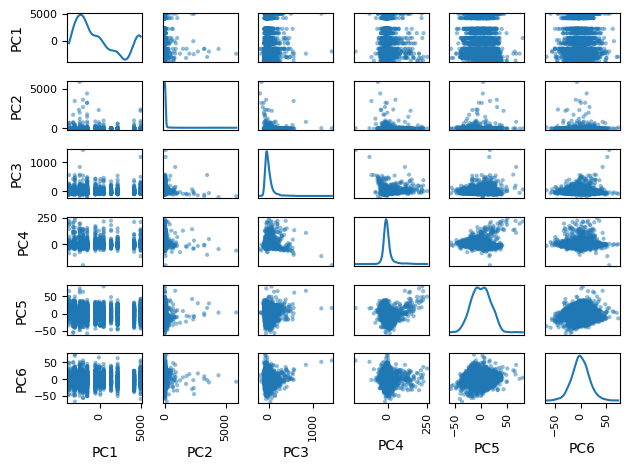

In [53]:
# Plotting 6 Components of PCA

pca = PCA(n_components=6)
X_pca = pca.fit_transform(pca_df)
X_pca_df = pd.DataFrame(X_pca, columns=[f'PC{i+1}' for i in range(X_pca.shape[1])])

# Create a pairwise scatter plot
plt.figure(figsize=(12, 10))
pd.plotting.scatter_matrix(X_pca_df, alpha=0.5, diagonal='kde')
plt.tight_layout()
plt.show()

---

## 2. Chi-squared test

In feature selection, the chi-square test can be used to measure the dependence between a categorical feature and the target variable. Features with a high chi-square statistic (and low p-value) are considered more important, as they are more likely to be related to the target variable.

In [54]:
from scipy.stats import chi2_contingency
import pandas as pd

categorical_feat = df[['Race', 'Sex', 'Marital', 'Albuminuria', 'MetabolicSyndrome']]

contingency_table = pd.crosstab(index=categorical_feat['MetabolicSyndrome'],columns=[categorical_feat['Sex'],categorical_feat['Marital'],categorical_feat['Albuminuria'],categorical_feat['Race']])

chi2_stat, p_val, dof, expected = chi2_contingency(contingency_table) # chi-square test implementation

print("Chi-squared statistic: ", chi2_stat)
print("P-value: ", p_val)
print("Degrees of freedom: ", dof)

alpha = 0.001  # most stringent significance level
if p_val < alpha:
    print("Reject the null hypothesis. The variables are dependent.")
else:
    print("Fail to reject the null hypothesis. The variables are independent.")

Chi-squared statistic:  242.81087893949876
P-value:  1.874722563378977e-06
Degrees of freedom:  149
Reject the null hypothesis. The variables are dependent.


Based on the Chi-squared test, we find our **categorical variables** to be **inter-dependent**. We tested this under the **most stringent significance level** of **alpha = 0.001**, or a 0.1% chance of committing a ***Type I error*** by incorrectly rejecting the null hypothesis.

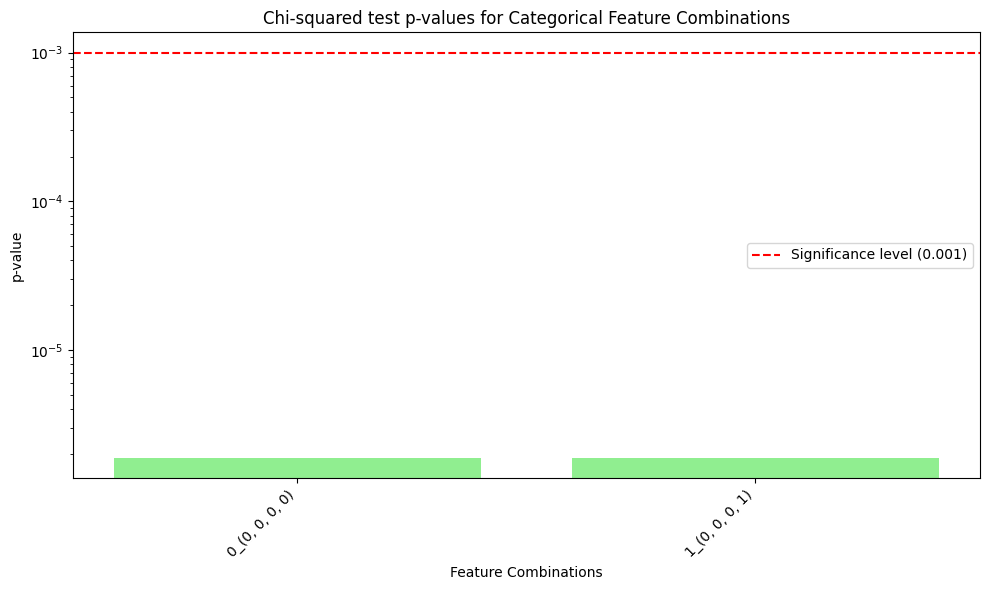

In [55]:
rows = contingency_table.index
columns = contingency_table.columns

# Create a single label for the combinations
combinations = [f'{row}_{column}' for row, column in zip(rows, columns)]

# Plotting
plt.figure(figsize=(10, 6))
plt.bar(combinations, [p_val] * len(combinations), color='lightgreen')
plt.title('Chi-squared test p-values for Categorical Feature Combinations')
plt.xlabel('Feature Combinations')
plt.ylabel('p-value')
plt.xticks(rotation=45, ha='right')
plt.yscale('log')
plt.axhline(y=0.001, color='r', linestyle='--', label='Significance level (0.001)')
plt.legend()
plt.tight_layout()
plt.show()

---

## 3. ANOVA test

In feature selection, ANOVA can be used to evaluate the significance of a continuous feature by comparing the means of the target variable across different levels or categories of the feature. Features with a low p-value (indicating significant differences in means) are considered more important.

In [56]:
import statsmodels.api as sm
from statsmodels.formula.api import ols
numerical_features = df.copy().drop(columns=['Race', 'Sex', 'Marital', 'Albuminuria','MetabolicSyndrome'], axis=1) 
target = df['MetabolicSyndrome'] 

for feature in numerical_features.columns: 
    formula = f"{feature} ~ C(target)" 
    model = ols(formula, data=df).fit() 
    anova_table = sm.stats.anova_lm(model, typ=2) # ANOVA test implementation
    print(f"ANOVA Results for {feature}:") 
    print(anova_table) 
    print("---" * 10) 
    
    alpha = 0.001 # most stringent significance level

    if anova_table.loc['C(target)', 'PR(>F)'] < alpha: 
        print(f"{feature} is significantly linked to MetS.") 
    else: 
        print(f"{feature} is not significantly linked to MetS.") 
    print("\n")

ANOVA Results for Age:
                  sum_sq      df          F        PR(>F)
C(target)   46123.394458     1.0  158.05373  3.766793e-35
Residual   700078.533905  2399.0        NaN           NaN
------------------------------
Age is significantly linked to MetS.


ANOVA Results for Income:
                 sum_sq      df          F   PR(>F)
C(target)  1.333324e+08     1.0  16.163118  0.00006
Residual   1.978977e+10  2399.0        NaN      NaN
------------------------------
Income is significantly linked to MetS.


ANOVA Results for WaistCirc:
                  sum_sq      df           F         PR(>F)
C(target)  147142.031362     1.0  759.631137  1.652325e-145
Residual   464690.974309  2399.0         NaN            NaN
------------------------------
WaistCirc is significantly linked to MetS.


ANOVA Results for BMI:
                 sum_sq      df           F         PR(>F)
C(target)  19391.851645     1.0  541.053992  4.292711e-108
Residual   85982.273128  2399.0         NaN         

Based on the above report, we find **all numerical features** to be **significantly linked** to our **target MetabolicSyndrome**.

*it is to be noted that ANOVA would not be considered a good fit as a test since it is based on continuous numerical data for both predictor and target.*

we also used the **most stringent significance level** of **alpha = 0.001** or 0.1%.

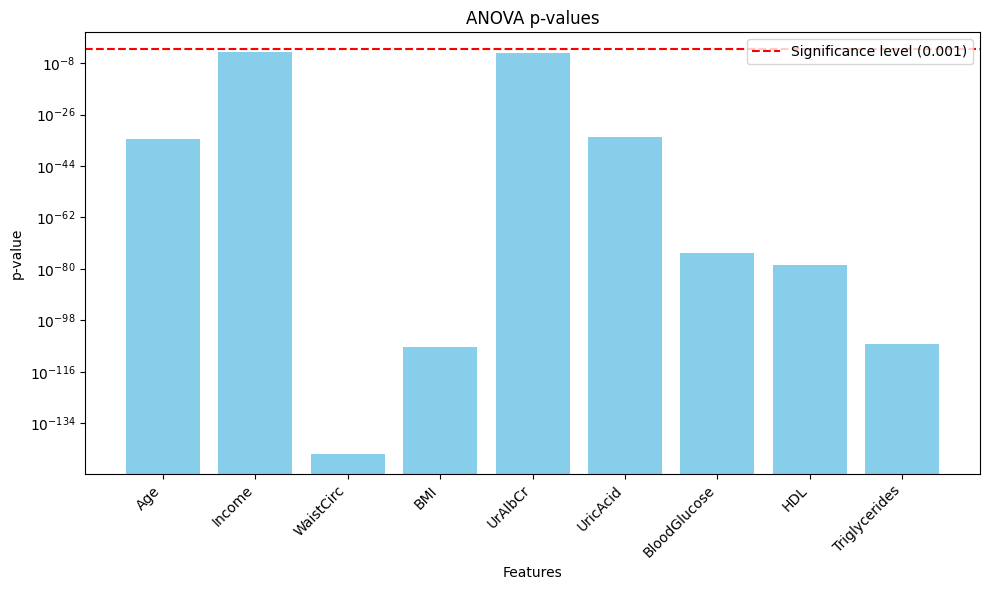

In [57]:
import matplotlib.pyplot as plt

# Initializing lists to store feature names and p-values
features = []
p_values = []

for feature in numerical_features.columns: 
    formula = f"{feature} ~ C(target)" 
    model = ols(formula, data=df).fit() 
    anova_table = sm.stats.anova_lm(model, typ=2) # ANOVA test implementation
    
    # Appending feature name and p-value to lists
    features.append(feature)
    p_values.append(anova_table.loc['C(target)', 'PR(>F)'])

# Plotting the graph
plt.figure(figsize=(10, 6))
plt.bar(features, p_values, color='skyblue')
plt.title('ANOVA p-values')
plt.xlabel('Features')
plt.ylabel('p-value')
plt.xticks(rotation=45, ha='right')
plt.yscale('log')
plt.axhline(y=0.001, color='r', linestyle='--', label='Significance level (0.001)')
plt.legend()
plt.tight_layout()
plt.show()


---

## 4. Independent Component Analysis (ICA)

 ICA can be used for feature selection by examining the contribution of each original feature to the independent components. Features with high loadings on the most important independent components are considered more relevant.

Kurtosis of the independent components:
[-0.8281669545821964, 1.6855762216032586, -0.6546835388909775, -1.613820362655503, 4.9944164368647055, 252.87952491592694, 1.1356583043825834, 5.839404746424373, 20.471581937336463, 18.91828752693258, -0.9294899478146053, 51.28298686685325, -1.9751375843866956]


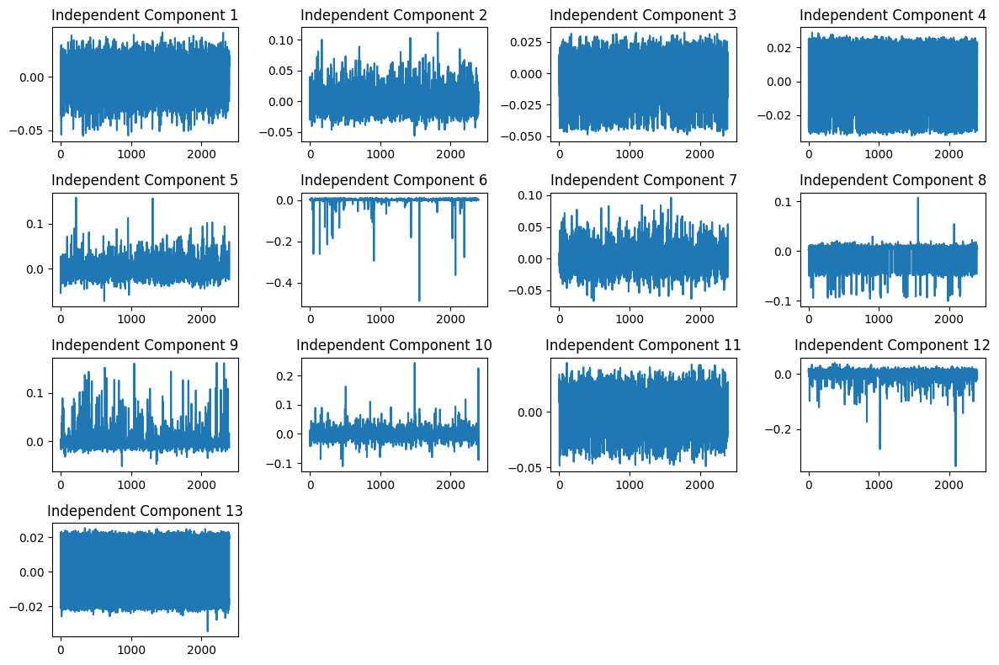

In [58]:
from sklearn.decomposition import FastICA
from scipy.stats import kurtosis

ica = FastICA()
S_ = ica.fit_transform(pca_df) # fitting ICA
A_ = ica.mixing_ 

kurt = [kurtosis(ic) for ic in S_.T] # getting Kurtosis metrics
print("Kurtosis of the independent components:")
print(kurt)

plt.figure(figsize=(12, 8)) # plotting components
for i in range(S_.shape[1]):
    plt.subplot(4, 4, i+1)
    plt.plot(S_[:, i])
    plt.title(f"Independent Component {i+1}")
    plt.tight_layout()
plt.show()

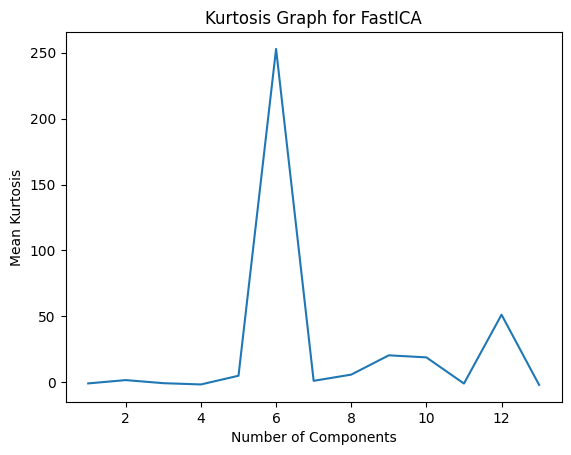

In [59]:
# plotting Kurtosis graph
plt.plot(range(1, pca_df.shape[1] + 1), kurt) 
plt.xlabel("Number of Components")
plt.ylabel("Mean Kurtosis")
plt.title("Kurtosis Graph for FastICA")
plt.show()

In [103]:
np.set_printoptions(suppress=True)

# removing scientific notation
np.array([[float('{:.10f}'.format(value)) for value in row] for row in ica.mixing_])

array([[    -23.67059858,     -69.54786501,     162.21858331,
             63.22851758,      62.40026019,     -69.62589835,
             40.84189019,    -132.48799918,      53.15674254,
             51.42968241,    -822.29385731,      29.80996498,
              1.68818802],
       [      0.23232377,      -0.02289942,       0.76182606,
              0.34062279,       0.03733147,      -0.1756267 ,
             -0.89335466,      -0.33748112,       0.51505414,
             -0.66270887,      -0.103145  ,      -1.19323884,
             24.42068885],
       [    -11.07177832,      -1.20004401,     -70.84492376,
              0.20623241,      -2.09604402,       0.93667779,
              0.00202338,       0.4957705 ,       1.55220453,
              1.09600922,       3.51124681,      -1.65783916,
             -2.48977894],
       [-128908.95689808,   -6358.77262169,   52848.32809243,
          -2785.020356  ,    2846.73373555,    3910.62291641,
          -8066.60594821,    8686.3510456 ,   -8341

In [94]:
pca_df.columns

Index(['Age', 'Sex', 'Marital', 'Income', 'Race', 'WaistCirc', 'BMI',
       'Albuminuria', 'UrAlbCr', 'UricAcid', 'BloodGlucose', 'HDL',
       'Triglycerides'],
      dtype='object')

Based on all 13 components' load bearings of ICA, we see the following:

*Note: the following bearings suggest independence of variables for positive values.*

**Component 1 : BloodGlucose : Most Negative feature in Component**

**Component 2 : Triglycerides : Most Positive feature in Component**

**Component 3 : Marital : Most Negative feature in Component**

**Component 4 : Age : Most Negative feature in Component**

**Component 5 : Race : Most Positive feature in Component**

**Component 6 : Sex : Most Positive feature in Component**

**Component 7 : Sex : Most Positive feature in Component**

**Component 8 : Albuminuria : Most Negative feature in Component**

**Component 9 : WaistCirc : Most Negative feature in Component**

**Component 10 : BMI : Most Positive feature in Component**

**Component 11 : UrAlbCr : Most Positive feature in Component**

**Component 12 : Race : Most Positive feature in Component**

**Component 13 : HDL : Most Negative feature in Component**

From above results we conclude following:

* 'HDL'

* 'WaistCirc'

* 'Albuminuria'

* 'Age'

* 'Marital'

* 'BloodGlucose'

show negative bearing or are not independent of others.

---

## 5. Permutation-related tests

 Permutation tests are non-parametric statistical tests that evaluate the significance of a feature by permuting (shuffling) the values of that feature and measuring the change in the model's performance or a chosen metric. Features that cause a significant change in performance when permuted are considered important.

### Recursive Feature Elimination (RFE)

In [95]:
x = df.copy().drop(columns=['MetabolicSyndrome'],axis = 1)
y = df.copy()['MetabolicSyndrome']

In [45]:
from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression

# Logistic Regression model
model = LogisticRegression()

# fitting the model
rfe = RFE(model, n_features_to_select=7)
fit = rfe.fit(x, y)

print("Chosen features:", fit.support_)
print("Feature rankings:", fit.ranking_)

selected_columns = x.columns[fit.support_] # column names for suggested features 
X_new = x.loc[:, selected_columns] # new suggested features

X_new

Chosen features: [ True  True False False  True  True False  True False  True False  True
 False]
Feature rankings: [1 1 3 7 1 1 2 1 6 1 5 1 4]


,Age,Sex,Race,WaistCirc,Albuminuria,UricAcid,HDL
0,22,1,5,81.000000,0,4.9,41
1,44,0,5,80.100000,0,4.5,28
2,21,1,0,69.600000,0,5.4,43
3,43,0,1,120.400000,0,5.0,73
4,51,1,0,81.100000,0,5.0,43
...,...,...,...,...,...,...,...
2396,48,0,4,96.341566,0,5.8,57
2397,30,0,0,96.341566,0,7.9,90
2398,28,1,3,100.800000,0,6.2,47
2399,27,1,3,106.600000,0,6.2,41


Based on RFE we find: Age, Sex, Race, WaistCirc, Albuminuria, UricAcid, HDL as permutationally dominant, affecting the modelling based on what permutation is being used.

### Model Reliance method

In [46]:
from sklearn.ensemble import RandomForestClassifier
from eli5.sklearn import PermutationImportance

# Random Forest model
rf = RandomForestClassifier(n_estimators=100, random_state=42)

# fitting the model
rf.fit(x, y)

# creating instance of PermutationImportance
perm_importance = PermutationImportance(rf, random_state=42)

# fitting the PermutationImportance model
perm_importance.fit(x, y)

# getting feature importances
sorted_importance = sorted(perm_importance.feature_importances_, reverse=True)

# printing top features and their importances
for feature, importance in zip(x.columns, sorted_importance):
    print(f"{feature}: {importance:.3f}")


Age: 0.137
Sex: 0.106
Marital: 0.073
Income: 0.052
Race: 0.040
WaistCirc: 0.019
BMI: 0.018
Albuminuria: 0.016
UrAlbCr: 0.006
UricAcid: 0.002
BloodGlucose: 0.001
HDL: 0.000
Triglycerides: 0.000


Based on RandomForestClassifier we find: Age, Sex, Marital, Income, Race, WaistCirc, BMI, Albuminuria as permutationally dominant, affecting the modelling based on what permutation is being used.

In [47]:
from xgboost import XGBClassifier

model_params = {
    'objective': 'binary:logistic',
    'n_estimators': 100,
    'learning_rate': 0.1,
    'max_depth': 3,
    'subsample': 0.8,
    'colsample_bytree': 0.8, 
    'enable_categorical' : True
}

# XGBoost classifier model
rf = XGBClassifier(**model_params)

# fitting the model
rf.fit(x, y)

# creating instance of PermutationImportance
perm_importance = PermutationImportance(rf, random_state=42)

# fitting the PermutationImportance model
perm_importance.fit(x, y)

# getting feature importances
sorted_importance = sorted(perm_importance.feature_importances_, reverse=True)

# printing top features and their importances
for feature, importance in zip(x.columns, sorted_importance):
    print(f"{feature}: {importance:.3f}")


Age: 0.109
Sex: 0.087
Marital: 0.075
Income: 0.049
Race: 0.040
WaistCirc: 0.019
BMI: 0.009
Albuminuria: 0.008
UrAlbCr: 0.004
UricAcid: 0.002
BloodGlucose: 0.002
HDL: 0.000
Triglycerides: 0.000


Based on XGBClassifier we find: Age, Sex, Marital, Income, Race, WaistCirc as permutationally dominant, affecting the modelling based on what permutation is being used.

### Sci-Kit Learn in-built permuation importance with HistGradientBoostingClassifier

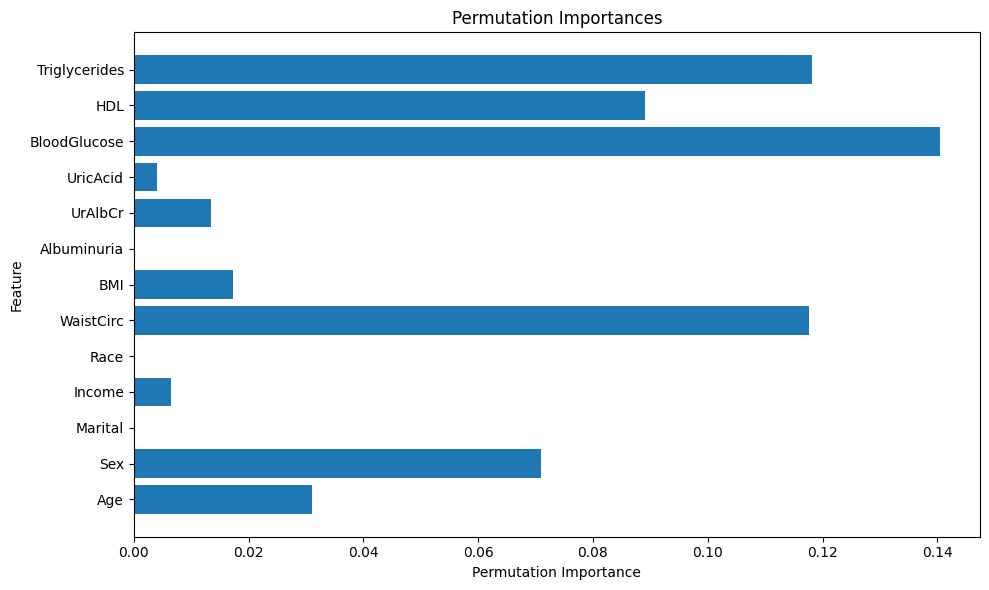

In [104]:
from sklearn.ensemble import HistGradientBoostingClassifier
from sklearn.inspection import permutation_importance
import matplotlib.pyplot as plt

model = HistGradientBoostingClassifier(random_state=42)

# fitting the model
model.fit(x, y)

# performing permutation importance
perm_importance = permutation_importance(model, x, y, n_repeats=10, random_state=42)

#plotting graph
plt.figure(figsize=(10, 6))
plt.barh(y=x.columns, width=perm_importance.importances_mean, align='center')
plt.xlabel('Permutation Importance')
plt.ylabel('Feature')
plt.title('Permutation Importances')

plt.tight_layout()
plt.show()

above diagram shows: MetabolicSyndrome is heavily influenced by:

* **'Triglycerides'**

* **'BloodGlucose'**

* **'HDL'**

* **'Sex'**

* **'waistCirc'**

* **'Age'**

## 6. Information Gain

In [50]:
from sklearn.feature_selection import mutual_info_classif
from collections import defaultdict

x = df.copy().drop(columns='MetabolicSyndrome', axis=1)
y = df.copy()['MetabolicSyndrome']

# dictionaries for storing vital information on Information gain
info_gain_null = defaultdict(int)
info_gain_major = defaultdict(int)
info_gain_max = defaultdict(int)

for i in range(100):
    info_gain = mutual_info_classif(x, y) # finding Information gain

    # No Gain
    for j in range(len(info_gain)):
        if info_gain[j] == 0:
            info_gain_null[j] += 1

    # Gain majority of the time
    for j in range(len(info_gain)):
        if info_gain[j] > 0.05:
            info_gain_major[j] += 1    

    # always Gain
    max_feat = np.argmax(info_gain)
    info_gain_max[max_feat] += 1

print("No information:",info_gain_null)
print()
print("Majority information:",info_gain_major)
print()
print("Max information:",info_gain_max)

No information: defaultdict(<class 'int'>, {3: 38, 1: 47, 4: 28, 2: 25, 7: 7})

Majority information: defaultdict(<class 'int'>, {5: 100, 6: 100, 10: 100, 11: 100, 12: 100, 0: 2, 9: 2})

Max information: defaultdict(<class 'int'>, {10: 70, 5: 28, 12: 2})


In [49]:
x.columns

Index(['Age', 'Sex', 'Marital', 'Income', 'Race', 'WaistCirc', 'BMI',
       'Albuminuria', 'UrAlbCr', 'UricAcid', 'BloodGlucose', 'HDL',
       'Triglycerides'],
      dtype='object')

From rigorous **Information Gain** test, we find the following:

after a **Hundred iterations** it was found that the following features show no importance with a score of 0:

* *'Sex'*

* *'Income'*

* *'Race'*

* *'Marital'*

* *'Albuminuria'*

We recieve majority information from following features:

* **'WaistCirc'**

* **'BMI'**

* **'BloodGlucose'**

* **'HDL'**

* **'Triglycerides'**

* **'Age'**

* **'UricAcid'**

We recieve Maximum information from following:

* ***'BloodGlucose'***

* ***'Triglycerides'***

* ***'WaistCirc'***

---

# Metabolic Syndrome Prediction | 4. ML-based Feature Importance

-> XGBoost (eXtreme Gradient Boosting model)

-> Random Forest

-> Decision Tree

-> LGBM (Light Gradient Boosting model)

-> CatBoost (Categorical Boosting model)

-> Extra Trees

-> AdaBoost (Adaptive Boosting)

-> Gradient Boosting model

In [41]:
x = df.copy().drop(columns=['MetabolicSyndrome'],axis = 1)
y = df.copy()['MetabolicSyndrome']

In [42]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3)

print("x_train:", x_train.shape)
print("y_train:", y_train.shape)
print("x_test:", x_test.shape)
print("y_test:", y_test.shape)

x_train: (1680, 13)
y_train: (1680,)
x_test: (721, 13)
y_test: (721,)


We judge features as follows : Features are important if:

Feature Importance > 5% importance

100+ importance count

---

## 1. XGBoost (eXtreme Gradient Boosting model)

In [75]:
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score

model_params = {
    'objective': 'binary:logistic',
    'n_estimators': 100,
    'learning_rate': 0.1,
    'max_depth': 3,
    'subsample': 0.8,
    'colsample_bytree': 0.8, 
    'enable_categorical' : True
}

model = XGBClassifier(**model_params)

model.fit(x_train, y_train) # training model

y_pred = model.predict(x_test) # predicting through model
y_pred = (y_pred > 0.5).astype(int) # converting y_pred to class labels

# Accuracy
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

model.feature_importances_*100

Accuracy: 0.8793342579750347


array([ 5.662689 , 10.348651 ,  2.7501435,  2.371263 ,  1.7858188,
       15.968141 ,  7.2135744,  2.4300709,  3.8307328,  2.6711605,
       22.15427  ,  7.6493278, 15.164155 ], dtype=float32)

<Axes: >

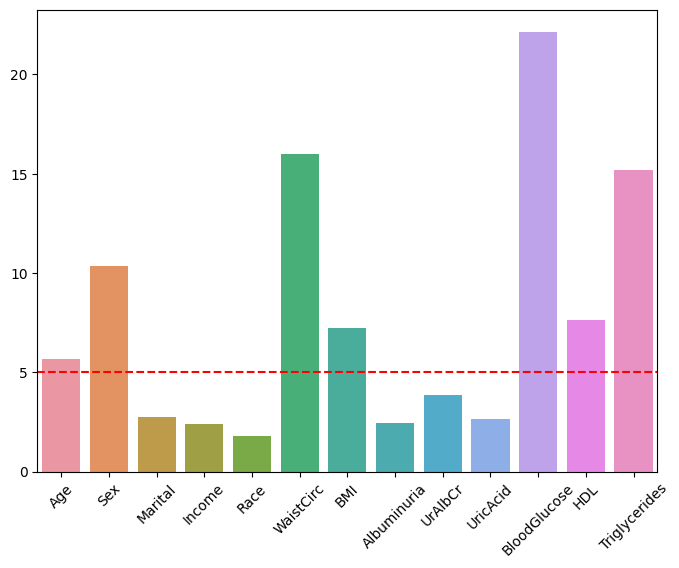

In [76]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(8,6))
plt.xticks(rotation=45)
plt.axhline(y=5, color='r', linestyle='--', label='Importance Threshold')
sns.barplot(x = x_train.columns,y = model.feature_importances_*100)

***Important Features*** based on **XBGClassifier**: based on percentages

* **'BloodGlucose'**

* **'Triglycerides'**

* **'WaistCirc'**

* **'BMI'**

* **'Sex'**

* **'HDL'**

* **'Age'**

---

## 2. Random Forest

In [77]:
from sklearn.ensemble import RandomForestClassifier

model = RandomForestClassifier()

model.fit(x_train, y_train)

y_pred = model.predict(x_test)
y_pred = (y_pred > 0.5).astype(int)

accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

model.feature_importances_*100

Accuracy: 0.8807212205270458


array([ 6.16733415,  2.52218168,  1.60994949,  3.09682751,  1.78835544,
       14.16277997,  9.97322464,  0.63973712,  5.27687781,  4.14553806,
       21.08880175, 11.16806349, 18.36032888])

<Axes: >

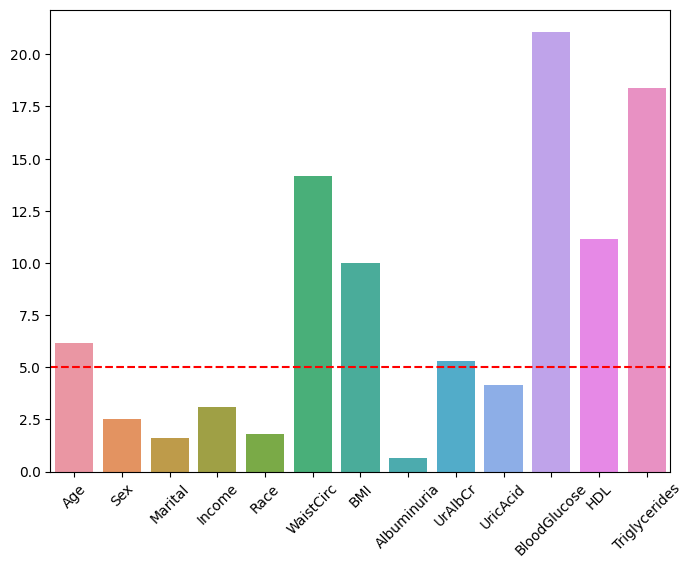

In [78]:
plt.figure(figsize=(8,6))
plt.xticks(rotation=45)
plt.axhline(y=5, color='r', linestyle='--', label='Importance Threshold')
sns.barplot(x = x_train.columns,y = model.feature_importances_*100)

***Important Features*** based on **RandomForestClassifier**: based on percentages

* **'Triglycerides'**

* **'BloodGlucose'**

* **'WaistCirc'**

* **'HDL'**

* **'BMI'**

* **'Age'**

* **'UrAlbCr'**

---

## 3. Decision Tree

In [93]:
from sklearn.tree import DecisionTreeClassifier

model = DecisionTreeClassifier()

model.fit(x_train, y_train)

y_pred = model.predict(x_test)
y_pred = (y_pred > 0.5).astype(int)

accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

model.feature_importances_*100

Accuracy: 0.8335644937586685


array([ 4.76364182,  2.99768815,  1.10844804,  3.8214706 ,  0.76316145,
       16.29150013,  4.11040215,  0.        ,  4.43083233,  2.5424555 ,
       28.74543734, 11.58407814, 18.84088434])

<Axes: >

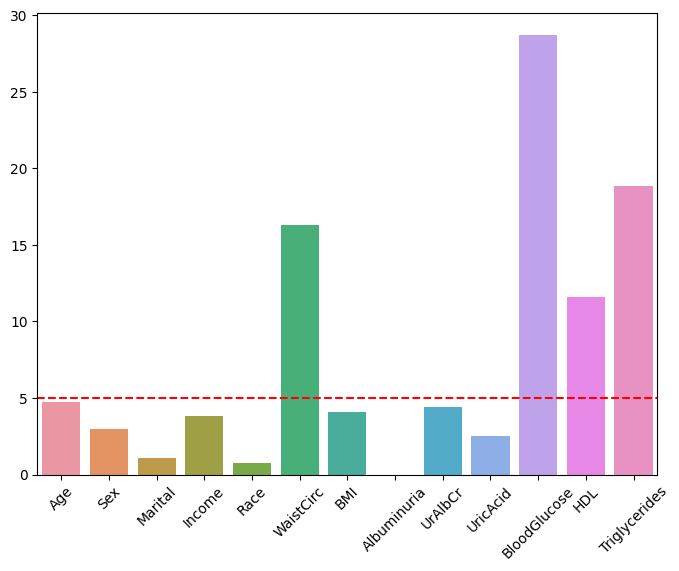

In [94]:
plt.figure(figsize=(8,6))
plt.xticks(rotation=45)
plt.axhline(y=5, color='r', linestyle='--', label='Importance Threshold')
sns.barplot(x = x_train.columns,y = model.feature_importances_*100)

***Important Features*** based on **DecisionTreeClassifier**: based on percentages

* **'Triglycerides'**

* **'BloodGlucose'**

* **'WaistCirc'**

* **'UrAlbCr'**

---

## 4. LGBM (Light Gradient Boosting model)

In [81]:
import lightgbm as lgb

model_params = {
    'objective': 'binary',
    'metric': 'binary_error',
    'num_leaves': 31,
    'learning_rate': 0.1,
    'feature_fraction': 0.8,
    'bagging_fraction': 0.8,
    'bagging_freq': 5,
    'verbose': -1
}

train_data = lgb.Dataset(x_train, label=y_train)
test_data = lgb.Dataset(x_test, label=y_test, reference=train_data)

num_round = 100
bst = lgb.train(model_params, train_data, num_round)

y_pred_proba = bst.predict(x_test)
y_pred = [1 if pred > 0.5 else 0 for pred in y_pred_proba]

accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

bst.feature_importance()

Accuracy: 0.8682385575589459


array([293,  94,  68, 176,  68, 413, 269,  14, 299, 295, 282, 368, 361])

<Axes: >

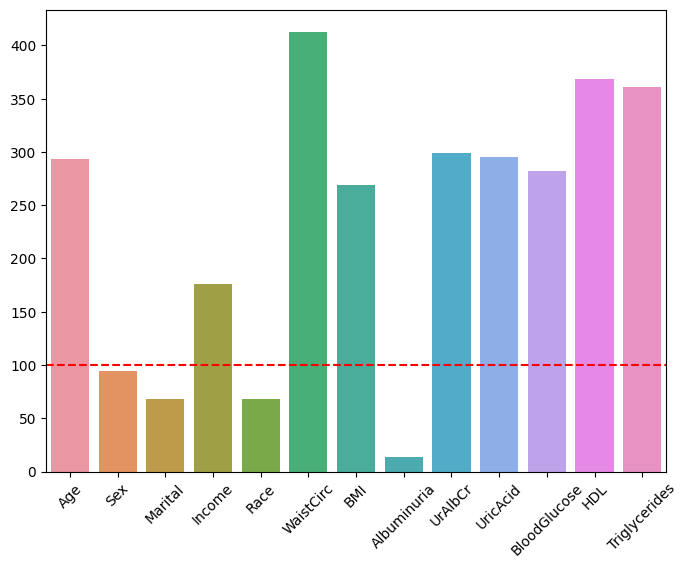

In [82]:
plt.figure(figsize=(8,6))
plt.xticks(rotation=45)
plt.axhline(y=100, color='r', linestyle='--', label='Importance Threshold')
sns.barplot(x = x_train.columns,y = bst.feature_importance())

***Important Features*** based on **LGBM**: based on count

* **'WaistCirc'**

* **'HDL'**

* **'Triglycerides'**

* **'BMI'**

* **'BloodGlucose'**

* **'UrAlbCr'**

* **'Age'**

* **'UricAcid'**

* **'Income'**

---

## 5. CatBoost (Categorical Boosting model)

In [83]:
from catboost import CatBoostClassifier

# Define model parameters
model_params = {
    'iterations': 100,
    'learning_rate': 0.1,
    'depth': 6,
    'subsample': 0.8,
    'colsample_bylevel': 0.8,
    'eval_metric': 'Accuracy',
}

# Initialize CatBoostClassifier
model = CatBoostClassifier(**model_params)

# Train the model
model.fit(x_train, y_train, eval_set=(x_test, y_test), verbose=False)

# Make predictions
y_pred = model.predict(x_test)
y_pred = (y_pred > 0.5).astype(int)

accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

model.feature_importances_

Accuracy: 0.8848821081830791


array([ 4.91577719, 13.5587441 ,  1.05211808,  1.3461468 ,  0.3936465 ,
       16.58412232,  3.47160018,  0.44732418,  2.36145291,  0.81280151,
       21.26862273, 16.85998451, 16.92765901])

<Axes: >

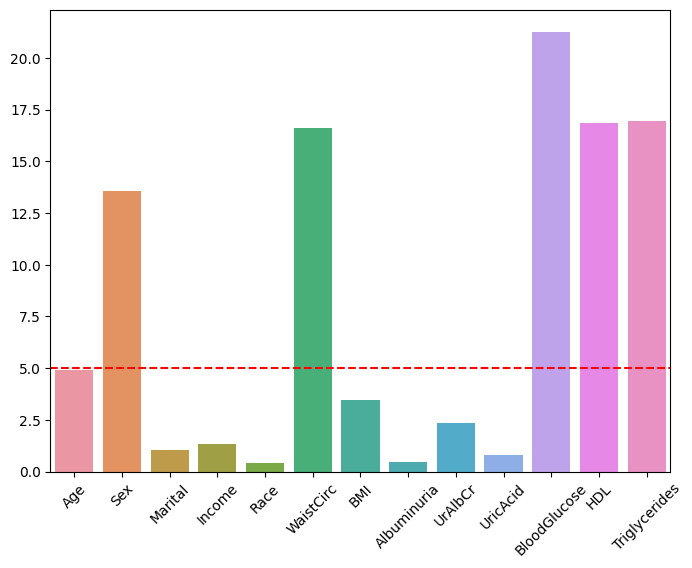

In [84]:
plt.figure(figsize=(8,6))
plt.xticks(rotation=45)
plt.axhline(y=5, color='r', linestyle='--', label='Importance Threshold')
sns.barplot(x = x_train.columns,y = model.feature_importances_)

***Important Features*** based on **CatBoostClassifier**: based on percentages 

* **'BloodGlucose'**

* **'Triglycerides'**

* **'WaistCirc'**

* **'HDL'**

* **'Sex'**

---

## 6. Extra Trees

In [85]:
from sklearn.ensemble import ExtraTreesClassifier

model = ExtraTreesClassifier()

model.fit(x_train, y_train)

y_pred = model.predict(x_test)
y_pred = (y_pred > 0.5).astype(int)

accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy:.4f}")

model.feature_importances_*100

Accuracy: 0.8516


array([ 7.87588426,  3.05869256,  3.55910983,  4.78860019,  3.85574076,
       13.78440556, 10.09374818,  1.67015006,  5.17729968,  6.14516898,
       13.83759421, 11.23011022, 14.9234955 ])

<Axes: >

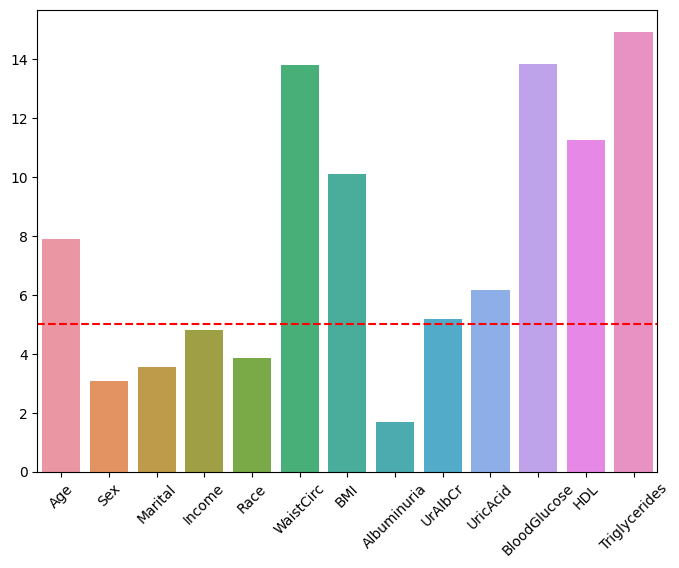

In [86]:
plt.figure(figsize=(8,6))
plt.xticks(rotation=45)
plt.axhline(y=5, color='r', linestyle='--', label='Importance Threshold')
sns.barplot(x = x_train.columns,y = model.feature_importances_*100)

***Important Features*** based on **ExtraTreesClassifier**: based on percentages 

* **'Triglycerides'**

* **'WaistCirc'**

* **'BloodGlucose'**

* **'HDL'**

* **'BMI'**

* **'Age'**

* **'UricAcid'**

* **'UrAlbCr'**

---

## 7. AdaBoost (Adaptive Boosting)

In [87]:
from sklearn.ensemble import AdaBoostClassifier

# Initialize CatBoostClassifier
model = AdaBoostClassifier()

# Train the model
model.fit(x_train, y_train)

# Make predictions
y_pred = model.predict(x_test)
y_pred = (y_pred > 0.5).astype(int)

accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

model.feature_importances_*100

Accuracy: 0.8682385575589459


array([10.,  6.,  2.,  2.,  0., 14., 10.,  0.,  4., 12., 18., 10., 12.])

<Axes: >

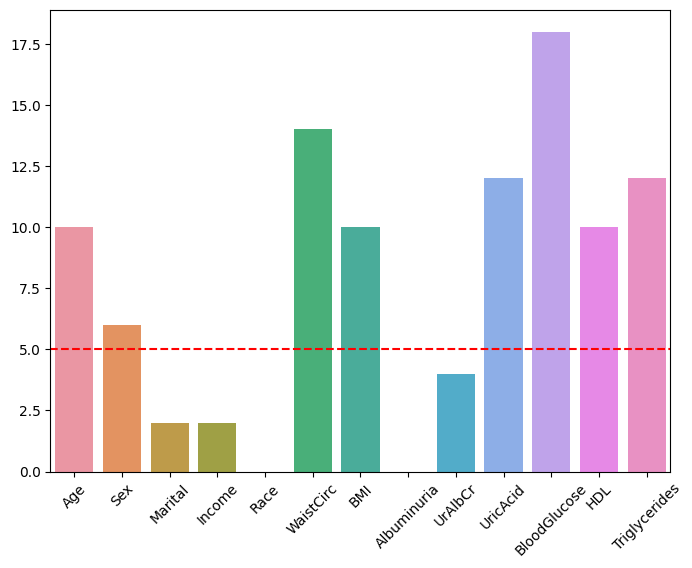

In [88]:
plt.figure(figsize=(8,6))
plt.xticks(rotation=45)
plt.axhline(y=5, color='r', linestyle='--', label='Importance Threshold')
sns.barplot(x = x_train.columns,y = model.feature_importances_*100)

***Important Features*** based on **AdaBoostClassifier**: based on percentages 

* **'Triglycerides'**

* **'BloodGlucose'**

* **'WaistCirc'**

* **'Age'**

* **'BMI'**

* **'Sex'**

* **'Income'**

* **'UrAlbCr'**

---

## 8. Gradient Boosting model

In [91]:
from sklearn.ensemble import GradientBoostingClassifier

model = GradientBoostingClassifier()

model.fit(x_train, y_train)

y_pred = model.predict(x_test)
y_pred = (y_pred > 0.5).astype(int)

accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

model.feature_importances_*100

Accuracy: 0.8779472954230236


array([ 2.33636143,  4.45864628,  0.24718341,  0.30719007,  0.16108625,
       19.1553376 ,  3.23450899,  0.03687309,  1.6609577 ,  0.78870594,
       34.87980522, 10.42812006, 22.30522396])

<Axes: >

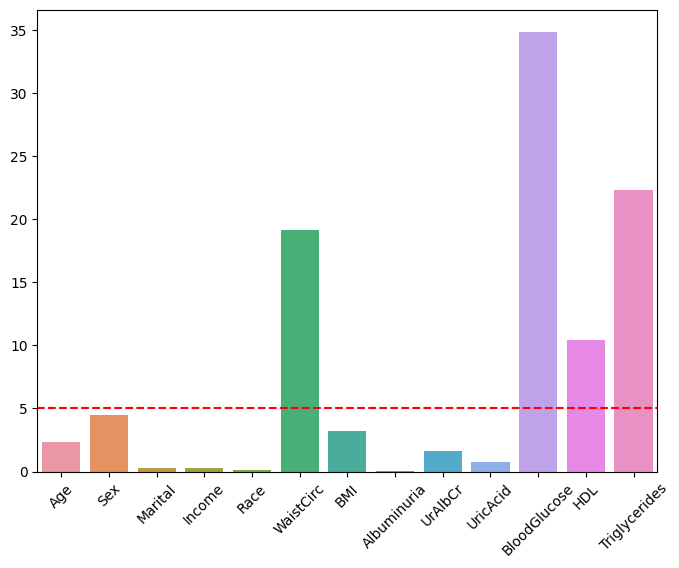

In [92]:
plt.figure(figsize=(8,6))
plt.xticks(rotation=45)
plt.axhline(y=5, color='r', linestyle='--', label='Importance Threshold')
sns.barplot(x = x_train.columns,y = model.feature_importances_*100)

***Important Features*** based on **GradientBoostingClassifier**: based on percentages

* **'Triglycerides'**

* **'BloodGlucose'**

* **'WaistCirc'**

* **'HDL'**

---

# Metabolic Syndrome Prediction | 5. Model prediction and evaluation

-> Write generic functions.

-> Use all features; no feature engineering (transformation, selection, extraction, dropping here)

-> Use both normalized and standardized data.

-> Use hyperparameter tuning for models.

-> Use some training strategy like LOSO or K-Fold.

-> Record time to find best params and time to train using those params.

->  on test data and print all eval metrics.

-> If it is binary classification, plot ROC to find optimal threshold.

-> Using that, plot Confusion matrix to evaluate the models.

-> Models to use: Extra Trees, SVM, Logistic, KNN, DT, RF, GB, Bagging Clf, XGB, Hist GB, MLP, Catboost, Adaboost, Naive Bayes, LightGBM

In [8]:
df = df.drop(columns=['seqn'],axis = 1)
x = df.copy().drop(columns=['MetabolicSyndrome'],axis = 1)
y = df.copy()['MetabolicSyndrome']

### Normalization

In [9]:
from sklearn.preprocessing import MinMaxScaler

def normal(x):
    scale = MinMaxScaler()
    x = scale.fit_transform(x)
    return x

### Standardization

In [10]:
from sklearn.preprocessing import StandardScaler

def standard(x):
    scale = StandardScaler()
    x = scale.fit_transform(x)
    return x

### Confusion Matrix

In [11]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

def plot_confusion_matrix(y_true, y_pred, labels):
    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicted labels')
    plt.ylabel('True labels')
    plt.title('Confusion Matrix')
    plt.show()

### ROC-AUC Curve

In [12]:
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt

def plot_roc_curve(y_true, y_pred):
    fpr, tpr, thresholds = roc_curve(y_true, y_pred)
    roc_auc = auc(fpr, tpr)
    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, color='blue', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
    plt.plot([0, 1], [0, 1], color='red', lw=2, linestyle='--', label='Random Guessing')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curve')
    plt.legend(loc="lower right")
    plt.show()


### XGB Classifier

#### Normalized data

In [13]:
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import xgboost as xgb
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

model = xgb.XGBClassifier(objective='binary:logistic', random_state=42)

param_grid = {
    'n_estimators': [10, 100, 200, 300],
    'max_depth': [3, 5, 7, 9],
    'learning_rate': [0.001 ,0.01, 0.1, 0.2]
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(normal(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)

print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(normal(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")

print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")

print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 65.83 seconds
Best Hyperparameters:
{'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100}

Time taken for training with best hyperparameters: 0.55 seconds

Mean Accuracy: 0.8929719917012449
Standard Deviation of Accuracy: 0.019204800762012475
Mean Precision: 0.8536406785721526
Standard Deviation of Precision: 0.04575450095491739
Mean Recall: 0.8334704672347929
Standard Deviation of Recall: 0.036909253444420316
Mean F1-score: 0.8422469002076811
Standard Deviation of F1-score: 0.02709928042621855
Mean ROC AUC: 0.87874845622483
Standard Deviation of ROC AUC: 0.019790047877786876

Total time taken: 66.39 seconds


In [14]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [15]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.8818635607321131
Precision: 0.8556149732620321
Recall: 0.7843137254901961
F1 Score: 0.8184143222506394
ROC AUC Score: 0.8581518249617227
Confusion Matrix:
[[370  27]
 [ 44 160]]


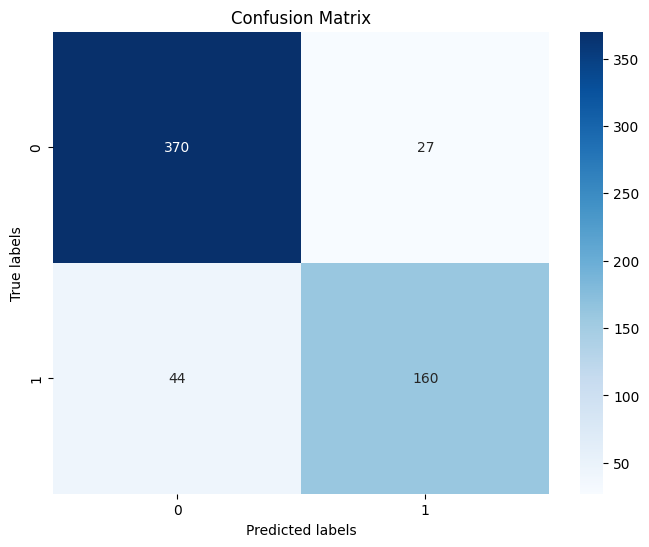

In [16]:
plot_confusion_matrix(y_test, y_pred,(0,1))

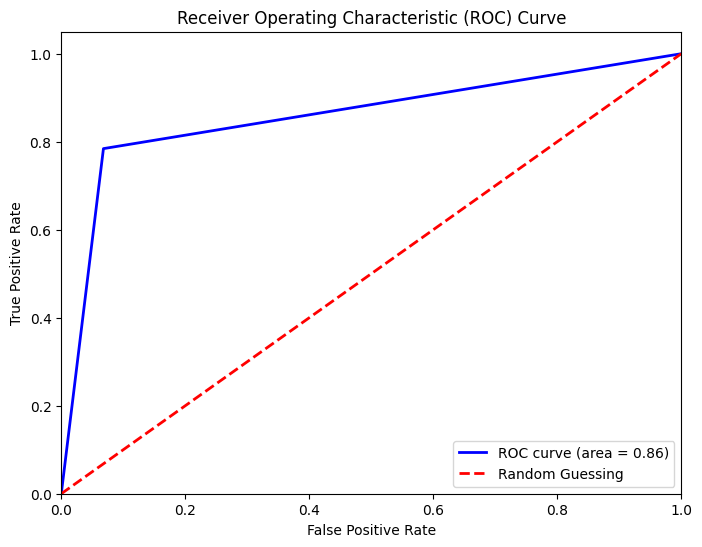

In [17]:
plot_roc_curve(y_test, y_pred)

#### Standardized data

In [18]:
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import xgboost as xgb
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

model = xgb.XGBClassifier(objective='binary:logistic', random_state=42)

param_grid = {
    'n_estimators': [10, 100, 200, 300],
    'max_depth': [3, 5, 7, 9],
    'learning_rate': [0.001 ,0.01, 0.1, 0.2]
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)

print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(standard(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")

print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")

print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 71.27 seconds
Best Hyperparameters:
{'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100}

Time taken for training with best hyperparameters: 0.54 seconds

Mean Accuracy: 0.8929719917012449
Standard Deviation of Accuracy: 0.019204800762012475
Mean Precision: 0.8536406785721526
Standard Deviation of Precision: 0.04575450095491739
Mean Recall: 0.8334704672347929
Standard Deviation of Recall: 0.036909253444420316
Mean F1-score: 0.8422469002076811
Standard Deviation of F1-score: 0.02709928042621855
Mean ROC AUC: 0.87874845622483
Standard Deviation of ROC AUC: 0.019790047877786876

Total time taken: 71.81 seconds


In [19]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [20]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.8818635607321131
Precision: 0.8556149732620321
Recall: 0.7843137254901961
F1 Score: 0.8184143222506394
ROC AUC Score: 0.8581518249617227
Confusion Matrix:
[[370  27]
 [ 44 160]]


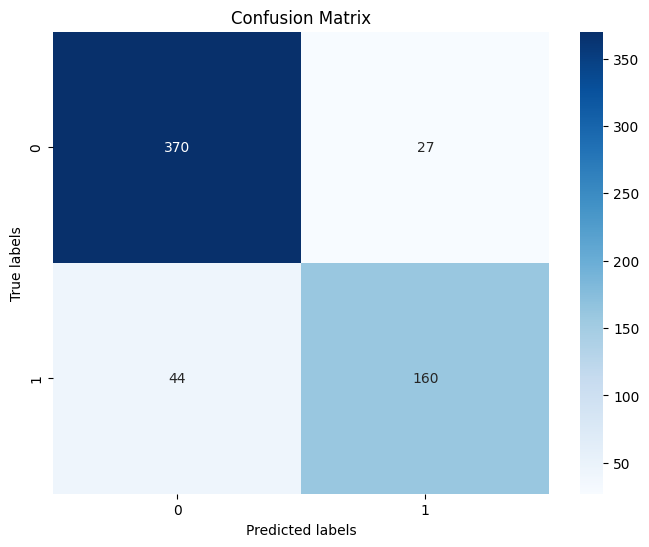

In [21]:
plot_confusion_matrix(y_test, y_pred,(0,1))

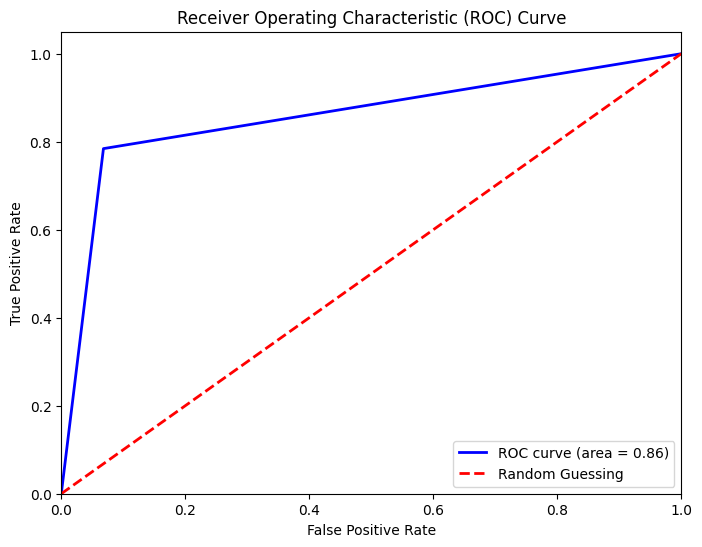

In [22]:
plot_roc_curve(y_test, y_pred)

### Random Forest Classifier

#### Normalized data

In [34]:
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
from sklearn.ensemble import RandomForestClassifier
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

model = RandomForestClassifier(random_state=42)

param_grid = {
    'n_estimators': [10, 100, 200, 300],
    'max_depth': [3, 5, 7, 9],
    'min_samples_split': [2, 5, 10, 20],
    'min_samples_leaf': [1, 2, 4, 8]
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)

print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(normal(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")

print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")

print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 2003.04 seconds
Best Hyperparameters:
{'max_depth': 9, 'min_samples_leaf': 4, 'min_samples_split': 10, 'n_estimators': 100}

Time taken for training with best hyperparameters: 6.53 seconds

Mean Accuracy: 0.8813087828492392
Standard Deviation of Accuracy: 0.01214538990720045
Mean Precision: 0.8452559083281921
Standard Deviation of Precision: 0.03425304225409793
Mean Recall: 0.803012048192771
Standard Deviation of Recall: 0.04535006930244235
Mean F1-score: 0.8221130376586311
Standard Deviation of F1-score: 0.0200200422445567
Mean ROC AUC: 0.8625678639738344
Standard Deviation of ROC AUC: 0.017119374173323314

Total time taken: 2009.57 seconds


In [35]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [36]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.8752079866888519
Precision: 0.8486486486486486
Recall: 0.7696078431372549
F1 Score: 0.8071979434447301
ROC AUC Score: 0.8495394379414234
Confusion Matrix:
[[369  28]
 [ 47 157]]


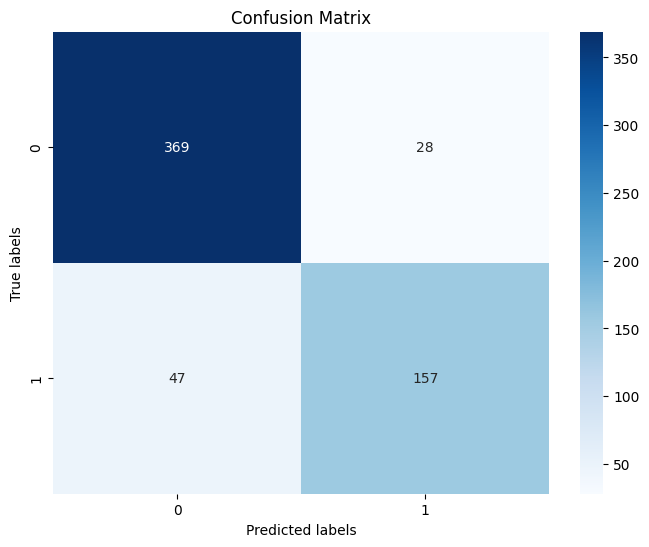

In [37]:
plot_confusion_matrix(y_test, y_pred,(0,1))

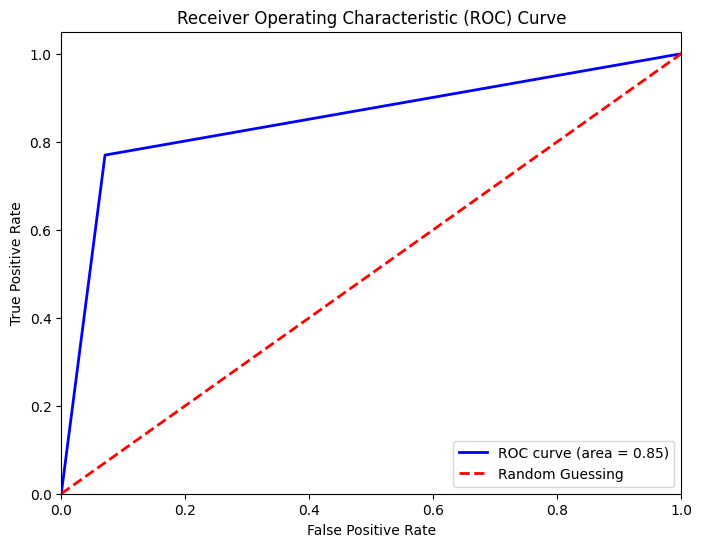

In [38]:
plot_roc_curve(y_test, y_pred)

#### Standardized data

In [39]:
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
from sklearn.ensemble import RandomForestClassifier
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

model = RandomForestClassifier(random_state=42)

param_grid = {
    'n_estimators': [10, 100, 200, 300],
    'max_depth': [3, 5, 7, 9],
    'min_samples_split': [2, 5, 10, 20],
    'min_samples_leaf': [1, 2, 4, 8]
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)

print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(standard(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")

print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")

print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 1033.21 seconds
Best Hyperparameters:
{'max_depth': 9, 'min_samples_leaf': 4, 'min_samples_split': 10, 'n_estimators': 100}

Time taken for training with best hyperparameters: 2.55 seconds

Mean Accuracy: 0.8813087828492392
Standard Deviation of Accuracy: 0.01214538990720045
Mean Precision: 0.8452559083281921
Standard Deviation of Precision: 0.03425304225409793
Mean Recall: 0.803012048192771
Standard Deviation of Recall: 0.04535006930244235
Mean F1-score: 0.8221130376586311
Standard Deviation of F1-score: 0.0200200422445567
Mean ROC AUC: 0.8625678639738344
Standard Deviation of ROC AUC: 0.017119374173323314

Total time taken: 1035.76 seconds


In [40]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [41]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.8752079866888519
Precision: 0.8486486486486486
Recall: 0.7696078431372549
F1 Score: 0.8071979434447301
ROC AUC Score: 0.8495394379414234
Confusion Matrix:
[[369  28]
 [ 47 157]]


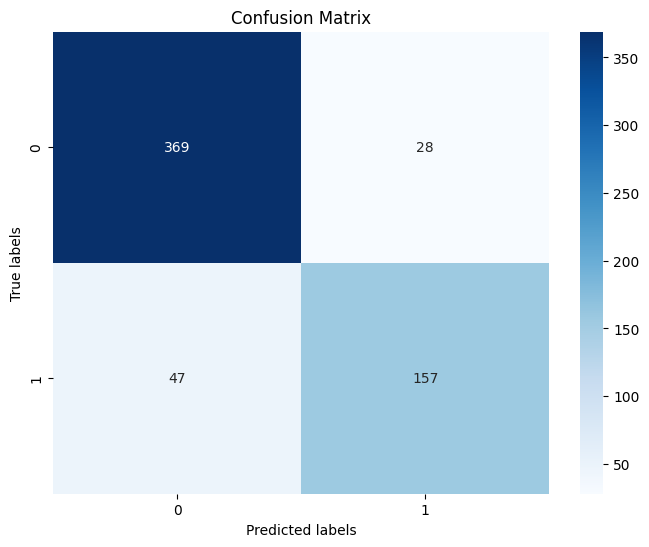

In [42]:
plot_confusion_matrix(y_test, y_pred,(0,1))

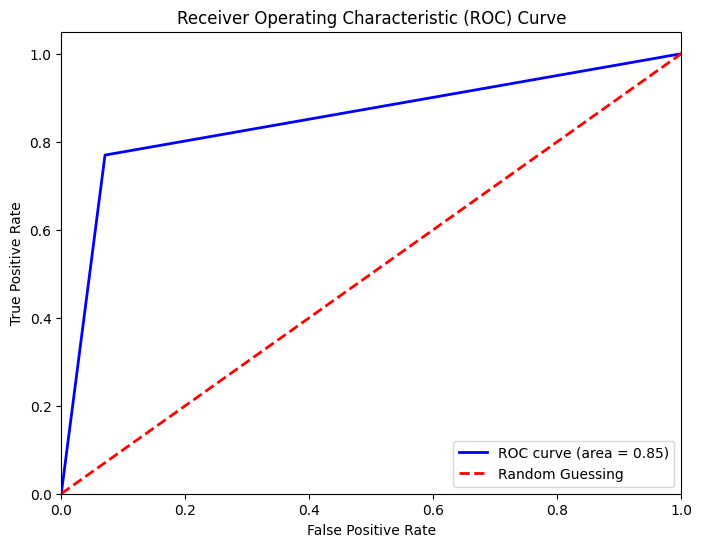

In [43]:
plot_roc_curve(y_test, y_pred)

### Decision Tree Classifier

#### Normalized data

In [44]:
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
from sklearn.tree import DecisionTreeClassifier
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

model = DecisionTreeClassifier(random_state=42)

param_grid = {
    'max_depth': [3, 5, 7, 9],
    'min_samples_split': [2, 5, 10, 20],
    'min_samples_leaf': [1, 2, 4, 8]
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)

print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(normal(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")

print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")

print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 4.40 seconds
Best Hyperparameters:
{'max_depth': 7, 'min_samples_leaf': 8, 'min_samples_split': 2}

Time taken for training with best hyperparameters: 0.13 seconds

Mean Accuracy: 0.8608869294605809
Standard Deviation of Accuracy: 0.016511376478853375
Mean Precision: 0.7850972759315583
Standard Deviation of Precision: 0.032983676813471315
Mean Recall: 0.8199970614163974
Standard Deviation of Recall: 0.024393912430473653
Mean F1-score: 0.8016412898878007
Standard Deviation of F1-score: 0.02102249397776493
Mean ROC AUC: 0.85110148966974
Standard Deviation of ROC AUC: 0.015713153472096633

Total time taken: 4.53 seconds


In [45]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [46]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.8635607321131448
Precision: 0.7961165048543689
Recall: 0.803921568627451
F1 Score: 0.8
ROC AUC Score: 0.8490640588729195
Confusion Matrix:
[[355  42]
 [ 40 164]]


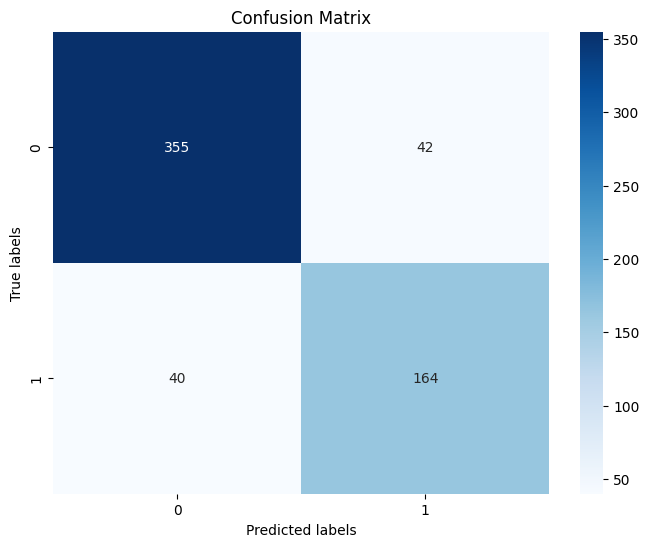

In [47]:
plot_confusion_matrix(y_test, y_pred,(0,1))

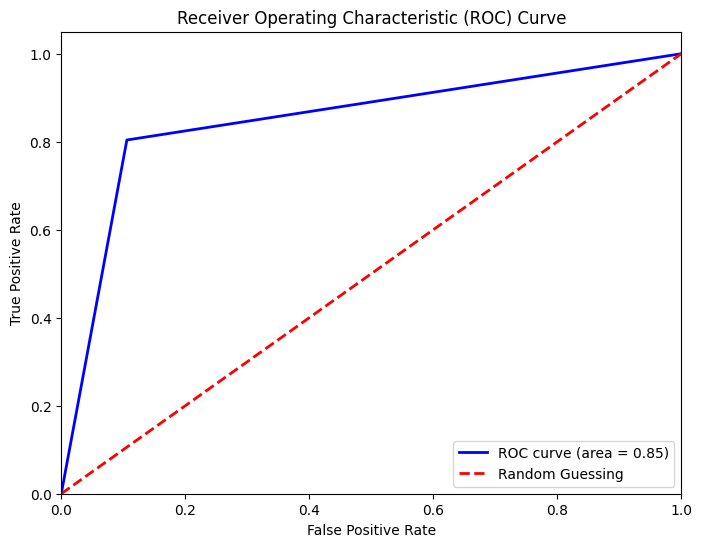

In [48]:
plot_roc_curve(y_test, y_pred)

#### Standardized data

In [49]:
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
from sklearn.tree import DecisionTreeClassifier
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

model = DecisionTreeClassifier(random_state=42)

param_grid = {
    'max_depth': [3, 5, 7, 9],
    'min_samples_split': [2, 5, 10, 20],
    'min_samples_leaf': [1, 2, 4, 8]
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)

print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(standard(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")

print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")

print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 4.38 seconds
Best Hyperparameters:
{'max_depth': 7, 'min_samples_leaf': 8, 'min_samples_split': 2}

Time taken for training with best hyperparameters: 0.13 seconds

Mean Accuracy: 0.8608869294605809
Standard Deviation of Accuracy: 0.016511376478853375
Mean Precision: 0.7850972759315583
Standard Deviation of Precision: 0.032983676813471315
Mean Recall: 0.8199970614163974
Standard Deviation of Recall: 0.024393912430473653
Mean F1-score: 0.8016412898878007
Standard Deviation of F1-score: 0.02102249397776493
Mean ROC AUC: 0.85110148966974
Standard Deviation of ROC AUC: 0.015713153472096633

Total time taken: 4.51 seconds


In [50]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [51]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.8635607321131448
Precision: 0.7961165048543689
Recall: 0.803921568627451
F1 Score: 0.8
ROC AUC Score: 0.8490640588729195
Confusion Matrix:
[[355  42]
 [ 40 164]]


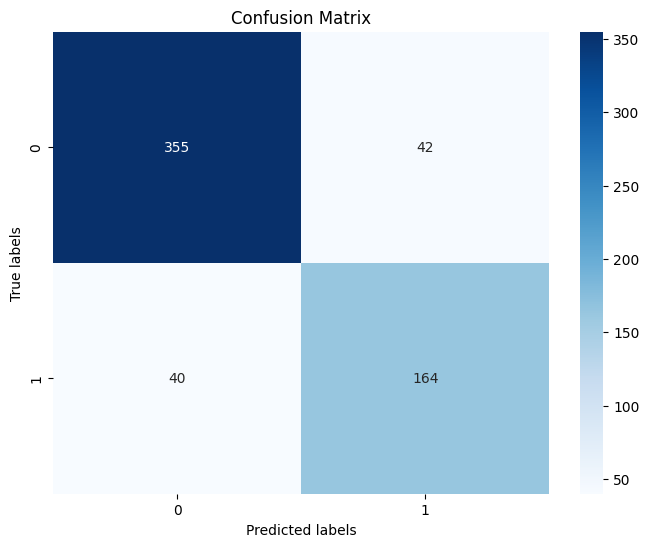

In [52]:
plot_confusion_matrix(y_test, y_pred,(0,1))

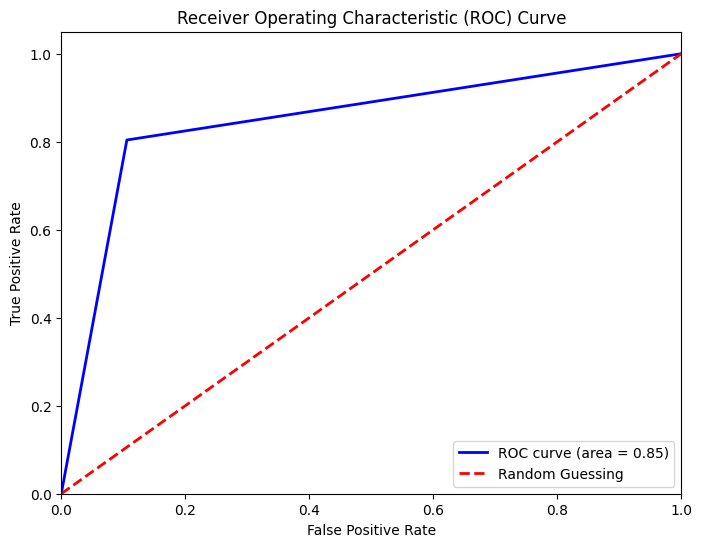

In [53]:
plot_roc_curve(y_test, y_pred)

### AdaBoost Classifier

#### Normalized data

In [54]:
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
from sklearn.ensemble import AdaBoostClassifier
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

model = AdaBoostClassifier(random_state=42)

param_grid = {
    'n_estimators': [50, 100, 200, 300],
    'learning_rate': [0.001, 0.01, 0.1, 1.0],
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)

print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(normal(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")

print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")

print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 69.67 seconds
Best Hyperparameters:
{'learning_rate': 1.0, 'n_estimators': 50}

Time taken for training with best hyperparameters: 1.45 seconds

Mean Accuracy: 0.8725518672199171
Standard Deviation of Accuracy: 0.01505564468446939
Mean Precision: 0.8250753635467897
Standard Deviation of Precision: 0.034854579117856006
Mean Recall: 0.7993682045254188
Standard Deviation of Recall: 0.03559043605914592
Mean F1-score: 0.8110587433534212
Standard Deviation of F1-score: 0.02163467149022446
Mean ROC AUC: 0.8550436926843814
Standard Deviation of ROC AUC: 0.01703657894997193

Total time taken: 71.13 seconds


In [55]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [56]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.8618968386023295
Precision: 0.8134715025906736
Recall: 0.7696078431372549
F1 Score: 0.7909319899244333
ROC AUC Score: 0.8394638711907938
Confusion Matrix:
[[361  36]
 [ 47 157]]


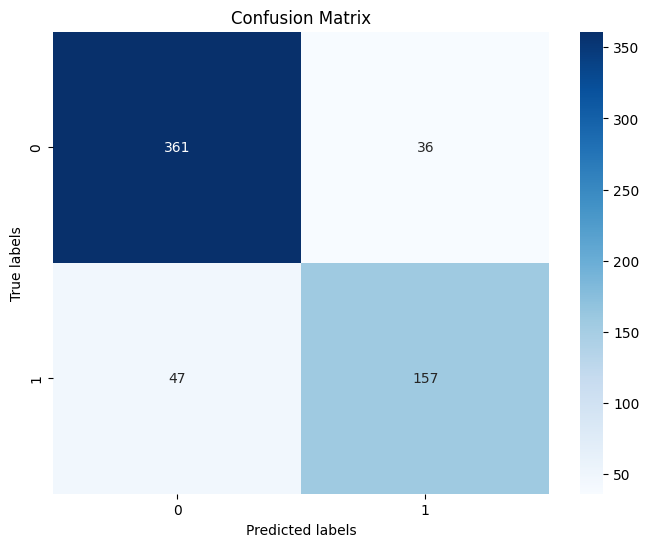

In [57]:
plot_confusion_matrix(y_test, y_pred,(0,1))

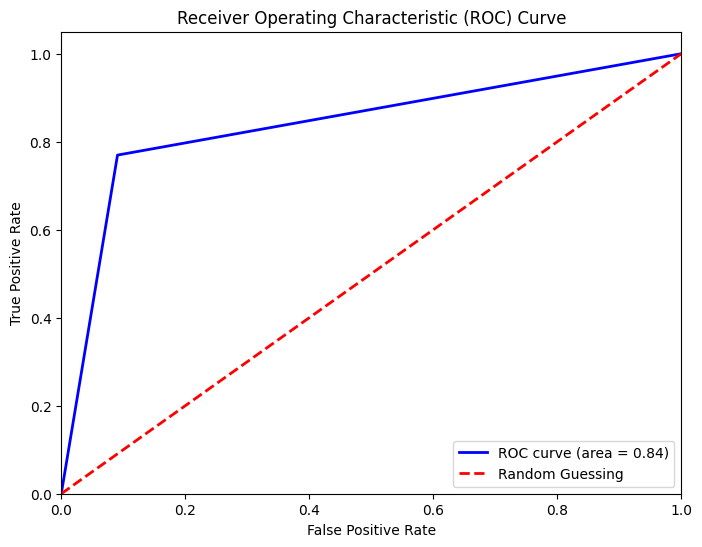

In [58]:
plot_roc_curve(y_test, y_pred)

#### Standardized data

In [59]:
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
from sklearn.ensemble import AdaBoostClassifier
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

model = AdaBoostClassifier(random_state=42)

param_grid = {
    'n_estimators': [50, 100, 200, 300],
    'learning_rate': [0.001, 0.01, 0.1, 1.0],
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)

print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(standard(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")

print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")

print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 70.49 seconds
Best Hyperparameters:
{'learning_rate': 1.0, 'n_estimators': 50}

Time taken for training with best hyperparameters: 1.45 seconds

Mean Accuracy: 0.8725518672199171
Standard Deviation of Accuracy: 0.01505564468446939
Mean Precision: 0.8250753635467897
Standard Deviation of Precision: 0.034854579117856006
Mean Recall: 0.7993682045254188
Standard Deviation of Recall: 0.03559043605914592
Mean F1-score: 0.8110587433534212
Standard Deviation of F1-score: 0.02163467149022446
Mean ROC AUC: 0.8550436926843814
Standard Deviation of ROC AUC: 0.01703657894997193

Total time taken: 71.94 seconds


In [60]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [61]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.8618968386023295
Precision: 0.8134715025906736
Recall: 0.7696078431372549
F1 Score: 0.7909319899244333
ROC AUC Score: 0.8394638711907938
Confusion Matrix:
[[361  36]
 [ 47 157]]


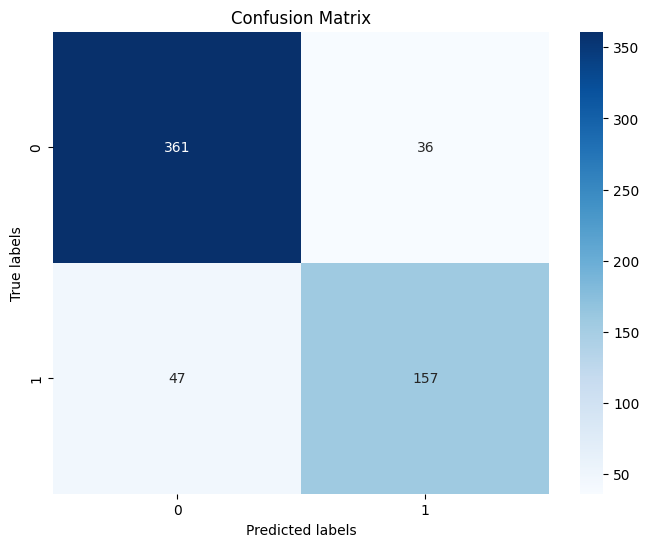

In [62]:
plot_confusion_matrix(y_test, y_pred,(0,1))

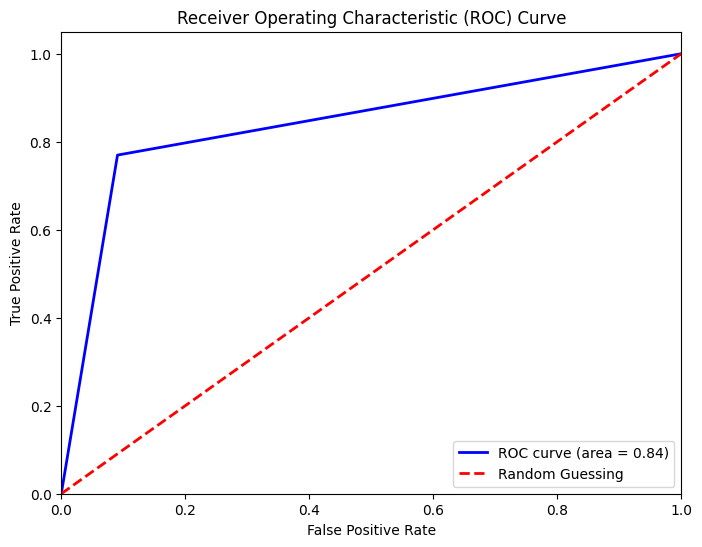

In [63]:
plot_roc_curve(y_test, y_pred)

### LGBM Classifier

#### Normalized data

In [64]:
import lightgbm as lgb
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

model = lgb.LGBMClassifier(random_state=42)

param_grid = {
    'n_estimators': [50, 100, 200, 300],
    'learning_rate': [0.001, 0.01, 0.1, 1.0],
    'num_leaves': [31, 50, 100],
    'boosting_type': ['gbdt', 'dart', 'goss'],
    'objective': ['binary']
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)
print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(normal(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")
print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")
print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

[LightGBM] [Info] Number of positive: 739, number of negative: 1421
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000358 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1395
[LightGBM] [Info] Number of data points in the train set: 2160, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.342130 -> initscore=-0.653818
[LightGBM] [Info] Start training from score -0.653818
[LightGBM] [Info] Number of positive: 740, number of negative: 1421
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000160 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1395
[LightGBM] [Info] Number of data points in the train set: 2161, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.342434 -> initscore=-0.652466
[LightGBM] [Info] Start training from score -0.652466
[LightGBM] [In

In [65]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [66]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 618, number of negative: 1182
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000195 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1379
[LightGBM] [Info] Number of data points in the train set: 1800, number of used features: 13
[LightGBM] [Info] Using GOSS
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.343333 -> initscore=-0.648475
[LightGBM] [Info] Start training from score -0.648475
[LightGBM] [Warning] No further splits with positive

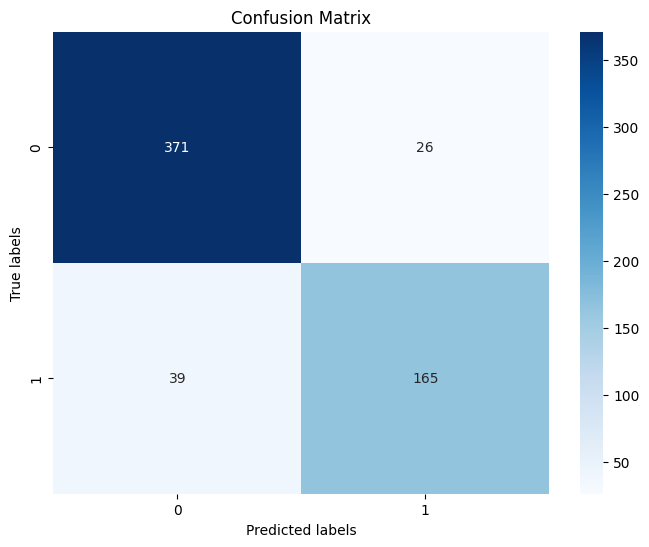

In [67]:
plot_confusion_matrix(y_test, y_pred,(0,1))

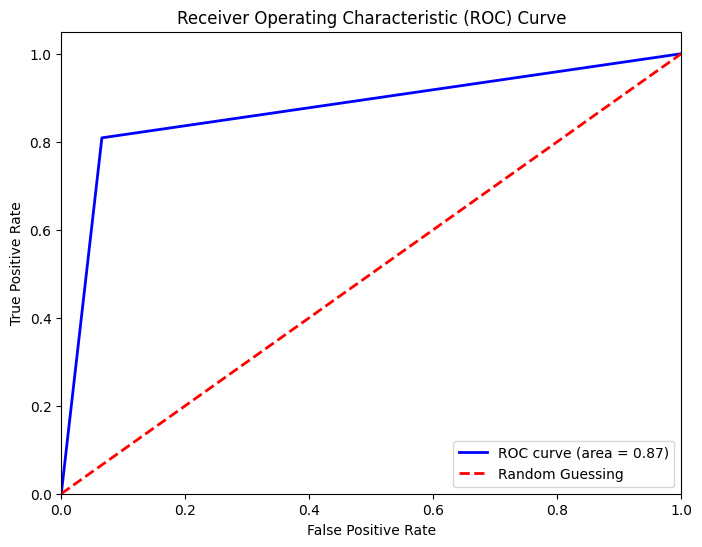

In [68]:
plot_roc_curve(y_test, y_pred)

#### Standardized data

In [69]:
import lightgbm as lgb
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

model = lgb.LGBMClassifier(random_state=42)

param_grid = {
    'n_estimators': [50, 100, 200, 300],
    'learning_rate': [0.001, 0.01, 0.1, 1.0],
    'num_leaves': [31, 50, 100],
    'boosting_type': ['gbdt', 'dart', 'goss'],
    'objective': ['binary']
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)
print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(standard(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")
print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")
print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

[LightGBM] [Info] Number of positive: 739, number of negative: 1421
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000135 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1395
[LightGBM] [Info] Number of data points in the train set: 2160, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.342130 -> initscore=-0.653818
[LightGBM] [Info] Start training from score -0.653818
[LightGBM] [Info] Number of positive: 740, number of negative: 1421
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000110 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1395
[LightGBM] [Info] Number of data points in the train set: 2161, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.342434 -> initscore=-0.652466
[LightGBM] [Info] Start training from score -0.652466
[LightGBM] [In

In [70]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [71]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 618, number of negative: 1182
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000159 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1379
[LightGBM] [Info] Number of data points in the train set: 1800, number of used features: 13
[LightGBM] [Info] Using GOSS
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.343333 -> initscore=-0.648475
[LightGBM] [Info] Start training from score -0.648475
[LightGBM] [Warning] No further splits with positive

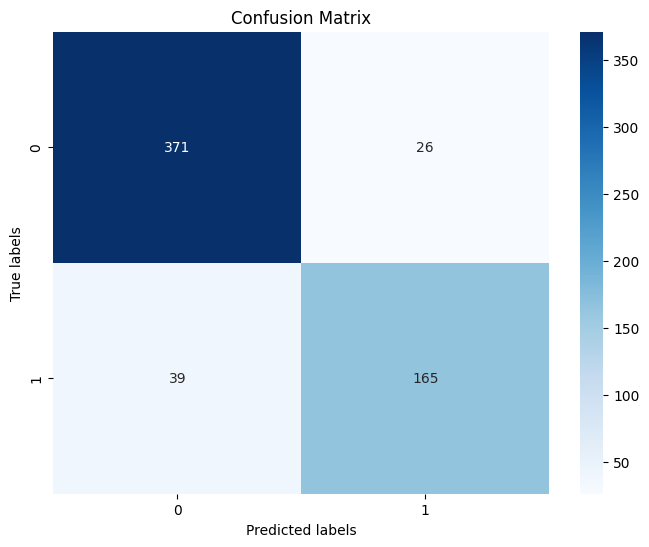

In [72]:
plot_confusion_matrix(y_test, y_pred,(0,1))

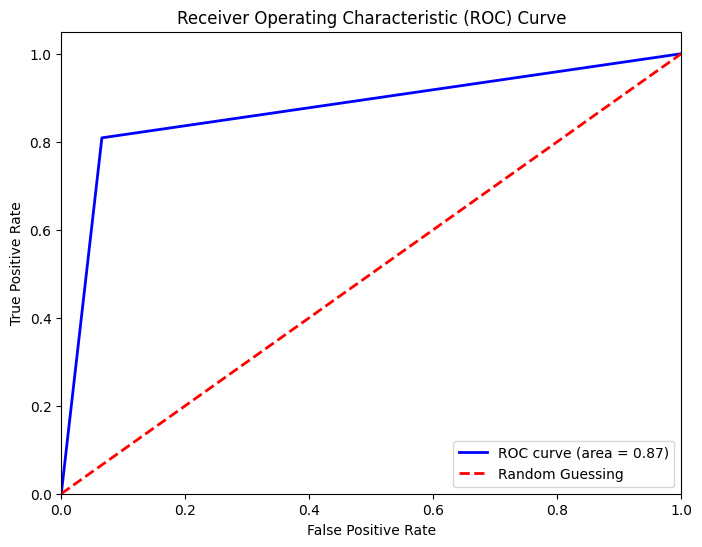

In [73]:
plot_roc_curve(y_test, y_pred)

### Logistic Regression

#### Normalized data

In [74]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

model = LogisticRegression(random_state=42, max_iter=10000)

param_grid = {
    'C': [0.01, 0.1, 1.0, 10.0, 100.0],
    'penalty': ['l1', 'l2', 'elasticnet', 'none'],
    'solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga']
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)
print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(normal(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")
print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")
print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 8.95 seconds
Best Hyperparameters:
{'C': 0.1, 'penalty': 'l1', 'solver': 'liblinear'}

Time taken for training with best hyperparameters: 0.41 seconds

Mean Accuracy: 0.8384128630705394
Standard Deviation of Accuracy: 0.028894090640005768
Mean Precision: 0.8072888487396828
Standard Deviation of Precision: 0.05501713449858519
Mean Recall: 0.6959006758742285
Standard Deviation of Recall: 0.044346578351324335
Mean F1-score: 0.7468449823208363
Standard Deviation of F1-score: 0.044247964137423254
Mean ROC AUC: 0.8042572798060169
Standard Deviation of ROC AUC: 0.03134731656993271

Total time taken: 9.36 seconds


In [75]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [76]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.8202995008319468
Precision: 0.7637362637362637
Recall: 0.6813725490196079
F1 Score: 0.7202072538860105
ROC AUC Score: 0.7865301032251691
Confusion Matrix:
[[354  43]
 [ 65 139]]


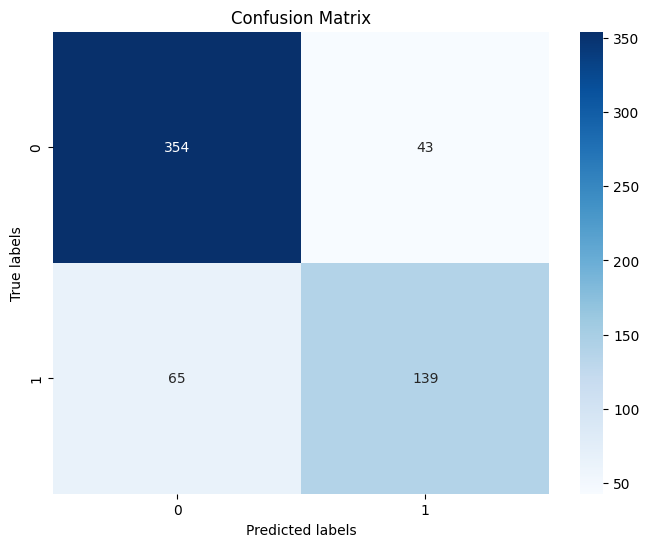

In [77]:
plot_confusion_matrix(y_test, y_pred,(0,1))

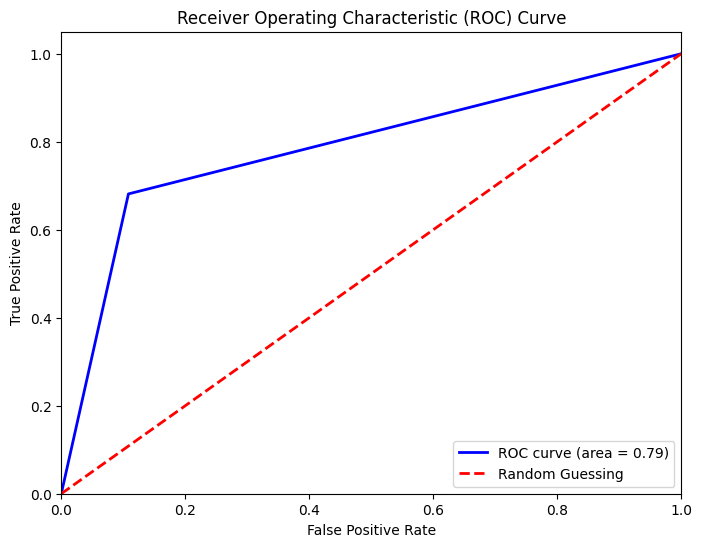

In [78]:
plot_roc_curve(y_test, y_pred)

#### Standardized data

In [79]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

model = LogisticRegression(random_state=42, max_iter=10000)

param_grid = {
    'C': [0.01, 0.1, 1.0, 10.0, 100.0],
    'penalty': ['l1', 'l2', 'elasticnet', 'none'],
    'solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga']
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)
print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(standard(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")
print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")
print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 8.59 seconds
Best Hyperparameters:
{'C': 0.1, 'penalty': 'l1', 'solver': 'liblinear'}

Time taken for training with best hyperparameters: 0.40 seconds

Mean Accuracy: 0.8384128630705394
Standard Deviation of Accuracy: 0.028894090640005768
Mean Precision: 0.8072888487396828
Standard Deviation of Precision: 0.05501713449858519
Mean Recall: 0.6959006758742285
Standard Deviation of Recall: 0.044346578351324335
Mean F1-score: 0.7468449823208363
Standard Deviation of F1-score: 0.044247964137423254
Mean ROC AUC: 0.8042572798060169
Standard Deviation of ROC AUC: 0.03134731656993271

Total time taken: 8.99 seconds


In [80]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [81]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.8202995008319468
Precision: 0.7637362637362637
Recall: 0.6813725490196079
F1 Score: 0.7202072538860105
ROC AUC Score: 0.7865301032251691
Confusion Matrix:
[[354  43]
 [ 65 139]]


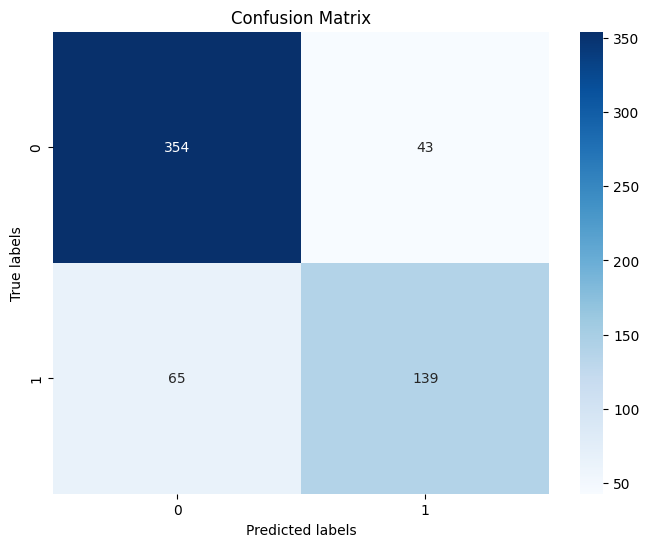

In [82]:
plot_confusion_matrix(y_test, y_pred,(0,1))

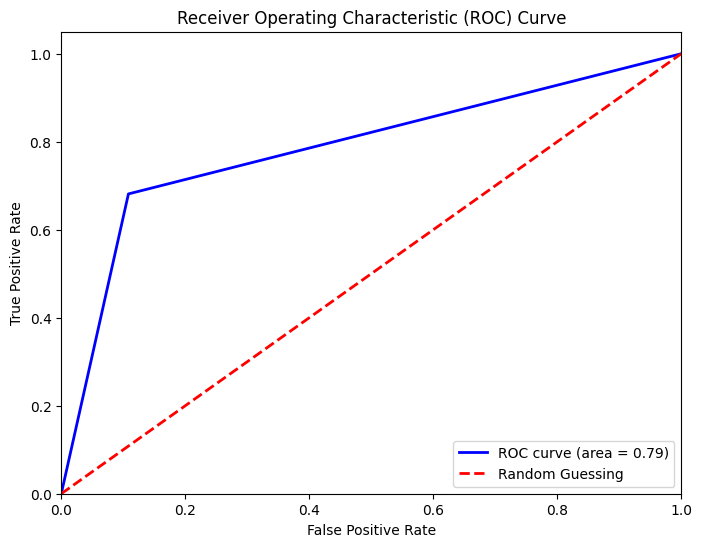

In [83]:
plot_roc_curve(y_test, y_pred)

### Extra Trees Classifier

#### Normalized data

In [84]:
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

model = ExtraTreesClassifier(random_state=42)

param_grid = {
    'n_estimators': [50, 100, 200, 300],
    'max_features': ['auto', 'sqrt', 'log2'],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [False, True]
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)
print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(normal(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")
print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")
print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 5238.62 seconds
Best Hyperparameters:
{'bootstrap': False, 'max_depth': 20, 'max_features': 'auto', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 200}

Time taken for training with best hyperparameters: 8.81 seconds

Mean Accuracy: 0.8688053250345782
Standard Deviation of Accuracy: 0.010735381485841083
Mean Precision: 0.8494329073603002
Standard Deviation of Precision: 0.020013245857135986
Mean Recall: 0.7505730238025272
Standard Deviation of Recall: 0.03768985217905668
Mean F1-score: 0.7962051072925098
Standard Deviation of F1-score: 0.02080232554736884
Mean ROC AUC: 0.8404562289052141
Standard Deviation of ROC AUC: 0.016286438216473118

Total time taken: 5247.43 seconds


In [85]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [86]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.8535773710482529
Precision: 0.8152173913043478
Recall: 0.7352941176470589
F1 Score: 0.7731958762886598
ROC AUC Score: 0.8248259001333531
Confusion Matrix:
[[363  34]
 [ 54 150]]


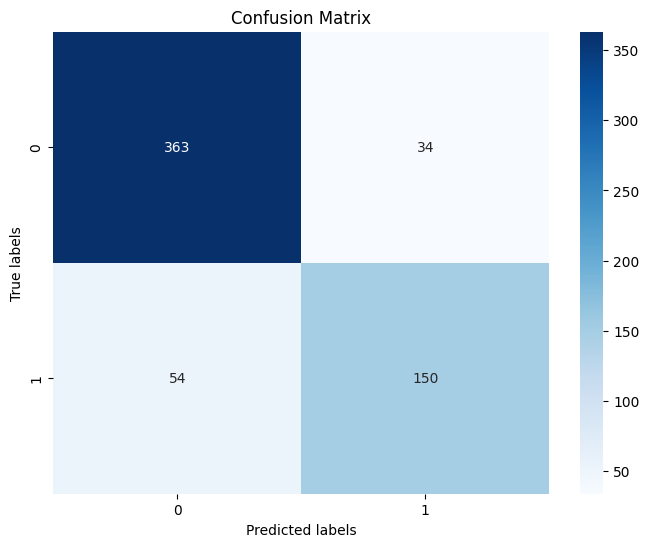

In [87]:
plot_confusion_matrix(y_test, y_pred,(0,1))

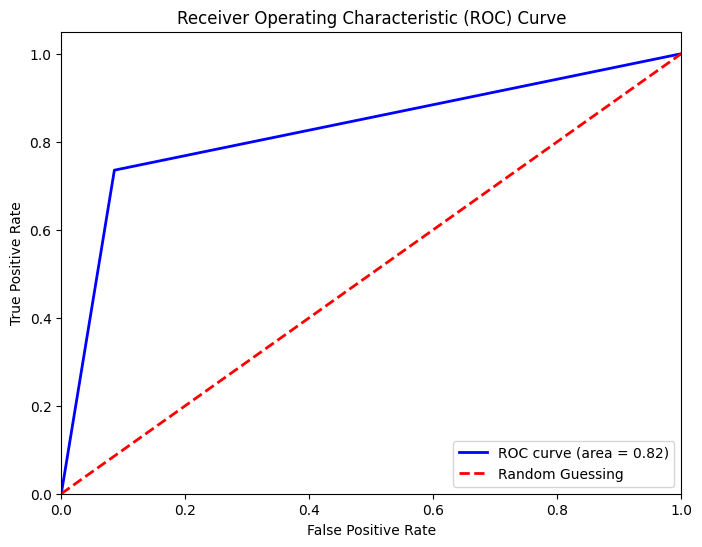

In [88]:
plot_roc_curve(y_test, y_pred)

#### Standardized data

In [89]:
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

model = ExtraTreesClassifier(random_state=42)

param_grid = {
    'n_estimators': [50, 100, 200, 300],
    'max_features': ['auto', 'sqrt', 'log2'],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [False, True]
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)
print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(standard(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")
print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")
print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 5071.93 seconds
Best Hyperparameters:
{'bootstrap': False, 'max_depth': 20, 'max_features': 'auto', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 200}

Time taken for training with best hyperparameters: 4.07 seconds

Mean Accuracy: 0.8688053250345782
Standard Deviation of Accuracy: 0.010735381485841083
Mean Precision: 0.8494329073603002
Standard Deviation of Precision: 0.020013245857135986
Mean Recall: 0.7505730238025272
Standard Deviation of Recall: 0.03768985217905668
Mean F1-score: 0.7962051072925098
Standard Deviation of F1-score: 0.02080232554736884
Mean ROC AUC: 0.8404562289052141
Standard Deviation of ROC AUC: 0.016286438216473118

Total time taken: 5076.00 seconds


In [90]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [91]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.8535773710482529
Precision: 0.8152173913043478
Recall: 0.7352941176470589
F1 Score: 0.7731958762886598
ROC AUC Score: 0.8248259001333531
Confusion Matrix:
[[363  34]
 [ 54 150]]


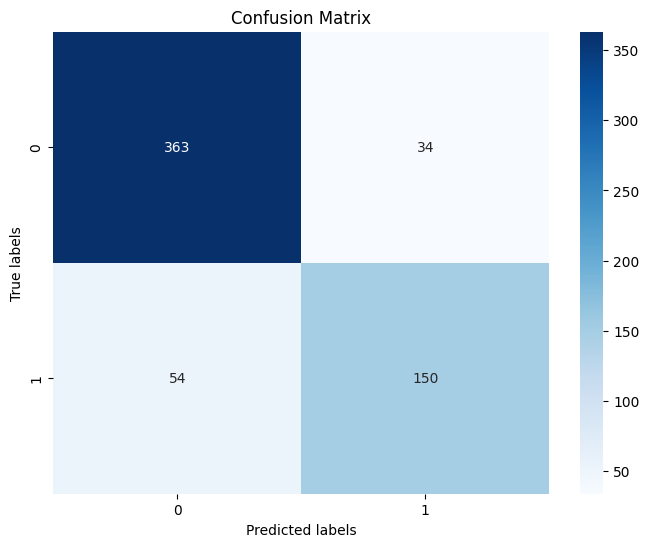

In [92]:
plot_confusion_matrix(y_test, y_pred,(0,1))

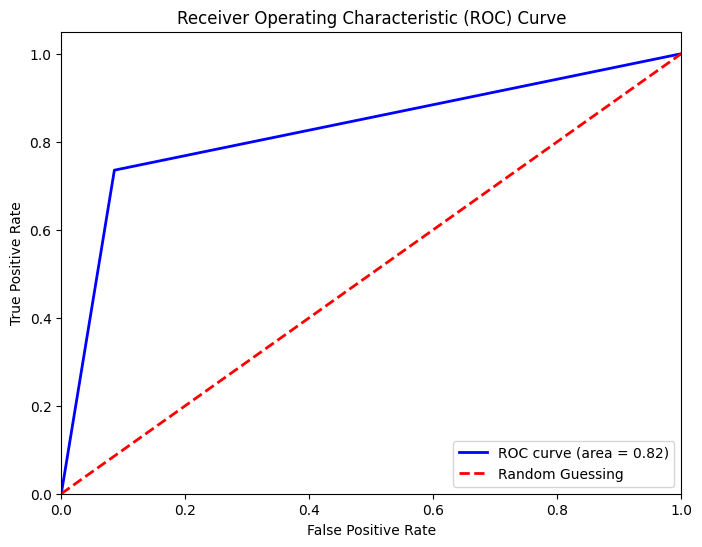

In [93]:
plot_roc_curve(y_test, y_pred)

### Histogram Gradient Boosting Classifier

#### Normalized data

In [94]:
from sklearn.ensemble import HistGradientBoostingClassifier
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

model = HistGradientBoostingClassifier(random_state=42)

param_grid = {
    'learning_rate': [0.01, 0.1, 0.2, 0.3],
    'max_iter': [100, 200, 300],
    'max_leaf_nodes': [31, 63, 127],
    'min_samples_leaf': [20, 50, 100],
    'l2_regularization': [0.0, 0.1, 1.0]
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)
print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(normal(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")
print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")
print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 2489.42 seconds
Best Hyperparameters:
{'l2_regularization': 0.1, 'learning_rate': 0.1, 'max_iter': 100, 'max_leaf_nodes': 31, 'min_samples_leaf': 100}

Time taken for training with best hyperparameters: 2.52 seconds

Mean Accuracy: 0.8917202627939143
Standard Deviation of Accuracy: 0.014477507951668005
Mean Precision: 0.84451676345978
Standard Deviation of Precision: 0.034358682865536075
Mean Recall: 0.840772847487511
Standard Deviation of Recall: 0.03791815161028012
Mean F1-score: 0.8416215259346306
Standard Deviation of F1-score: 0.021308529266832795
Mean ROC AUC: 0.879545498161235
Standard Deviation of ROC AUC: 0.0169850947707784

Total time taken: 2491.94 seconds


In [95]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [96]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.8951747088186356
Precision: 0.8691099476439791
Recall: 0.8137254901960784
F1 Score: 0.8405063291139241
ROC AUC Score: 0.8753765990023213
Confusion Matrix:
[[372  25]
 [ 38 166]]


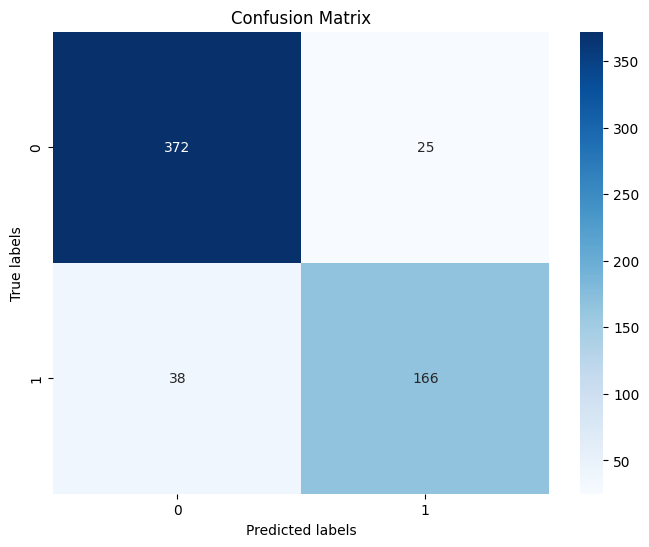

In [97]:
plot_confusion_matrix(y_test, y_pred,(0,1))

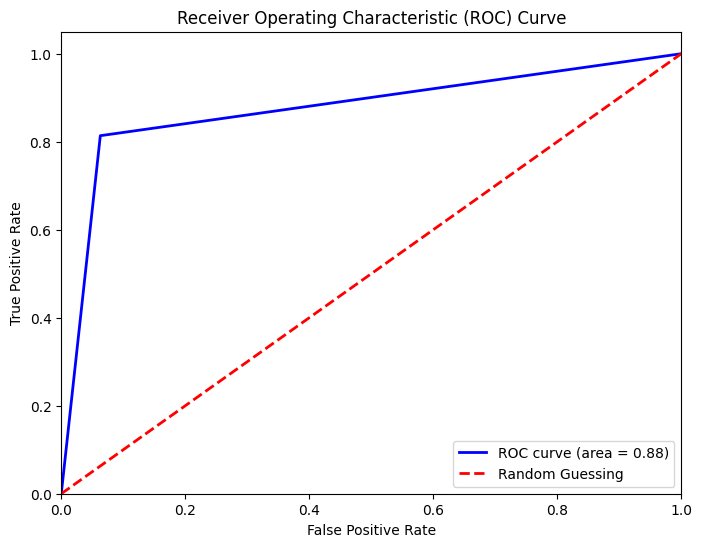

In [98]:
plot_roc_curve(y_test, y_pred)

#### Standardized data

In [99]:
from sklearn.ensemble import HistGradientBoostingClassifier
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

model = HistGradientBoostingClassifier(random_state=42)

param_grid = {
    'learning_rate': [0.01, 0.1, 0.2, 0.3],
    'max_iter': [100, 200, 300],
    'max_leaf_nodes': [31, 63, 127],
    'min_samples_leaf': [20, 50, 100],
    'l2_regularization': [0.0, 0.1, 1.0]
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)
print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(standard(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")
print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")
print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 4164.99 seconds
Best Hyperparameters:
{'l2_regularization': 0.1, 'learning_rate': 0.1, 'max_iter': 100, 'max_leaf_nodes': 31, 'min_samples_leaf': 100}

Time taken for training with best hyperparameters: 4.97 seconds

Mean Accuracy: 0.8917202627939143
Standard Deviation of Accuracy: 0.014477507951668005
Mean Precision: 0.84451676345978
Standard Deviation of Precision: 0.034358682865536075
Mean Recall: 0.840772847487511
Standard Deviation of Recall: 0.03791815161028012
Mean F1-score: 0.8416215259346306
Standard Deviation of F1-score: 0.021308529266832795
Mean ROC AUC: 0.879545498161235
Standard Deviation of ROC AUC: 0.0169850947707784

Total time taken: 4169.96 seconds


In [100]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [101]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.8951747088186356
Precision: 0.8691099476439791
Recall: 0.8137254901960784
F1 Score: 0.8405063291139241
ROC AUC Score: 0.8753765990023213
Confusion Matrix:
[[372  25]
 [ 38 166]]


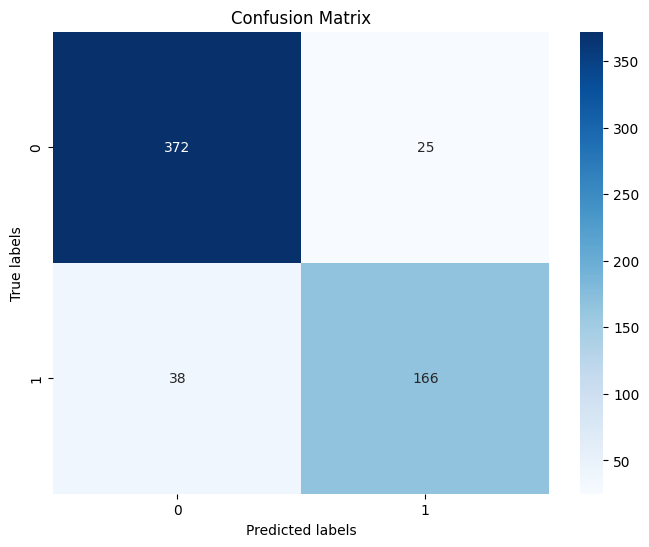

In [102]:
plot_confusion_matrix(y_test, y_pred,(0,1))

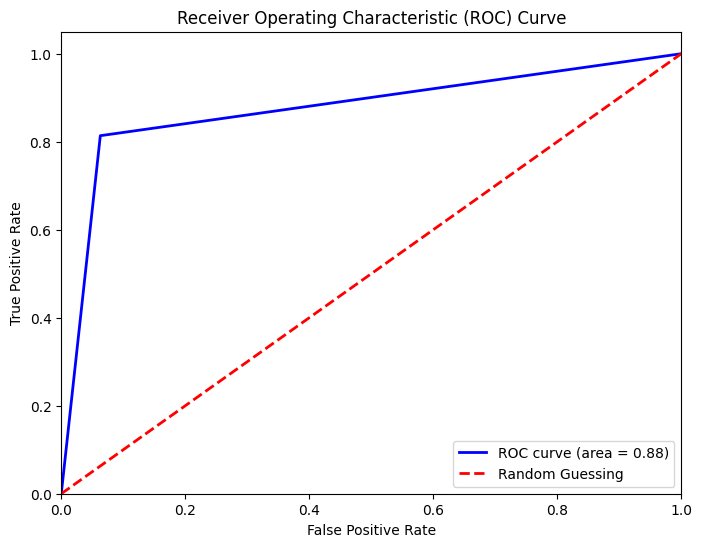

In [103]:
plot_roc_curve(y_test, y_pred)

### Gradient Boosting CLassifier

#### Normalized data

In [106]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

model = GradientBoostingClassifier(random_state=42)

param_grid = {
    'n_estimators': [10, 100, 200],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 4, 5],
    'subsample': [0.8, 0.9]
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)
print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(normal(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")
print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")
print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 622.46 seconds
Best Hyperparameters:
{'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100, 'subsample': 0.8}

Time taken for training with best hyperparameters: 8.55 seconds

Mean Accuracy: 0.8892219917012449
Standard Deviation of Accuracy: 0.014251086861520372
Mean Precision: 0.8494764199981569
Standard Deviation of Precision: 0.02849725122139536
Mean Recall: 0.8237143696738173
Standard Deviation of Recall: 0.03673016743764838
Mean F1-score: 0.835649264494583
Standard Deviation of F1-score: 0.022112443252909064
Mean ROC AUC: 0.8735499204653856
Standard Deviation of ROC AUC: 0.01767142589371357

Total time taken: 631.01 seconds


In [107]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [108]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.8818635607321131
Precision: 0.8518518518518519
Recall: 0.7892156862745098
F1 Score: 0.8193384223918574
ROC AUC Score: 0.8593433595100508
Confusion Matrix:
[[369  28]
 [ 43 161]]


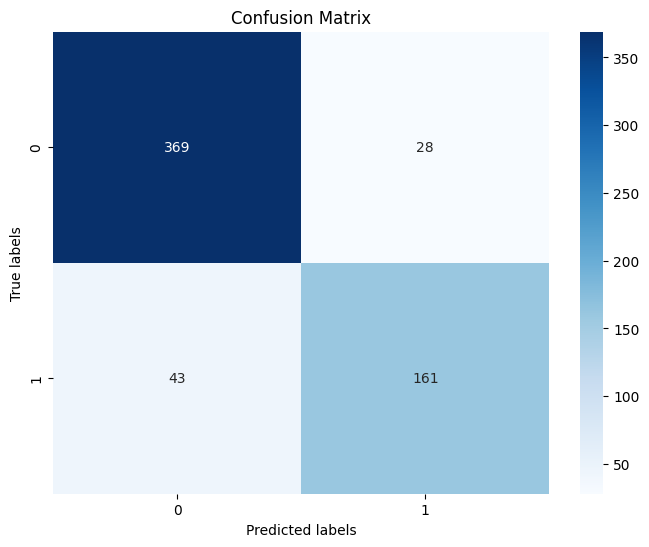

In [109]:
plot_confusion_matrix(y_test, y_pred,(0,1))

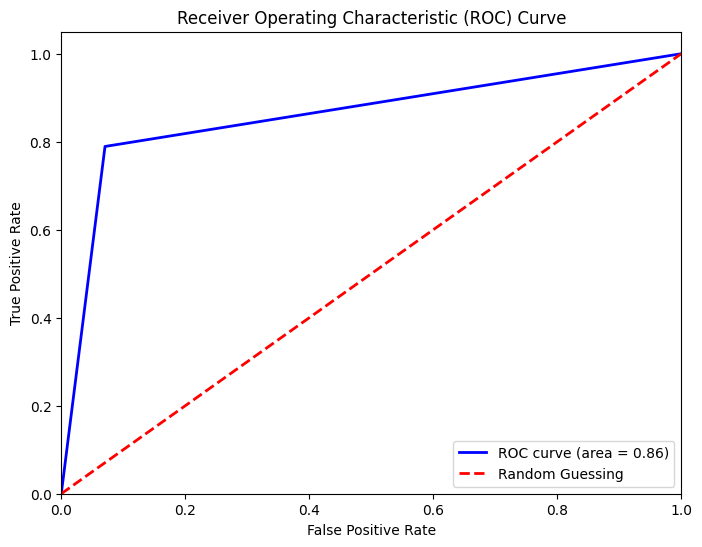

In [110]:
plot_roc_curve(y_test, y_pred)

#### Standardized data

In [111]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

model = GradientBoostingClassifier(random_state=42)

param_grid = {
    'n_estimators': [10, 100, 200],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 4, 5],
    'subsample': [0.8, 0.9]
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)
print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(standard(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")
print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")
print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 608.26 seconds
Best Hyperparameters:
{'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100, 'subsample': 0.8}

Time taken for training with best hyperparameters: 8.36 seconds

Mean Accuracy: 0.8892219917012449
Standard Deviation of Accuracy: 0.014251086861520372
Mean Precision: 0.8494764199981569
Standard Deviation of Precision: 0.02849725122139536
Mean Recall: 0.8237143696738173
Standard Deviation of Recall: 0.03673016743764838
Mean F1-score: 0.835649264494583
Standard Deviation of F1-score: 0.022112443252909064
Mean ROC AUC: 0.8735499204653856
Standard Deviation of ROC AUC: 0.01767142589371357

Total time taken: 616.63 seconds


In [112]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [113]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.8818635607321131
Precision: 0.8518518518518519
Recall: 0.7892156862745098
F1 Score: 0.8193384223918574
ROC AUC Score: 0.8593433595100508
Confusion Matrix:
[[369  28]
 [ 43 161]]


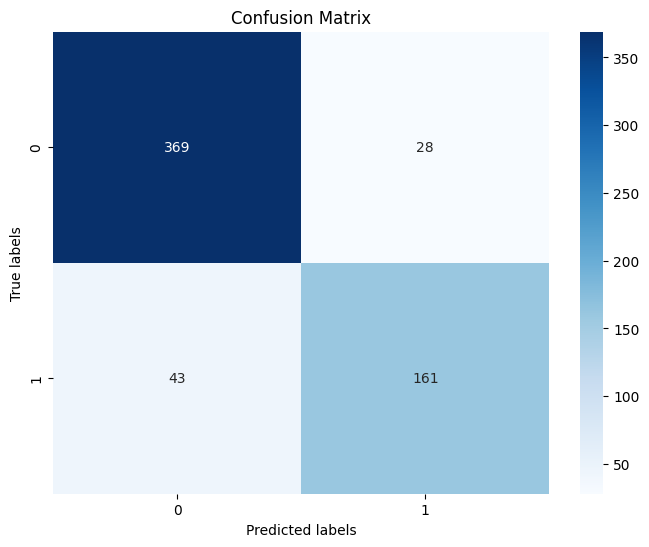

In [114]:
plot_confusion_matrix(y_test, y_pred,(0,1))

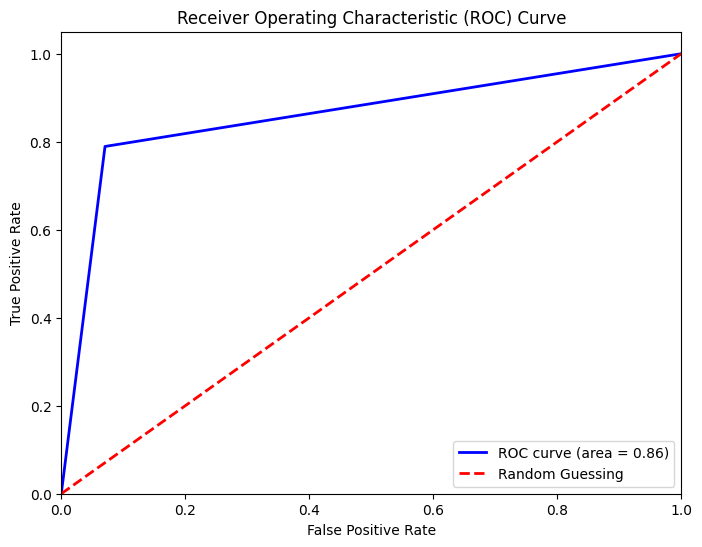

In [115]:
plot_roc_curve(y_test, y_pred)

### K Nearest Neighbors

#### Normalized data

In [116]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

model = KNeighborsClassifier()

param_grid = {
    'n_neighbors': [3, 5, 7, 9, 11],
    'weights': ['uniform', 'distance'],
    'metric': ['euclidean', 'manhattan', 'minkowski']
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)
print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(normal(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")
print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")
print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 13.22 seconds
Best Hyperparameters:
{'metric': 'manhattan', 'n_neighbors': 9, 'weights': 'uniform'}

Time taken for training with best hyperparameters: 0.54 seconds

Mean Accuracy: 0.8146749654218535
Standard Deviation of Accuracy: 0.028345736805029095
Mean Precision: 0.7763764918358598
Standard Deviation of Precision: 0.04938355482155652
Mean Recall: 0.6461357625624449
Standard Deviation of Recall: 0.05529803012408481
Mean F1-score: 0.704225329880496
Standard Deviation of F1-score: 0.04728772331593986
Mean ROC AUC: 0.7743054850867533
Standard Deviation of ROC AUC: 0.0330882710529744

Total time taken: 13.76 seconds


In [117]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [118]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.8119800332778702
Precision: 0.7791411042944786
Recall: 0.6225490196078431
F1 Score: 0.6920980926430519
ROC AUC Score: 0.7659344594260878
Confusion Matrix:
[[361  36]
 [ 77 127]]


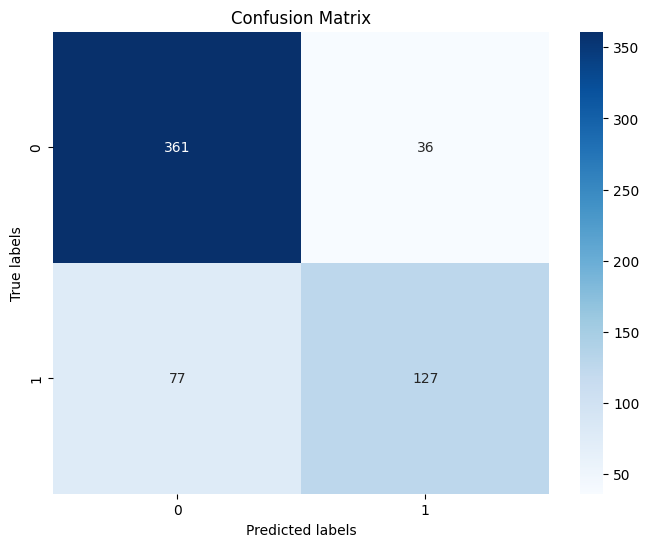

In [119]:
plot_confusion_matrix(y_test, y_pred,(0,1))

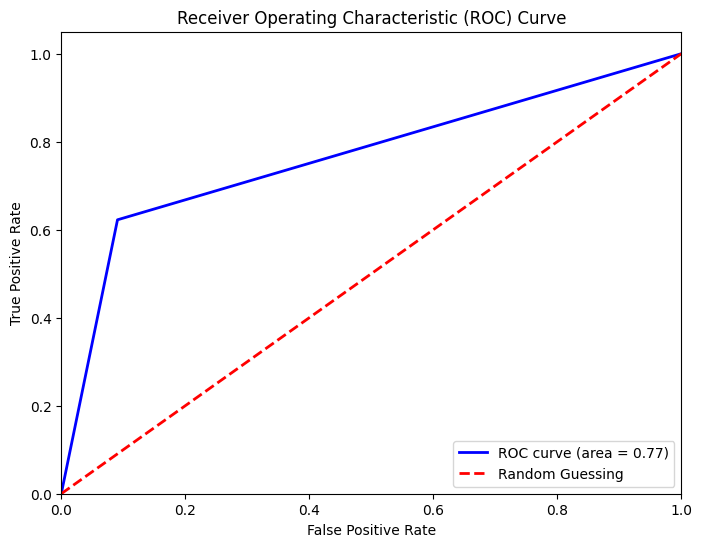

In [120]:
plot_roc_curve(y_test, y_pred)

#### Standardized data

In [121]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

model = KNeighborsClassifier()

param_grid = {
    'n_neighbors': [3, 5, 7, 9, 11],
    'weights': ['uniform', 'distance'],
    'metric': ['euclidean', 'manhattan', 'minkowski']
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)
print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(standard(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")
print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")
print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 12.75 seconds
Best Hyperparameters:
{'metric': 'manhattan', 'n_neighbors': 9, 'weights': 'uniform'}

Time taken for training with best hyperparameters: 0.51 seconds

Mean Accuracy: 0.8146749654218535
Standard Deviation of Accuracy: 0.028345736805029095
Mean Precision: 0.7763764918358598
Standard Deviation of Precision: 0.04938355482155652
Mean Recall: 0.6461357625624449
Standard Deviation of Recall: 0.05529803012408481
Mean F1-score: 0.704225329880496
Standard Deviation of F1-score: 0.04728772331593986
Mean ROC AUC: 0.7743054850867533
Standard Deviation of ROC AUC: 0.0330882710529744

Total time taken: 13.27 seconds


In [122]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [123]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.8119800332778702
Precision: 0.7791411042944786
Recall: 0.6225490196078431
F1 Score: 0.6920980926430519
ROC AUC Score: 0.7659344594260878
Confusion Matrix:
[[361  36]
 [ 77 127]]


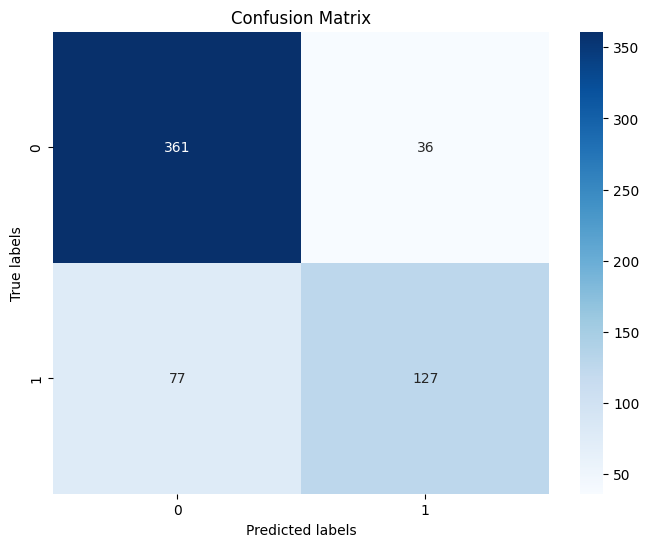

In [124]:
plot_confusion_matrix(y_test, y_pred,(0,1))

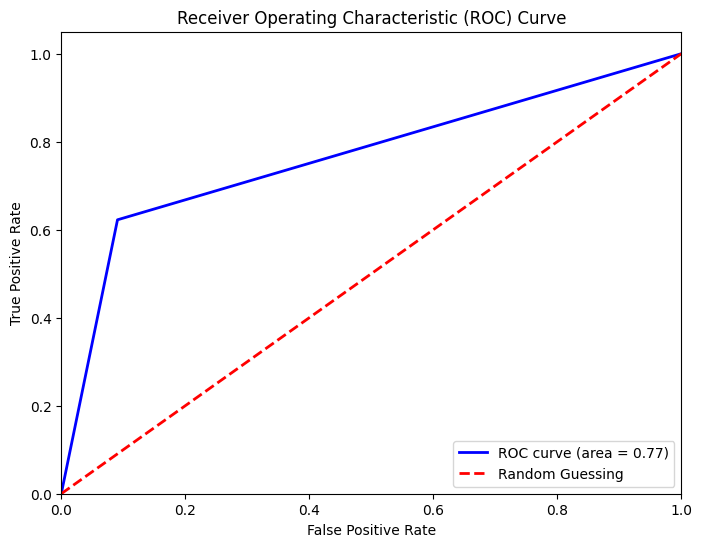

In [125]:
plot_roc_curve(y_test, y_pred)

### Stacking Classifier

#### Normalized data

In [13]:
from xgboost import XGBClassifier
from sklearn.ensemble import StackingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

base_models = [
    ('xgb', XGBClassifier(random_state=42, use_label_encoder=False, eval_metric='logloss')),
    ('dt', DecisionTreeClassifier(random_state=42))
]

meta_model = LogisticRegression()

stacking_model = StackingClassifier(estimators=base_models, final_estimator=meta_model, passthrough=True, cv=kf)

param_grid = {
    'xgb__n_estimators': [10, 50, 100],
    'xgb__learning_rate': [0.01, 0.1, 0.2],
    'xgb__max_depth': [3, 4, 5],
    'dt__max_depth': [None, 10, 20],
    'dt__min_samples_split': [2, 5, 10]
}

grid_search = GridSearchCV(estimator=stacking_model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)
print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(normal(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")
print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")
print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 1139.04 seconds
Best Hyperparameters:
{'dt__max_depth': 10, 'dt__min_samples_split': 2, 'xgb__learning_rate': 0.2, 'xgb__max_depth': 3, 'xgb__n_estimators': 100}

Time taken for training with best hyperparameters: 7.73 seconds

Mean Accuracy: 0.81591459197787
Standard Deviation of Accuracy: 0.030349300788210683
Mean Precision: 0.7568530963284796
Standard Deviation of Precision: 0.0505783644964972
Mean Recall: 0.6837790185130767
Standard Deviation of Recall: 0.0555930314207229
Mean F1-score: 0.7174435978837421
Standard Deviation of F1-score: 0.04666704783684153
Mean ROC AUC: 0.7842663535683984
Standard Deviation of ROC AUC: 0.034526039966267436

Total time taken: 1146.77 seconds


In [14]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [15]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.8219633943427621
Precision: 0.7487179487179487
Recall: 0.7156862745098039
F1 Score: 0.731829573934837
ROC AUC Score: 0.7961302909072949
Confusion Matrix:
[[348  49]
 [ 58 146]]


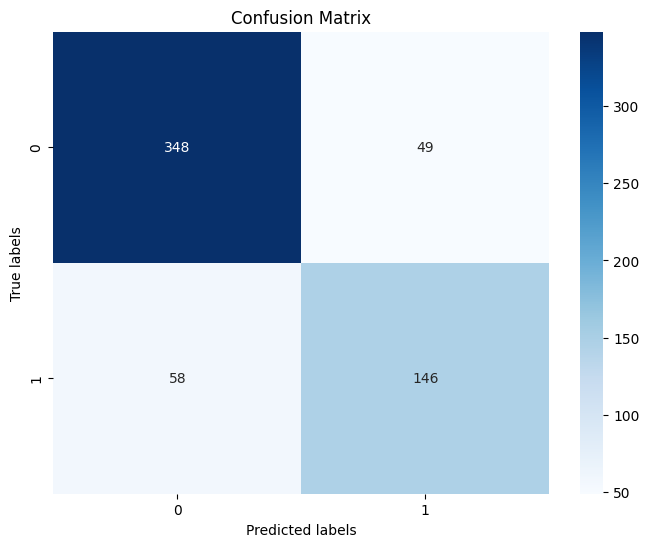

In [16]:
plot_confusion_matrix(y_test, y_pred,(0,1))

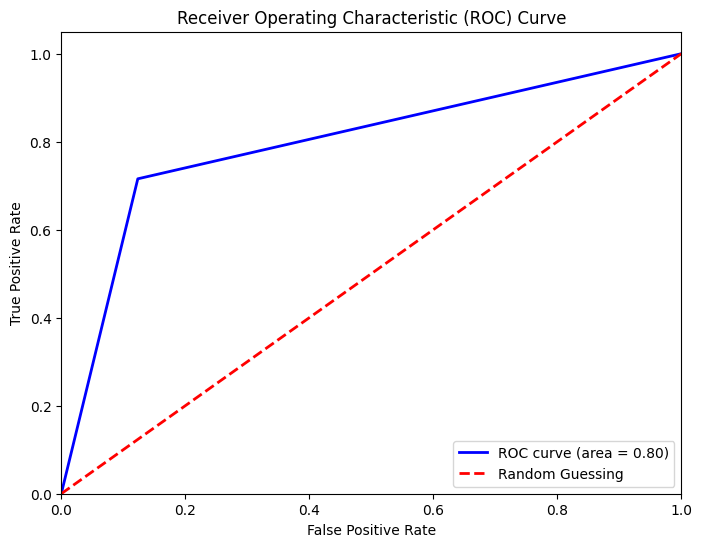

In [17]:
plot_roc_curve(y_test, y_pred)

#### Standardized data

In [19]:
from xgboost import XGBClassifier
from sklearn.ensemble import StackingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

base_models = [
    ('xgb', XGBClassifier(random_state=42, use_label_encoder=False, eval_metric='logloss')),
    ('dt', DecisionTreeClassifier(random_state=42))
]

meta_model = LogisticRegression()

stacking_model = StackingClassifier(estimators=base_models, final_estimator=meta_model, passthrough=True, cv=kf)

param_grid = {
    'xgb__n_estimators': [10, 50, 100],
    'xgb__learning_rate': [0.01, 0.1, 0.2],
    'xgb__max_depth': [3, 4, 5],
    'dt__max_depth': [None, 10, 20],
    'dt__min_samples_split': [2, 5, 10]
}

grid_search = GridSearchCV(estimator=stacking_model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)
print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(standard(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")
print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")
print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 2166.29 seconds
Best Hyperparameters:
{'dt__max_depth': 10, 'dt__min_samples_split': 2, 'xgb__learning_rate': 0.2, 'xgb__max_depth': 3, 'xgb__n_estimators': 100}

Time taken for training with best hyperparameters: 14.56 seconds

Mean Accuracy: 0.81591459197787
Standard Deviation of Accuracy: 0.030349300788210683
Mean Precision: 0.7568530963284796
Standard Deviation of Precision: 0.0505783644964972
Mean Recall: 0.6837790185130767
Standard Deviation of Recall: 0.0555930314207229
Mean F1-score: 0.7174435978837421
Standard Deviation of F1-score: 0.04666704783684153
Mean ROC AUC: 0.7842663535683984
Standard Deviation of ROC AUC: 0.034526039966267436

Total time taken: 2180.86 seconds


In [20]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [21]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.8219633943427621
Precision: 0.7487179487179487
Recall: 0.7156862745098039
F1 Score: 0.731829573934837
ROC AUC Score: 0.7961302909072949
Confusion Matrix:
[[348  49]
 [ 58 146]]


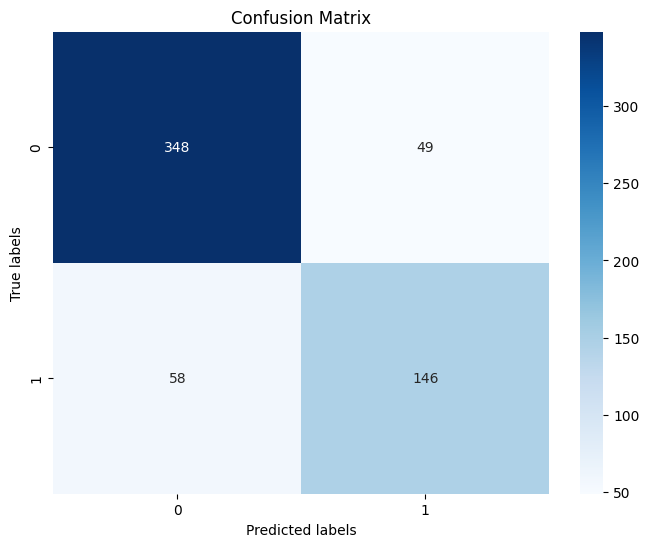

In [22]:
plot_confusion_matrix(y_test, y_pred,(0,1))

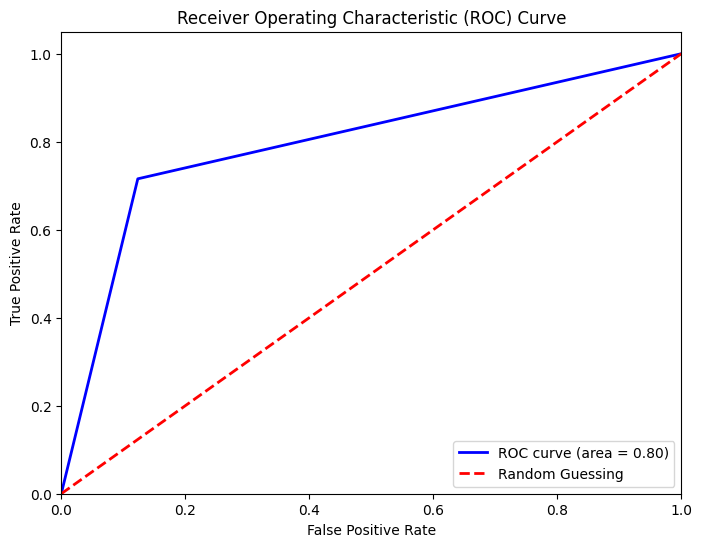

In [23]:
plot_roc_curve(y_test, y_pred)

### Voting Classifier

#### Normalized data

In [25]:
from xgboost import XGBClassifier
from sklearn.ensemble import VotingClassifier, AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

clf1 = XGBClassifier(random_state=42, use_label_encoder=False, eval_metric='logloss')
clf2 = AdaBoostClassifier(random_state=42)
clf3 = DecisionTreeClassifier(random_state=42)

voting_model = VotingClassifier(estimators=[
    ('xgb', clf1),
    ('ada', clf2),
    ('dt', clf3)
], voting='soft')

param_grid = {
    'xgb__n_estimators': [10, 50, 100],
    'xgb__learning_rate': [0.01, 0.1, 0.2],
    'xgb__max_depth': [3, 4, 5],
    'ada__n_estimators': [50, 100],
    'ada__learning_rate': [0.01, 0.1],
    'dt__max_depth': [None, 10, 20],
    'dt__min_samples_split': [2, 5, 10]
}

grid_search = GridSearchCV(estimator=voting_model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)
print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(normal(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")
print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")
print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 4823.12 seconds
Best Hyperparameters:
{'ada__learning_rate': 0.01, 'ada__n_estimators': 100, 'dt__max_depth': 10, 'dt__min_samples_split': 10, 'xgb__learning_rate': 0.2, 'xgb__max_depth': 3, 'xgb__n_estimators': 100}

Time taken for training with best hyperparameters: 8.25 seconds

Mean Accuracy: 0.8758921161825727
Standard Deviation of Accuracy: 0.017201464058433345
Mean Precision: 0.8277859055185062
Standard Deviation of Precision: 0.03253056125722735
Mean Recall: 0.8066852776961504
Standard Deviation of Recall: 0.03596903454697755
Mean F1-score: 0.816445823644554
Standard Deviation of F1-score: 0.02551527303659126
Mean ROC AUC: 0.8593351406621522
Standard Deviation of ROC AUC: 0.019796830876094428

Total time taken: 4831.38 seconds


In [26]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [27]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.8801996672212978
Precision: 0.8473684210526315
Recall: 0.7892156862745098
F1 Score: 0.8172588832487309
ROC AUC Score: 0.8580839136662222
Confusion Matrix:
[[368  29]
 [ 43 161]]


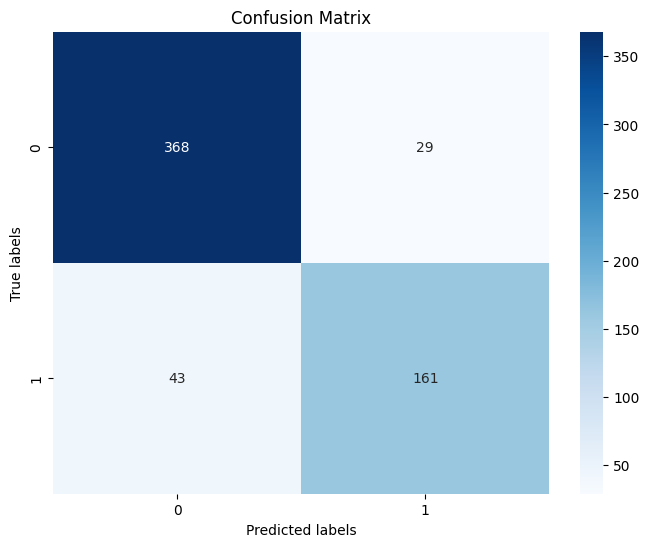

In [28]:
plot_confusion_matrix(y_test, y_pred,(0,1))

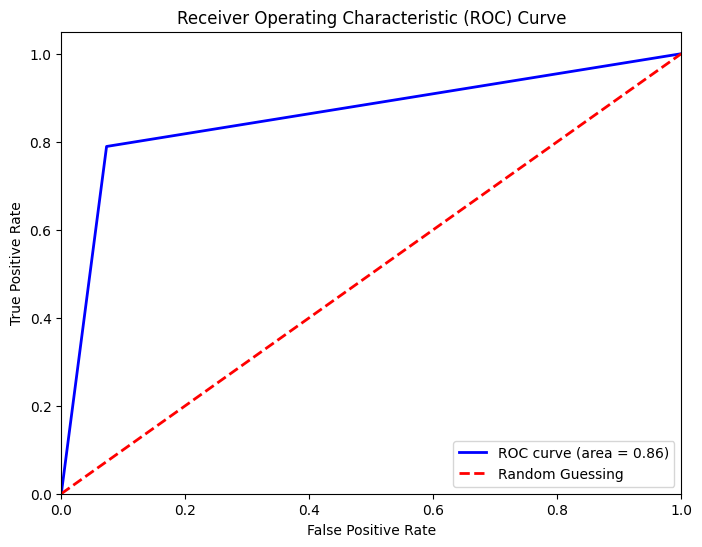

In [29]:
plot_roc_curve(y_test, y_pred)

#### Standardized data

In [30]:
from xgboost import XGBClassifier
from sklearn.ensemble import VotingClassifier, AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

clf1 = XGBClassifier(random_state=42, use_label_encoder=False, eval_metric='logloss')
clf2 = AdaBoostClassifier(random_state=42)
clf3 = DecisionTreeClassifier(random_state=42)

voting_model = VotingClassifier(estimators=[
    ('xgb', clf1),
    ('ada', clf2),
    ('dt', clf3)
], voting='soft')

param_grid = {
    'xgb__n_estimators': [10, 50, 100],
    'xgb__learning_rate': [0.01, 0.1, 0.2],
    'xgb__max_depth': [3, 4, 5],
    'ada__n_estimators': [50, 100],
    'ada__learning_rate': [0.01, 0.1],
    'dt__max_depth': [None, 10, 20],
    'dt__min_samples_split': [2, 5, 10]
}

grid_search = GridSearchCV(estimator=voting_model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)
print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(standard(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")
print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")
print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 3572.82 seconds
Best Hyperparameters:
{'ada__learning_rate': 0.01, 'ada__n_estimators': 100, 'dt__max_depth': 10, 'dt__min_samples_split': 10, 'xgb__learning_rate': 0.2, 'xgb__max_depth': 3, 'xgb__n_estimators': 100}

Time taken for training with best hyperparameters: 4.01 seconds

Mean Accuracy: 0.8758921161825727
Standard Deviation of Accuracy: 0.017201464058433345
Mean Precision: 0.8277859055185062
Standard Deviation of Precision: 0.03253056125722735
Mean Recall: 0.8066852776961504
Standard Deviation of Recall: 0.03596903454697755
Mean F1-score: 0.816445823644554
Standard Deviation of F1-score: 0.02551527303659126
Mean ROC AUC: 0.8593351406621522
Standard Deviation of ROC AUC: 0.019796830876094428

Total time taken: 3576.83 seconds


In [31]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [32]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.8801996672212978
Precision: 0.8473684210526315
Recall: 0.7892156862745098
F1 Score: 0.8172588832487309
ROC AUC Score: 0.8580839136662222
Confusion Matrix:
[[368  29]
 [ 43 161]]


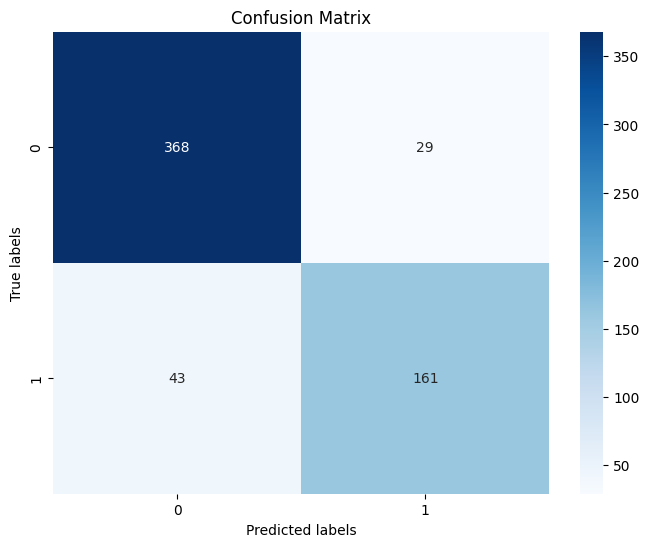

In [33]:
plot_confusion_matrix(y_test, y_pred,(0,1))

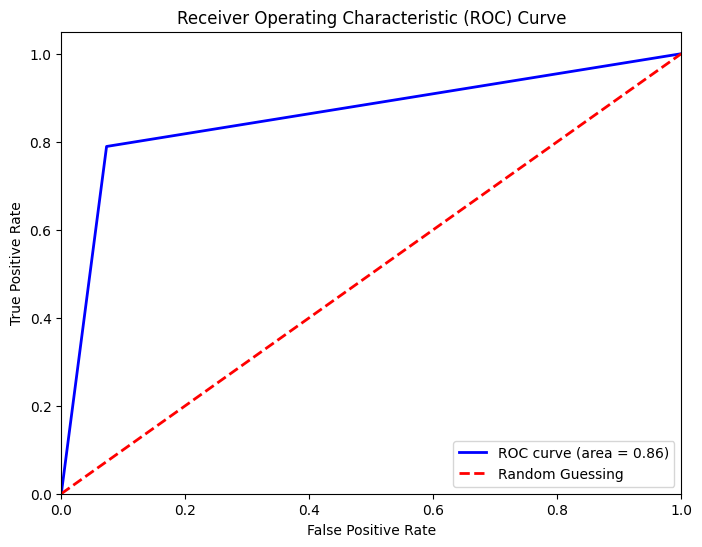

In [34]:
plot_roc_curve(y_test, y_pred)

### Bagging Classifier

#### Normalized data

In [35]:
from xgboost import XGBClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

base_model = XGBClassifier(random_state=42, use_label_encoder=False, eval_metric='logloss')

bagging_model = BaggingClassifier(base_estimator=base_model, random_state=42)

param_grid = {
    'base_estimator__n_estimators': [10, 50, 100],
    'base_estimator__learning_rate': [0.01, 0.1, 0.2],
    'base_estimator__max_depth': [3, 4, 5],
    'n_estimators': [10, 50, 100],
    'max_samples': [0.8, 1.0],
    'max_features': [0.8, 1.0],
}

grid_search = GridSearchCV(estimator=bagging_model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)
print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(normal(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")
print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")
print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 7043.32 seconds
Best Hyperparameters:
{'base_estimator__learning_rate': 0.2, 'base_estimator__max_depth': 3, 'base_estimator__n_estimators': 100, 'max_features': 1.0, 'max_samples': 0.8, 'n_estimators': 10}

Time taken for training with best hyperparameters: 4.51 seconds

Mean Accuracy: 0.8929719917012449
Standard Deviation of Accuracy: 0.016585366209661924
Mean Precision: 0.8524499345881044
Standard Deviation of Precision: 0.03963276780343318
Mean Recall: 0.8346605935938879
Standard Deviation of Recall: 0.04164150530913857
Mean F1-score: 0.8421942043182058
Standard Deviation of F1-score: 0.024609787061739656
Mean ROC AUC: 0.8790250480667978
Standard Deviation of ROC AUC: 0.019001104560078273

Total time taken: 7047.83 seconds


In [36]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [37]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.8885191347753744
Precision: 0.8663101604278075
Recall: 0.7941176470588235
F1 Score: 0.8286445012787724
ROC AUC Score: 0.8655726774336938
Confusion Matrix:
[[372  25]
 [ 42 162]]


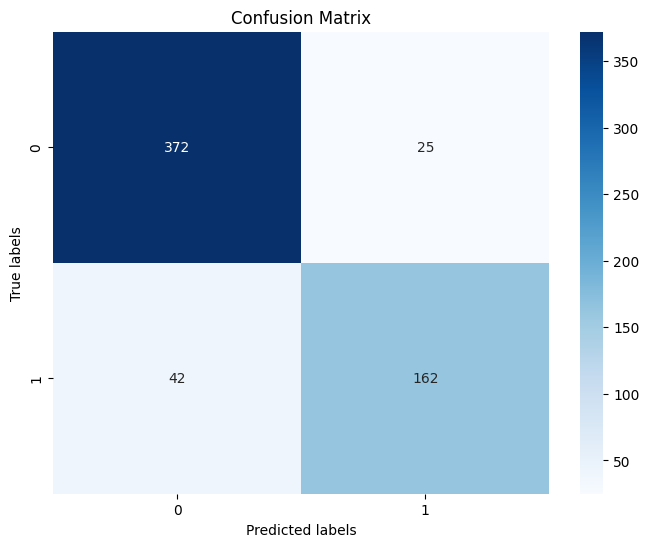

In [38]:
plot_confusion_matrix(y_test, y_pred,(0,1))

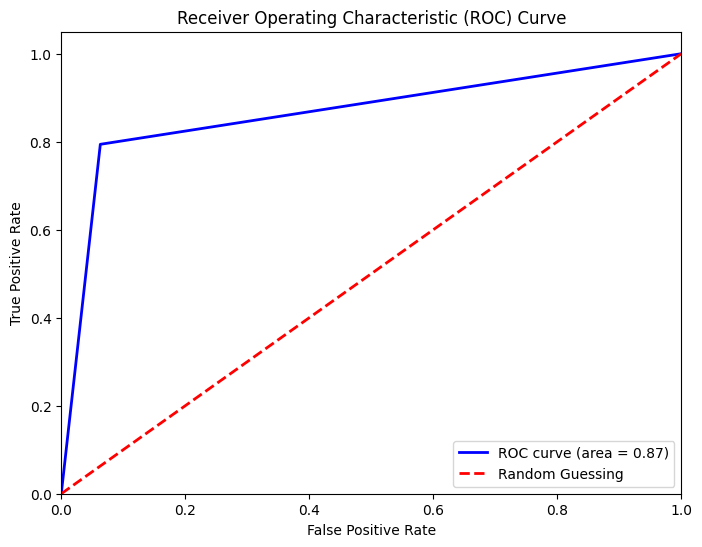

In [39]:
plot_roc_curve(y_test, y_pred)

#### Standardized data

In [40]:
from xgboost import XGBClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

base_model = XGBClassifier(random_state=42, use_label_encoder=False, eval_metric='logloss')

bagging_model = BaggingClassifier(base_estimator=base_model, random_state=42)

param_grid = {
    'base_estimator__n_estimators': [10, 50, 100],
    'base_estimator__learning_rate': [0.01, 0.1, 0.2],
    'base_estimator__max_depth': [3, 4, 5],
    'n_estimators': [10, 50, 100],
    'max_samples': [0.8, 1.0],
    'max_features': [0.8, 1.0],
}

grid_search = GridSearchCV(estimator=bagging_model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)
print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(standard(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")
print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")
print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 6948.70 seconds
Best Hyperparameters:
{'base_estimator__learning_rate': 0.2, 'base_estimator__max_depth': 3, 'base_estimator__n_estimators': 100, 'max_features': 1.0, 'max_samples': 0.8, 'n_estimators': 10}

Time taken for training with best hyperparameters: 10.63 seconds

Mean Accuracy: 0.8929719917012449
Standard Deviation of Accuracy: 0.016585366209661924
Mean Precision: 0.8524499345881044
Standard Deviation of Precision: 0.03963276780343318
Mean Recall: 0.8346605935938879
Standard Deviation of Recall: 0.04164150530913857
Mean F1-score: 0.8421942043182058
Standard Deviation of F1-score: 0.024609787061739656
Mean ROC AUC: 0.8790250480667978
Standard Deviation of ROC AUC: 0.019001104560078273

Total time taken: 6959.33 seconds


In [41]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [42]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.8885191347753744
Precision: 0.8663101604278075
Recall: 0.7941176470588235
F1 Score: 0.8286445012787724
ROC AUC Score: 0.8655726774336938
Confusion Matrix:
[[372  25]
 [ 42 162]]


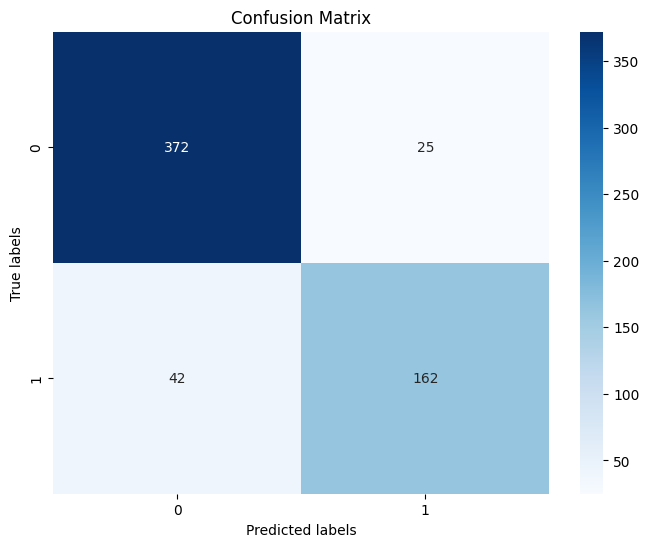

In [43]:
plot_confusion_matrix(y_test, y_pred,(0,1))

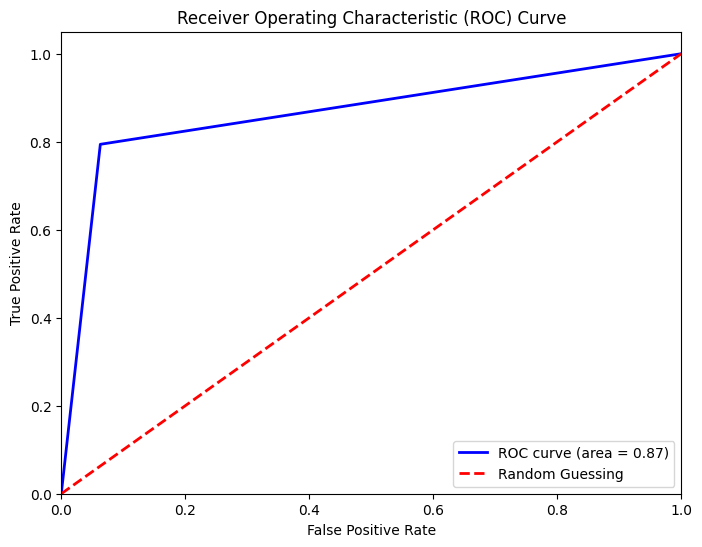

In [44]:
plot_roc_curve(y_test, y_pred)

### CatBoost Classifier

#### Normalized data

In [45]:
from catboost import CatBoostClassifier
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

model = CatBoostClassifier(random_state=42, silent=True)

param_grid = {
    'iterations': [100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.2],
    'depth': [3, 4, 5]
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)
print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(normal(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")
print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")
print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 212.31 seconds
Best Hyperparameters:
{'depth': 3, 'iterations': 200, 'learning_rate': 0.1}

Time taken for training with best hyperparameters: 7.57 seconds

Mean Accuracy: 0.8925570539419088
Standard Deviation of Accuracy: 0.01736280999628729
Mean Precision: 0.8581554633489977
Standard Deviation of Precision: 0.0462767969531329
Mean Recall: 0.8261533940640611
Standard Deviation of Recall: 0.03781186410566183
Mean F1-score: 0.8404969985160087
Standard Deviation of F1-score: 0.02465285113204594
Mean ROC AUC: 0.8766661511963456
Standard Deviation of ROC AUC: 0.01835801213701771

Total time taken: 219.89 seconds


In [46]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [47]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.8968386023294509
Precision: 0.8585858585858586
Recall: 0.8333333333333334
F1 Score: 0.8457711442786069
ROC AUC Score: 0.8814021830394627
Confusion Matrix:
[[369  28]
 [ 34 170]]


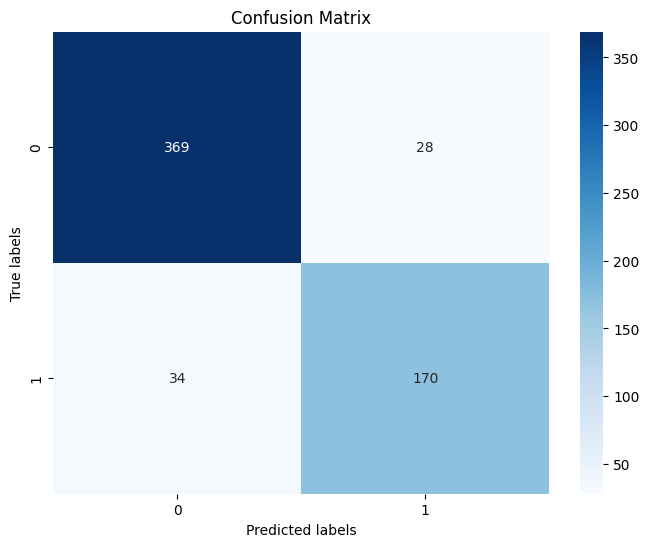

In [48]:
plot_confusion_matrix(y_test, y_pred,(0,1))

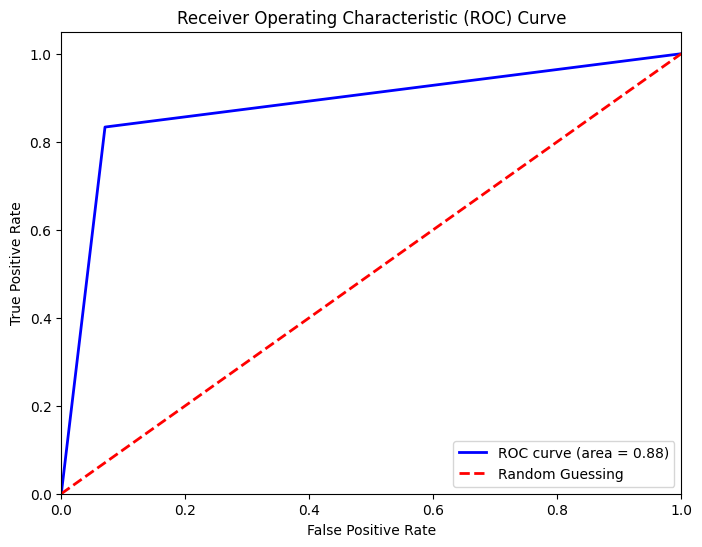

In [49]:
plot_roc_curve(y_test, y_pred)

#### Standardized data

In [50]:
from catboost import CatBoostClassifier
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

model = CatBoostClassifier(random_state=42, silent=True)

param_grid = {
    'iterations': [100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.2],
    'depth': [3, 4, 5]
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)
print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(standard(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")
print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")
print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 208.35 seconds
Best Hyperparameters:
{'depth': 3, 'iterations': 200, 'learning_rate': 0.1}

Time taken for training with best hyperparameters: 7.65 seconds

Mean Accuracy: 0.8925570539419088
Standard Deviation of Accuracy: 0.01736280999628729
Mean Precision: 0.8581554633489977
Standard Deviation of Precision: 0.0462767969531329
Mean Recall: 0.8261533940640611
Standard Deviation of Recall: 0.03781186410566183
Mean F1-score: 0.8404969985160087
Standard Deviation of F1-score: 0.02465285113204594
Mean ROC AUC: 0.8766661511963456
Standard Deviation of ROC AUC: 0.01835801213701771

Total time taken: 216.01 seconds


In [51]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [52]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.8968386023294509
Precision: 0.8585858585858586
Recall: 0.8333333333333334
F1 Score: 0.8457711442786069
ROC AUC Score: 0.8814021830394627
Confusion Matrix:
[[369  28]
 [ 34 170]]


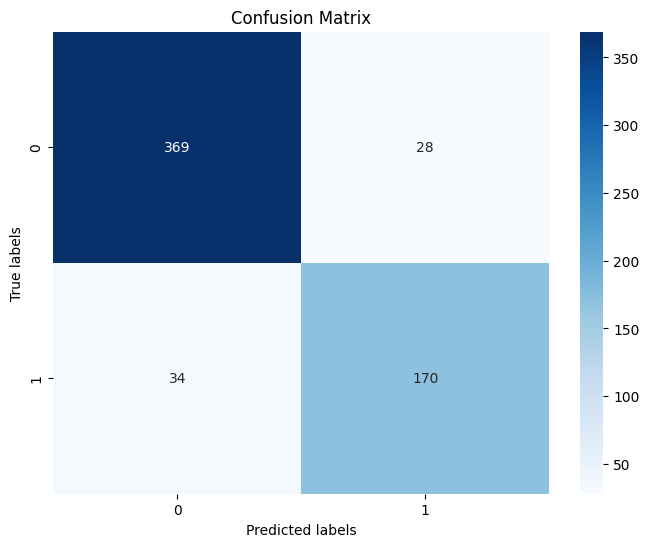

In [53]:
plot_confusion_matrix(y_test, y_pred,(0,1))

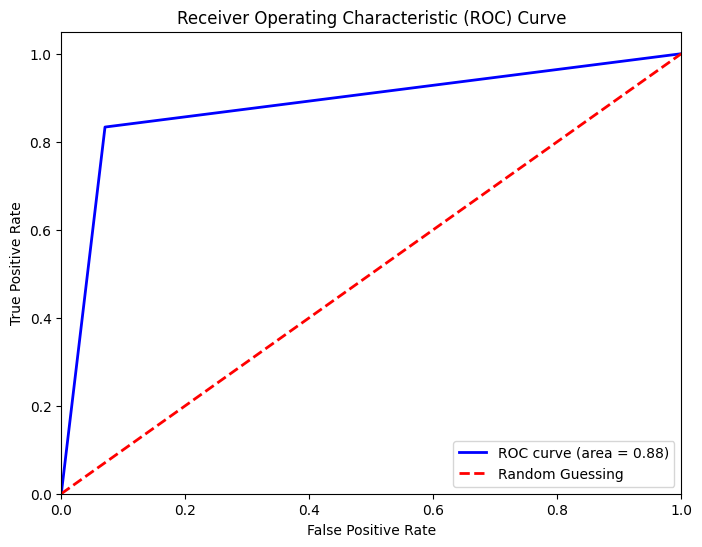

In [54]:
plot_roc_curve(y_test, y_pred)

### LinearSVC

### Normalized data

In [55]:
from sklearn.svm import LinearSVC
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

model = LinearSVC(random_state=42, max_iter=10000)

param_grid = {
    'C': [0.01, 0.1, 1, 10, 100],
    'loss': ['hinge', 'squared_hinge'],
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)
print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(normal(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")
print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")
print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 42.83 seconds
Best Hyperparameters:
{'C': 0.1, 'loss': 'hinge'}

Time taken for training with best hyperparameters: 16.42 seconds

Mean Accuracy: 0.6396680497925311
Standard Deviation of Accuracy: 0.12724229244007448
Mean Precision: 0.5719002790868557
Standard Deviation of Precision: 0.17060296499376207
Mean Recall: 0.7531442844548927
Standard Deviation of Recall: 0.28991380948387724
Mean F1-score: 0.5653112640891156
Standard Deviation of F1-score: 0.16878833530224618
Mean ROC AUC: 0.6670280803069433
Standard Deviation of ROC AUC: 0.08612601249207863

Total time taken: 59.25 seconds


In [56]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [57]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.8103161397670549
Precision: 0.8308823529411765
Recall: 0.553921568627451
F1 Score: 0.6647058823529413
ROC AUC Score: 0.747993529905665
Confusion Matrix:
[[374  23]
 [ 91 113]]


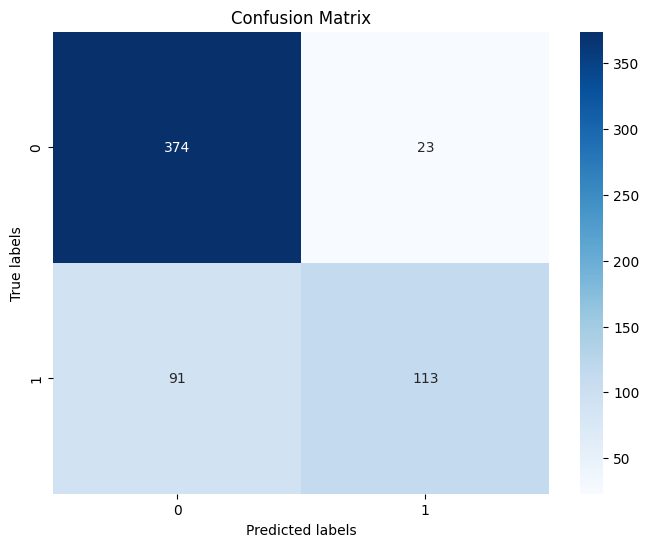

In [58]:
plot_confusion_matrix(y_test, y_pred,(0,1))

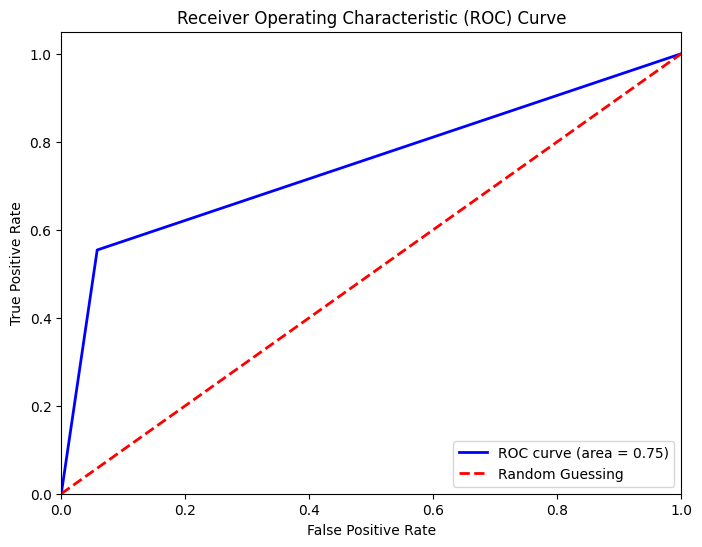

In [59]:
plot_roc_curve(y_test, y_pred)

### Standardized data

In [60]:
from sklearn.svm import LinearSVC
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

model = LinearSVC(random_state=42, max_iter=10000)

param_grid = {
    'C': [0.01, 0.1, 1, 10, 100],
    'loss': ['hinge', 'squared_hinge'],
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)
print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(standard(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")
print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")
print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 16.62 seconds
Best Hyperparameters:
{'C': 0.1, 'loss': 'hinge'}

Time taken for training with best hyperparameters: 6.65 seconds

Mean Accuracy: 0.6396680497925311
Standard Deviation of Accuracy: 0.12724229244007448
Mean Precision: 0.5719002790868557
Standard Deviation of Precision: 0.17060296499376207
Mean Recall: 0.7531442844548927
Standard Deviation of Recall: 0.28991380948387724
Mean F1-score: 0.5653112640891156
Standard Deviation of F1-score: 0.16878833530224618
Mean ROC AUC: 0.6670280803069433
Standard Deviation of ROC AUC: 0.08612601249207863

Total time taken: 23.27 seconds


In [61]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [62]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.8103161397670549
Precision: 0.8308823529411765
Recall: 0.553921568627451
F1 Score: 0.6647058823529413
ROC AUC Score: 0.747993529905665
Confusion Matrix:
[[374  23]
 [ 91 113]]


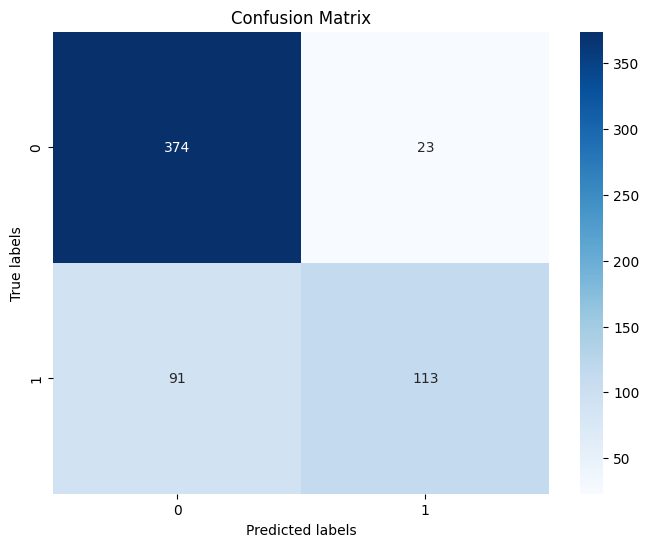

In [63]:
plot_confusion_matrix(y_test, y_pred,(0,1))

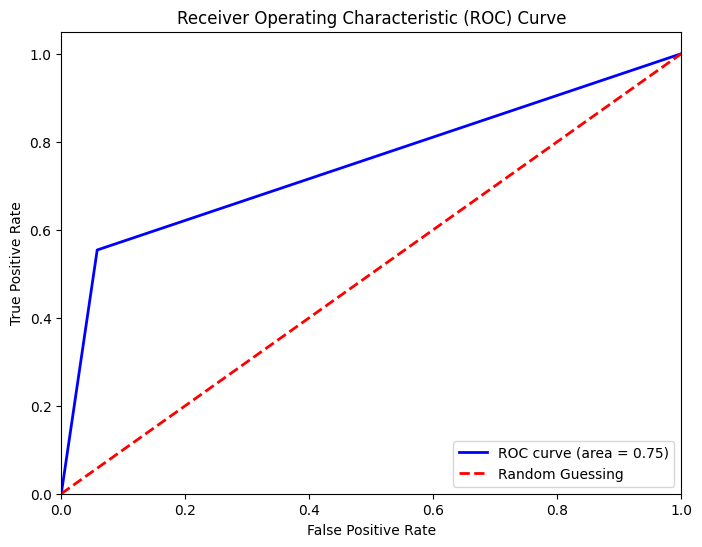

In [64]:
plot_roc_curve(y_test, y_pred)

### SVC

#### Normalized data

In [65]:
from sklearn.svm import SVC
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

model = SVC(random_state=42)

param_grid = {
    'C': [0.1, 1, 10, 100],
    'kernel': ['linear', 'poly', 'rbf', 'sigmoid'],
    'gamma': ['scale', 'auto'],
    'degree': [2, 3, 4]
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)
print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(normal(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")
print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")
print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 200.18 seconds
Best Hyperparameters:
{'C': 1, 'degree': 2, 'gamma': 'auto', 'kernel': 'rbf'}

Time taken for training with best hyperparameters: 3.63 seconds

Mean Accuracy: 0.6576434993084371
Standard Deviation of Accuracy: 0.001416490093586219
Mean Precision: 0.0
Standard Deviation of Precision: 0.0
Mean Recall: 0.0
Standard Deviation of Recall: 0.0
Mean F1-score: 0.0
Standard Deviation of F1-score: 0.0
Mean ROC AUC: 0.5
Standard Deviation of ROC AUC: 0.0

Total time taken: 203.81 seconds


In [66]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [67]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.6605657237936772
Precision: 0.0
Recall: 0.0
F1 Score: 0.0
ROC AUC Score: 0.5
Confusion Matrix:
[[397   0]
 [204   0]]


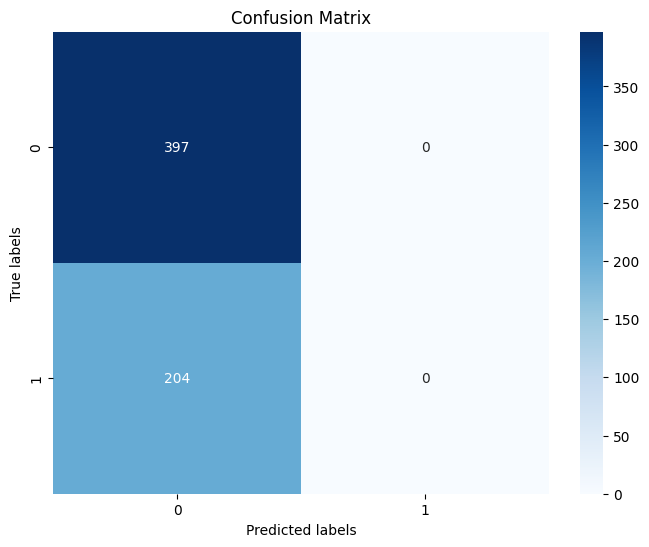

In [68]:
plot_confusion_matrix(y_test, y_pred,(0,1))

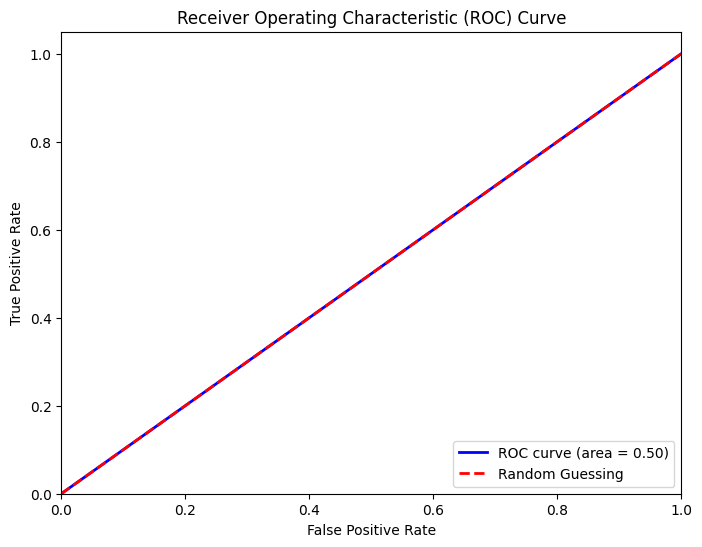

In [69]:
plot_roc_curve(y_test, y_pred)

#### Standardized data

In [70]:
from sklearn.svm import SVC
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

model = SVC(random_state=42)

param_grid = {
    'C': [0.1, 1, 10, 100],
    'kernel': ['linear', 'poly', 'rbf', 'sigmoid'],
    'gamma': ['scale', 'auto'],
    'degree': [2, 3, 4]
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)
print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(standard(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")
print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")
print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 196.68 seconds
Best Hyperparameters:
{'C': 1, 'degree': 2, 'gamma': 'auto', 'kernel': 'rbf'}

Time taken for training with best hyperparameters: 4.07 seconds

Mean Accuracy: 0.6576434993084371
Standard Deviation of Accuracy: 0.001416490093586219
Mean Precision: 0.0
Standard Deviation of Precision: 0.0
Mean Recall: 0.0
Standard Deviation of Recall: 0.0
Mean F1-score: 0.0
Standard Deviation of F1-score: 0.0
Mean ROC AUC: 0.5
Standard Deviation of ROC AUC: 0.0

Total time taken: 200.75 seconds


In [71]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [72]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.6605657237936772
Precision: 0.0
Recall: 0.0
F1 Score: 0.0
ROC AUC Score: 0.5
Confusion Matrix:
[[397   0]
 [204   0]]


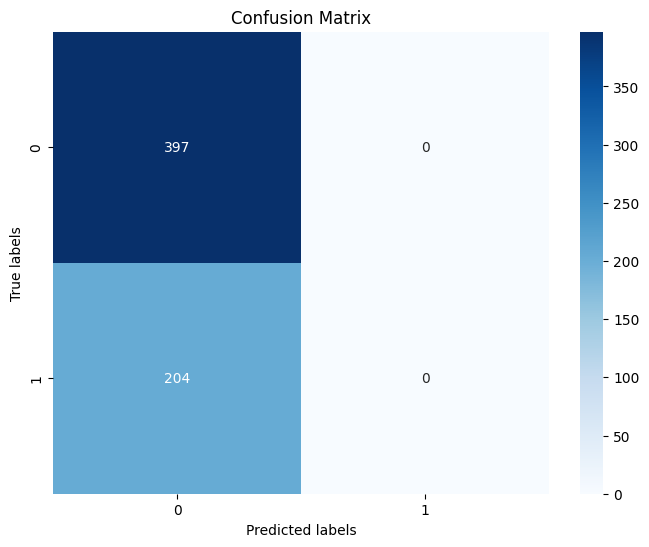

In [73]:
plot_confusion_matrix(y_test, y_pred,(0,1))

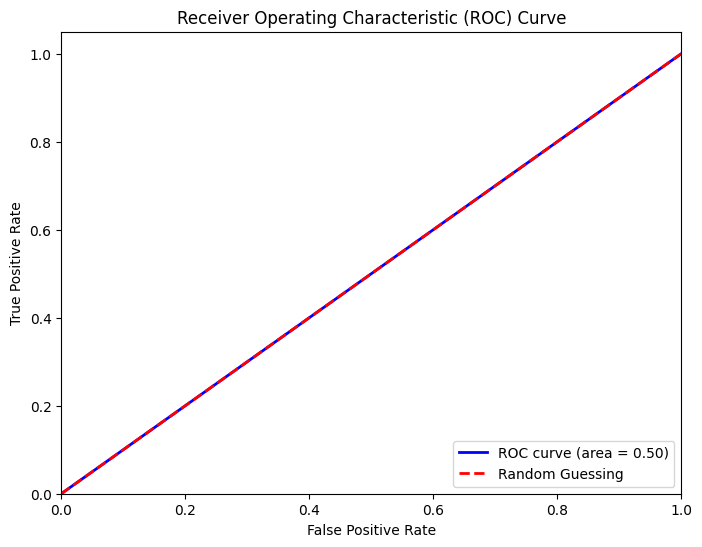

In [74]:
plot_roc_curve(y_test, y_pred)

### Perceptron

#### Normalized data

In [75]:
from sklearn.linear_model import Perceptron
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

model = Perceptron(random_state=42)

param_grid = {
    'penalty': [None, 'l2', 'l1', 'elasticnet'],
    'alpha': [0.0001, 0.001, 0.01, 0.1],
    'max_iter': [1000, 2000, 3000],
    'tol': [1e-3, 1e-4, 1e-5]
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)
print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(normal(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")
print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")
print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 6.46 seconds
Best Hyperparameters:
{'alpha': 0.001, 'max_iter': 1000, 'penalty': 'l1', 'tol': 0.0001}

Time taken for training with best hyperparameters: 0.10 seconds

Mean Accuracy: 0.5869381051175657
Standard Deviation of Accuracy: 0.1532782626832634
Mean Precision: 0.5424396959818047
Standard Deviation of Precision: 0.17290092302933616
Mean Recall: 0.7031148986188657
Standard Deviation of Recall: 0.31746538293787024
Mean F1-score: 0.5166216267007258
Standard Deviation of F1-score: 0.11741940352196295
Mean ROC AUC: 0.61482036957066
Standard Deviation of ROC AUC: 0.07747266852928748

Total time taken: 6.57 seconds


In [76]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [77]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.6888519134775375
Precision: 0.84
Recall: 0.10294117647058823
F1 Score: 0.1834061135371179
ROC AUC Score: 0.5464328048599794
Confusion Matrix:
[[393   4]
 [183  21]]


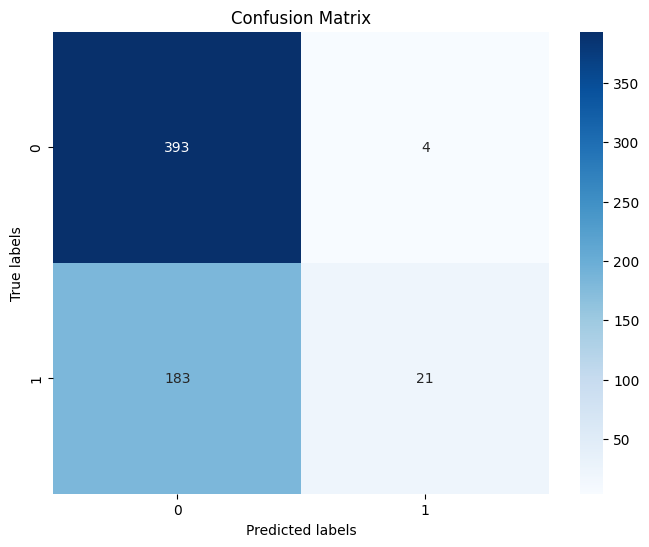

In [78]:
plot_confusion_matrix(y_test, y_pred,(0,1))

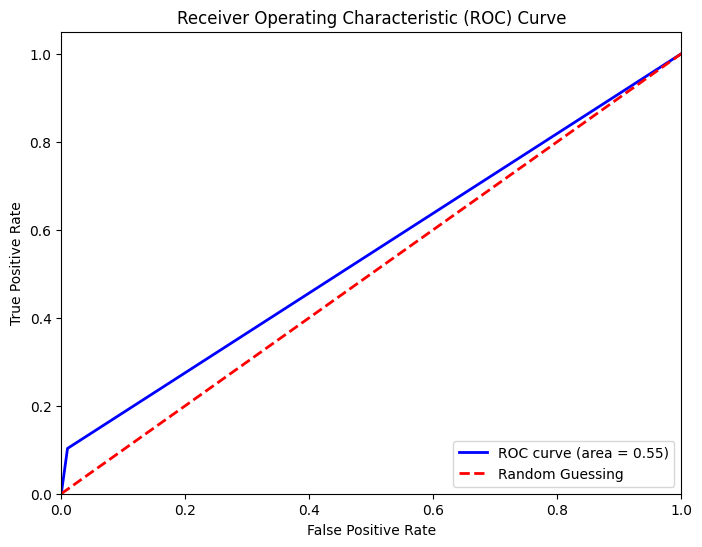

In [79]:
plot_roc_curve(y_test, y_pred)

#### Standardized data

In [10]:
from sklearn.linear_model import Perceptron
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

model = Perceptron(random_state=42)

param_grid = {
    'penalty': [None, 'l2', 'l1', 'elasticnet'],
    'alpha': [0.0001, 0.001, 0.01, 0.1],
    'max_iter': [1000, 2000, 3000],
    'tol': [1e-3, 1e-4, 1e-5]
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)
print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(standard(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")
print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")
print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 12.46 seconds
Best Hyperparameters:
{'alpha': 0.001, 'max_iter': 1000, 'penalty': 'l1', 'tol': 0.0001}

Time taken for training with best hyperparameters: 0.27 seconds

Mean Accuracy: 0.5869381051175657
Standard Deviation of Accuracy: 0.1532782626832634
Mean Precision: 0.5424396959818047
Standard Deviation of Precision: 0.17290092302933616
Mean Recall: 0.7031148986188657
Standard Deviation of Recall: 0.31746538293787024
Mean F1-score: 0.5166216267007258
Standard Deviation of F1-score: 0.11741940352196295
Mean ROC AUC: 0.61482036957066
Standard Deviation of ROC AUC: 0.07747266852928748

Total time taken: 12.73 seconds


In [11]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [12]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.6888519134775375
Precision: 0.84
Recall: 0.10294117647058823
F1 Score: 0.1834061135371179
ROC AUC Score: 0.5464328048599794
Confusion Matrix:
[[393   4]
 [183  21]]


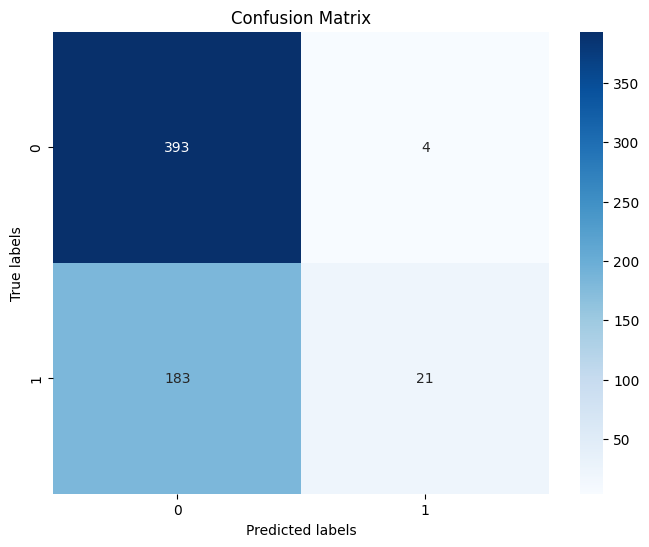

In [13]:
plot_confusion_matrix(y_test, y_pred,(0,1))

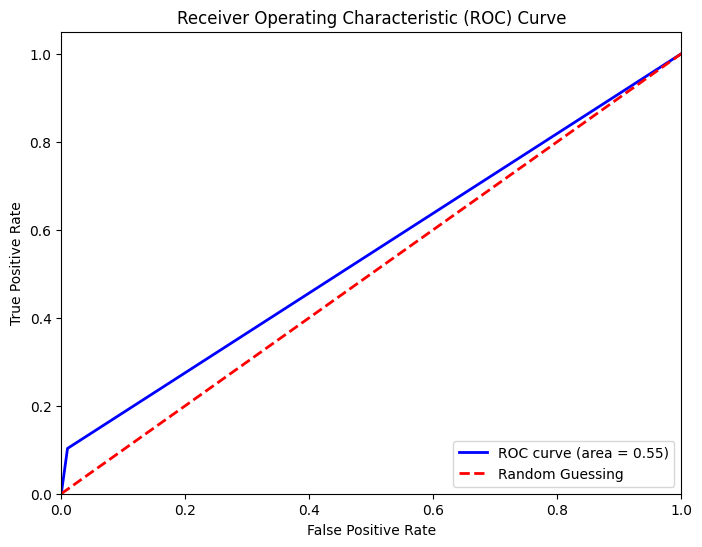

In [14]:
plot_roc_curve(y_test, y_pred)

### Multi-layered Perceptron

#### Normalized data

In [15]:
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

model = MLPClassifier(random_state=42, max_iter=2000)

param_grid = {
    'hidden_layer_sizes': [(50,), (100,), (100, 50)],
    'activation': ['tanh', 'relu'],
    'solver': ['adam', 'sgd'],
    'alpha': [0.0001, 0.001, 0.01],
    'learning_rate': ['constant', 'adaptive']
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)
print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(normal(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")
print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")
print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 6982.51 seconds
Best Hyperparameters:
{'activation': 'relu', 'alpha': 0.001, 'hidden_layer_sizes': (100, 50), 'learning_rate': 'adaptive', 'solver': 'sgd'}

Time taken for training with best hyperparameters: 33.59 seconds

Mean Accuracy: 0.6584768326417704
Standard Deviation of Accuracy: 0.003066947596561596
Mean Precision: 0.1
Standard Deviation of Precision: 0.30000000000000004
Mean Recall: 0.0024390243902439024
Standard Deviation of Recall: 0.007317073170731709
Mean F1-score: 0.0047619047619047615
Standard Deviation of F1-score: 0.014285714285714285
Mean ROC AUC: 0.501219512195122
Standard Deviation of ROC AUC: 0.0036585365853658573

Total time taken: 7016.10 seconds


In [16]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [17]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.6638935108153078
Precision: 1.0
Recall: 0.00980392156862745
F1 Score: 0.01941747572815534
ROC AUC Score: 0.5049019607843137
Confusion Matrix:
[[397   0]
 [202   2]]


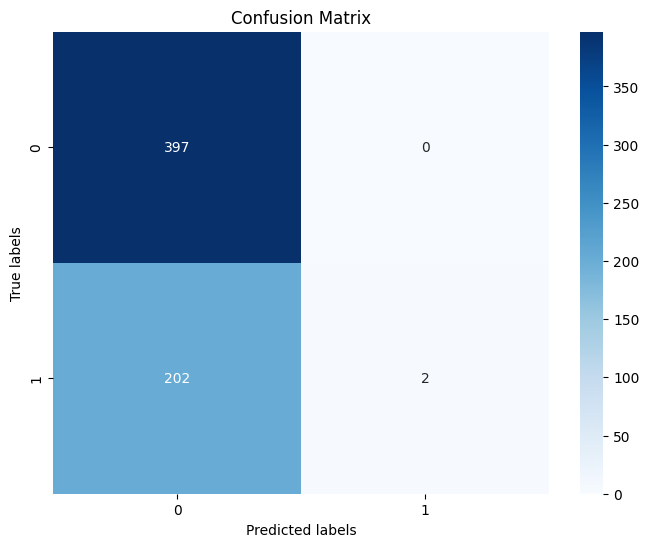

In [18]:
plot_confusion_matrix(y_test, y_pred,(0,1))

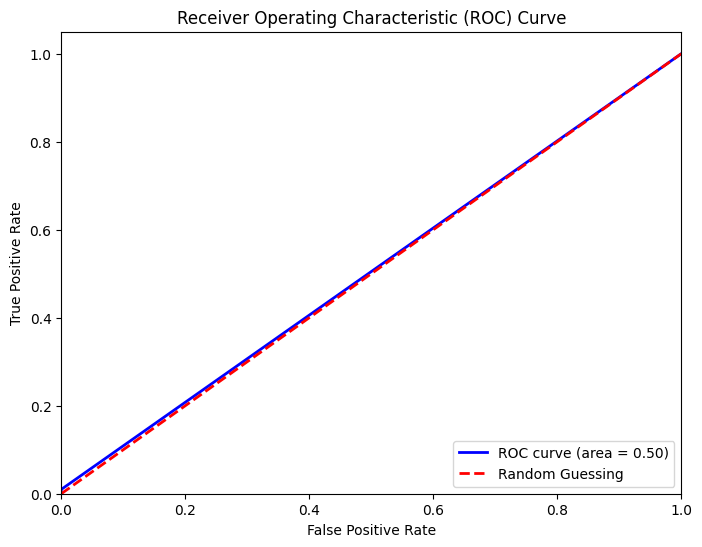

In [19]:
plot_roc_curve(y_test, y_pred)

#### Standardized data

In [20]:
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import numpy as np
import time

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

model = MLPClassifier(random_state=42, max_iter=2000)

param_grid = {
    'hidden_layer_sizes': [(50,), (100,), (100, 50)],
    'activation': ['tanh', 'relu'],
    'solver': ['adam', 'sgd'],
    'alpha': [0.0001, 0.001, 0.01],
    'learning_rate': ['constant', 'adaptive']
}

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=kf, scoring='accuracy')

start_time = time.time()

grid_search.fit(standard(x), y)

grid_search_time = time.time() - start_time
print(f"Time taken for GridSearchCV: {grid_search_time:.2f} seconds")

best_params = grid_search.best_params_

print("Best Hyperparameters:")
print(best_params)
print()

best_model = grid_search.best_estimator_

start_time = time.time()

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

for train_index, test_index in kf.split(standard(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    best_model.fit(X_train, y_train)

    y_pred = best_model.predict(X_test)

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with best hyperparameters: {training_time:.2f} seconds")
print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")
print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

Time taken for GridSearchCV: 10294.75 seconds
Best Hyperparameters:
{'activation': 'relu', 'alpha': 0.001, 'hidden_layer_sizes': (100, 50), 'learning_rate': 'adaptive', 'solver': 'sgd'}

Time taken for training with best hyperparameters: 33.44 seconds

Mean Accuracy: 0.6584768326417704
Standard Deviation of Accuracy: 0.003066947596561596
Mean Precision: 0.1
Standard Deviation of Precision: 0.30000000000000004
Mean Recall: 0.0024390243902439024
Standard Deviation of Recall: 0.007317073170731709
Mean F1-score: 0.0047619047619047615
Standard Deviation of F1-score: 0.014285714285714285
Mean ROC AUC: 0.501219512195122
Standard Deviation of ROC AUC: 0.0036585365853658573

Total time taken: 10328.19 seconds


In [21]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.25,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1800, 13)
y_train: (1800,)
x_test: (601, 13)
y_test: (601,)


In [22]:
model = grid_search.best_estimator_

model.fit(x_train, y_train)

y_pred = model.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.6638935108153078
Precision: 1.0
Recall: 0.00980392156862745
F1 Score: 0.01941747572815534
ROC AUC Score: 0.5049019607843137
Confusion Matrix:
[[397   0]
 [202   2]]


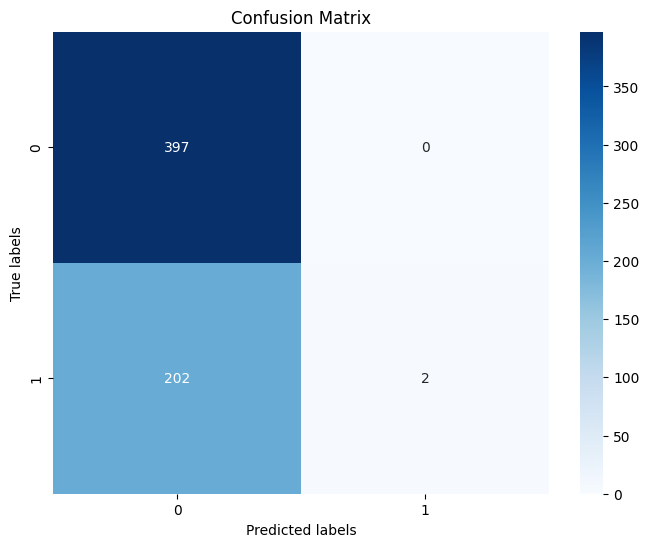

In [23]:
plot_confusion_matrix(y_test, y_pred,(0,1))

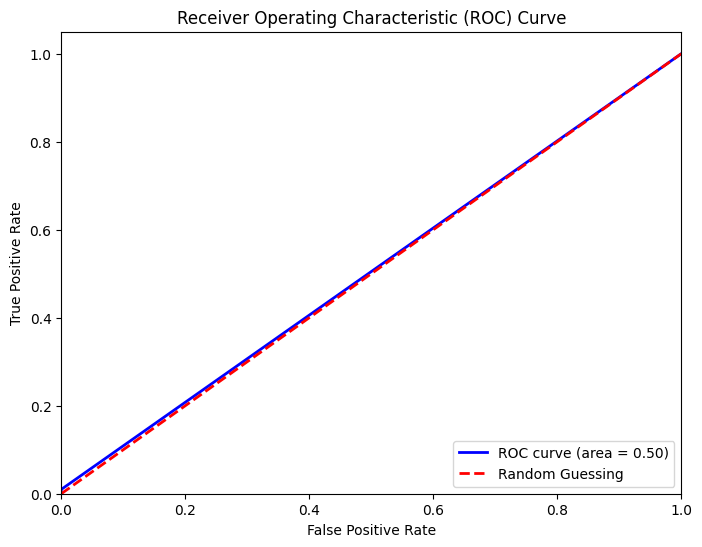

In [24]:
plot_roc_curve(y_test, y_pred)

### Aritificial Neural Networks

#### Normalized data

In [25]:
from tensorflow.keras.layers import Dense, InputLayer
from tensorflow.keras.models import Sequential
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import numpy as np
import time

def build_model():
    model = Sequential()
    model.add(InputLayer(input_shape=(13,)))
    model.add(Dense(10, activation='relu'))
    model.add(Dense(20, activation='relu'))
    model.add(Dense(40, activation='relu'))
    model.add(Dense(80, activation='relu'))
    model.add(Dense(100, activation='relu'))
    model.add(Dense(80, activation='relu'))
    model.add(Dense(40, activation='relu'))
    model.add(Dense(20, activation='relu'))
    model.add(Dense(10, activation='relu'))
    model.add(Dense(1, activation='sigmoid'))
    model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
    return model

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

start_time = time.time()

for train_index, test_index in kf.split(normal(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    model = build_model()
    model.fit(X_train, y_train, epochs=100, batch_size=32, verbose=0)

    y_pred = (model.predict(X_test) > 0.5).astype(int).ravel()

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with the neural network: {training_time:.2f} seconds")
print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")
print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
Time taken for training with the neural network: 240.62 seconds

Mean Accuracy: 0.8125916320885201
Standard Deviation of Accuracy: 0.018187147044301306
Mean Precision: 0.7740722666721951
Standard Deviation of Precision: 0.07639600048705199
Mean Recall: 0.662973846605936
Standard Deviation of Recall: 0.09265153718002667
Mean F1-score: 0.705410204420142
Standard Deviation of F1-score: 0.03544368787170356
Mean ROC AUC: 0.7767118688806508
Standard Deviation of ROC AUC: 0.02711535539028044

Total time taken: 240.62 seconds


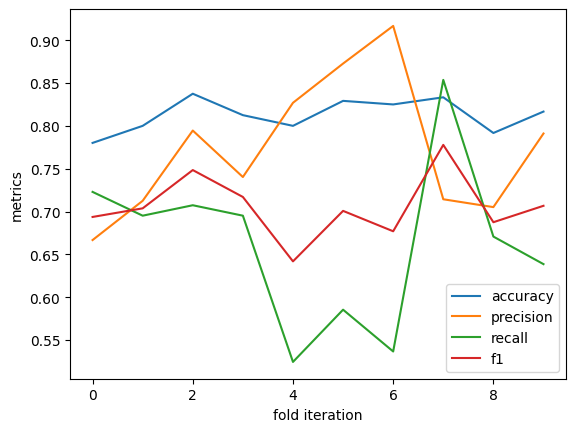

In [26]:
plt.plot(accuracy_scores)
plt.plot(precision_scores)
plt.plot(recall_scores)
plt.plot(f1_scores)
plt.ylabel('metrics')
plt.xlabel('fold iteration')
plt.legend(['accuracy', 'precision','recall', 'f1'], loc='lower right')
plt.show()

In [15]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(normal(x),y,test_size=0.3,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1680, 13)
y_train: (1680,)
x_test: (721, 13)
y_test: (721,)


In [16]:
from keras.callbacks import ModelCheckpoint
from keras.models import load_model

model = Sequential()
model.add(InputLayer(input_shape=(13,)))
model.add(Dense(10, activation='relu'))
model.add(Dense(20, activation='relu'))
model.add(Dense(40, activation='relu'))
model.add(Dense(80, activation='relu'))
model.add(Dense(100, activation='relu'))
model.add(Dense(80, activation='relu'))
model.add(Dense(40, activation='relu'))
model.add(Dense(20, activation='relu'))
model.add(Dense(10, activation='relu'))
model.add(Dense(1, activation='sigmoid'))

model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

model.summary()

model_checkpoint = ModelCheckpoint('normal_model.keras',mode='max',verbose=1,monitor='val_accuracy',save_best_only=True)

history = model.fit(x_train,y_train,batch_size=20,validation_data=(x_test,y_test),epochs=12,callbacks=[model_checkpoint])

model1 = load_model('normal_model.keras')

y_pred = model1.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Model: "sequential_10"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_100 (Dense)               │ (None, 10)             │           140 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_101 (Dense)               │ (None, 20)             │           220 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_102 (Dense)               │ (None, 40)             │           840 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_103 (Dense)               │ (None, 80)             │         3,280 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_104 (Dense)               │ (None, 100)            │         8,100 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_105 (Dense)               │ (None, 80)             │         8,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_106 (Dense)               │ (None, 40)             │         3,240 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_107 (Dense)               │ (None, 20)             │           820 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_108 (Dense)               │ (None, 10)             │           210 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_109 (Dense)               │ (None, 1)              │            11 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 24,941 (97.43 KB)

 Trainable params: 24,941 (97.43 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/12
83/84 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6184 - loss: 0.6704
Epoch 1: val_accuracy improved from -inf to 0.66019, saving model to normal_model.keras
84/84 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - accuracy: 0.6191 - loss: 0.6697 - val_accuracy: 0.6602 - val_loss: 0.5895
Epoch 2/12
73/84 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6977 - loss: 0.5607
Epoch 2: val_accuracy improved from 0.66019 to 0.77670, saving model to normal_model.keras
84/84 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7026 - loss: 0.5552 - val_accuracy: 0.7767 - val_loss: 0.4546
Epoch 3/12
72/84 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7977 - loss: 0.4274
Epoch 3: val_accuracy improved from 0.77670 to 0.82386, saving model to normal_model.keras
84/84 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7986 - loss: 0.4270 - val_accuracy: 0.8239 - val_loss: 0.4001
Epoch 4/12
76/84 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8118 - loss: 0.4161
Epoch 4: val_accuracy improved from 0.82386 to 0.

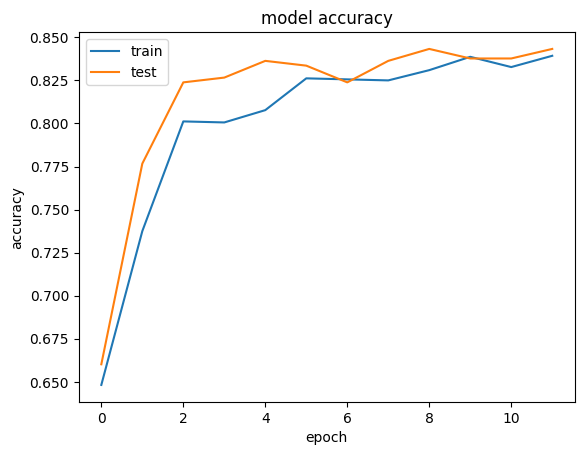

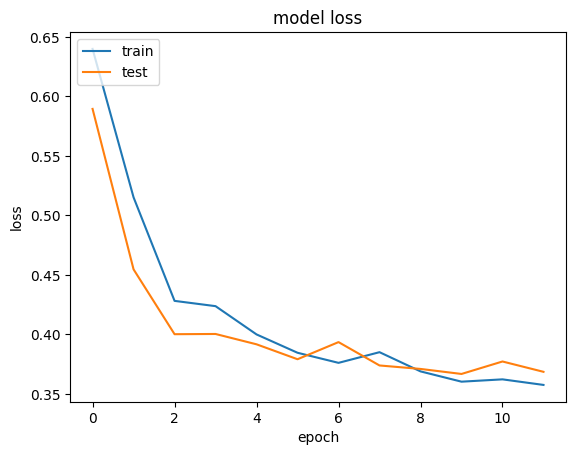

In [17]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

#### Standardized data

In [20]:
from tensorflow.keras.layers import Dense, InputLayer
from tensorflow.keras.models import Sequential
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import numpy as np
import time

def build_model():
    model = Sequential()
    model.add(InputLayer(input_shape=(13,)))
    model.add(Dense(10, activation='relu'))
    model.add(Dense(20, activation='relu'))
    model.add(Dense(40, activation='relu'))
    model.add(Dense(80, activation='relu'))
    model.add(Dense(100, activation='relu'))
    model.add(Dense(80, activation='relu'))
    model.add(Dense(40, activation='relu'))
    model.add(Dense(20, activation='relu'))
    model.add(Dense(10, activation='relu'))
    model.add(Dense(1, activation='sigmoid'))
    model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
    return model

start_total_time = time.time()

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []
confusion_matrices = []

start_time = time.time()

for train_index, test_index in kf.split(standard(x), y):
    X_train, X_test = x.iloc[train_index], x.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    model = build_model()
    model.fit(X_train, y_train, epochs=100, batch_size=32, verbose=0)

    y_pred = (model.predict(X_test) > 0.5).astype(int).ravel()

    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)
    
    precision = precision_score(y_test, y_pred)
    precision_scores.append(precision)
    
    recall = recall_score(y_test, y_pred)
    recall_scores.append(recall)
    
    f1 = f1_score(y_test, y_pred)
    f1_scores.append(f1)
    
    roc_auc = roc_auc_score(y_test, y_pred)
    roc_auc_scores.append(roc_auc)
    
    confusion = confusion_matrix(y_test, y_pred)
    confusion_matrices.append(confusion)

training_time = time.time() - start_time
print(f"Time taken for training with the neural network: {training_time:.2f} seconds")
print()

mean_accuracy = np.mean(accuracy_scores)
std_accuracy = np.std(accuracy_scores)

mean_precision = np.mean(precision_scores)
std_precision = np.std(precision_scores)

mean_recall = np.mean(recall_scores)
std_recall = np.std(recall_scores)

mean_f1 = np.mean(f1_scores)
std_f1 = np.std(f1_scores)

mean_roc_auc = np.mean(roc_auc_scores)
std_roc_auc = np.std(roc_auc_scores)

print(f"Mean Accuracy: {mean_accuracy}")
print(f"Standard Deviation of Accuracy: {std_accuracy}")

print(f"Mean Precision: {mean_precision}")
print(f"Standard Deviation of Precision: {std_precision}")

print(f"Mean Recall: {mean_recall}")
print(f"Standard Deviation of Recall: {std_recall}")

print(f"Mean F1-score: {mean_f1}")
print(f"Standard Deviation of F1-score: {std_f1}")

print(f"Mean ROC AUC: {mean_roc_auc}")
print(f"Standard Deviation of ROC AUC: {std_roc_auc}")
print()

total_time = time.time() - start_total_time
print(f"Total time taken: {total_time:.2f} seconds")

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Time taken for training with the neural network: 244.51 seconds

Mean Accuracy: 0.8050968188105116
Standard Deviation of Accuracy: 0.027681631103985953
Mean Precision: 0.7697294221926265
Standard Deviation of Precision: 0.07957343064229522
Mean Recall: 0.6424037613870116
Standard Deviation of Recall: 0.11746871345143681
Mean F1-score: 0.6885453094621883
Standard Deviation of F1-score: 0.055852798365961576
Mean ROC AUC: 0.766061995181936
Standard Deviation of ROC AUC: 0.04008998439080089

Total time taken: 244.51 seconds


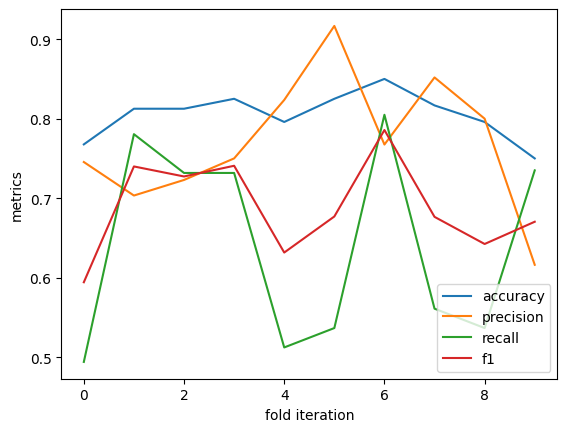

In [21]:
plt.plot(accuracy_scores)
plt.plot(precision_scores)
plt.plot(recall_scores)
plt.plot(f1_scores)
plt.ylabel('metrics')
plt.xlabel('fold iteration')
plt.legend(['accuracy', 'precision','recall', 'f1'], loc='lower right')
plt.show()

In [22]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(standard(x),y,test_size=0.3,random_state=42)

print("x_train:",x_train.shape)
print("y_train:",y_train.shape)
print("x_test:",x_test.shape)
print("y_test:",y_test.shape)

x_train: (1680, 13)
y_train: (1680,)
x_test: (721, 13)
y_test: (721,)


In [23]:
model = Sequential()
model.add(InputLayer(input_shape=(13,)))
model.add(Dense(10, activation='relu'))
model.add(Dense(20, activation='relu'))
model.add(Dense(40, activation='relu'))
model.add(Dense(80, activation='relu'))
model.add(Dense(100, activation='relu'))
model.add(Dense(80, activation='relu'))
model.add(Dense(40, activation='relu'))
model.add(Dense(20, activation='relu'))
model.add(Dense(10, activation='relu'))
model.add(Dense(1, activation='sigmoid'))

model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

model.summary()

model_checkpoint = ModelCheckpoint('standard_model.keras',mode='max',verbose=1,monitor='val_accuracy',save_best_only=True)

history = model.fit(x_train,y_train,batch_size=20,validation_data=(x_test,y_test),epochs=12,callbacks=[model_checkpoint])

model1 = load_model('standard_model.keras')

y_pred = model1.predict(x_test)

y_pred = (y_pred >= 0.5).astype(int)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("ROC AUC Score:", roc_auc_score(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Model: "sequential_31"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_310 (Dense)               │ (None, 10)             │           140 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_311 (Dense)               │ (None, 20)             │           220 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_312 (Dense)               │ (None, 40)             │           840 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_313 (Dense)               │ (None, 80)             │         3,280 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_314 (Dense)               │ (None, 100)            │         8,100 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_315 (Dense)               │ (None, 80)             │         8,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_316 (Dense)               │ (None, 40)             │         3,240 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_317 (Dense)               │ (None, 20)             │           820 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_318 (Dense)               │ (None, 10)             │           210 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_319 (Dense)               │ (None, 1)              │            11 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 24,941 (97.43 KB)

 Trainable params: 24,941 (97.43 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/12
82/84 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6714 - loss: 0.5913
Epoch 1: val_accuracy improved from -inf to 0.76283, saving model to standard_model.keras
84/84 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - accuracy: 0.6731 - loss: 0.5888 - val_accuracy: 0.7628 - val_loss: 0.4440
Epoch 2/12
72/84 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8003 - loss: 0.4266
Epoch 2: val_accuracy improved from 0.76283 to 0.80444, saving model to standard_model.keras
84/84 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8013 - loss: 0.4253 - val_accuracy: 0.8044 - val_loss: 0.4062
Epoch 3/12
70/84 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8396 - loss: 0.3727
Epoch 3: val_accuracy improved from 0.80444 to 0.82108, saving model to standard_model.keras
84/84 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8370 - loss: 0.3747 - val_accuracy: 0.8211 - val_loss: 0.3978
Epoch 4/12
78/84 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7916 - loss: 0.4168
Epoch 4: val_accuracy improved from 0.82108

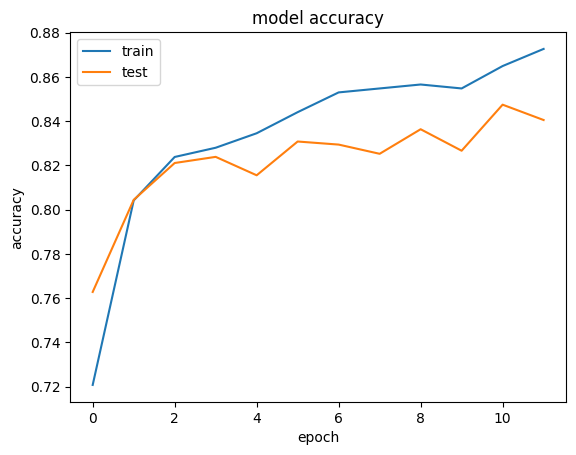

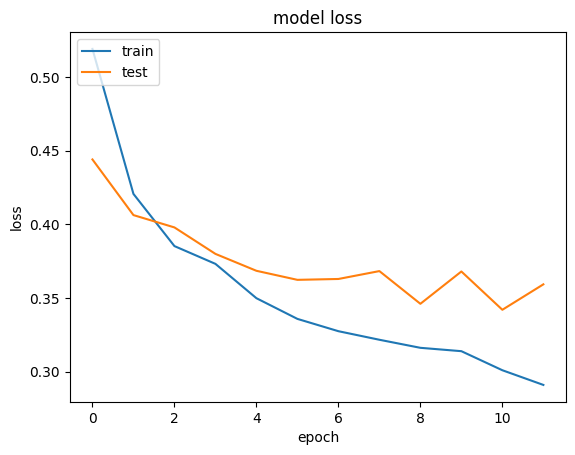

In [24]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()